In [1]:
from __future__ import print_function, division
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy
import torchvision.models as models
import torch
from ptflops import get_model_complexity_info
from mlxtend.plotting import plot_confusion_matrix
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam.utils.image import preprocess_image
from pytorch_grad_cam.utils.image import show_cam_on_image
import cv2

BATCH_SIZE = 32
EPOCHS = 50
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

global CLASSES, class_names
global macs, params
global total_matrix
global sig_img_val, sig_img_test
global val_num, test_num

def createFolder(directory):
    try:
        if not os.path.exists(directory):
            os.makedirs(directory)
    except OSError:
        print ('Error: Creating directory. ' +  directory)

def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    #mean = np.array([0.485, 0.456, 0.406])
    #std = np.array([0.229, 0.16, 0.225])
    #inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

def save_checkpoint(epoch, model, optimizer, filename):
    state={
        'Epoch':epoch,
        'State_dict':model.state_dict(),
        'optimizer':optimizer.state_dict()
    }
    torch.save(state,filename)
    
def train_model(model, criterion, optimizer, num_epochs=20):
    model = model.to(device)
    
    optimizer.zero_grad()
    up_loss=987654161.
    train_acc=[]
    val_acc=[]
    train_loss=[]
    val_loss=[]
    #morph_optimizer = None
    
    for epoch in range(num_epochs):
        logs = {}
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                loss = criterion(outputs, labels)

                if phase == 'train':
                    optimizer.zero_grad()
                    def closure():
                        probs = F.log_softmax(model(inputs), dim=1)
                        loss = F.nll_loss(probs, labels, reduction="sum")
                        return loss                    
                    loss.backward()
                    optimizer.step()#closure
                    
                _, preds = torch.max(outputs, 1)
                running_loss += loss.detach() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_acc = running_corrects.float() / len(dataloaders[phase].dataset)
            prefix = ''
        
            if phase == 'val':
                val_acc.append(epoch_acc.item())
                val_loss.append(epoch_loss.item())
                if epoch_loss <= up_loss:
                    up_loss=epoch_loss
                    save_checkpoint(epoch,model,optimizer, PATH)
            else:
                train_acc.append(epoch_acc.item())
                train_loss.append(epoch_loss.item())
        print(epoch_loss.item())
    
    chk_point= torch.load(PATH)
    model=model.load_state_dict(chk_point,strict=False)
    
    return train_acc, val_acc, train_loss, val_loss
    
def learn_model(model,model_name,f_name,c):
    img = Image.open('images/'+f_name+'/train/normal/001__250.png')
    IMG_SIZE=(img.size[0],img.size[1])
    print('images/'+f_name+'/train')
    
    global CLASSES, class_names
    global val_num, test_num
    
    optimizer=optim.SGD(model.parameters(),lr=LEARN_RATE, momentum=0.9)
    criterion = nn.CrossEntropyLoss()
    
    data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(IMG_SIZE),  
        #transforms.RandomAffine(degrees=(-5,5), translate=(1.0,0)), #default de(-5,5), trans(0.2,0)
        #transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.16, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(IMG_SIZE),        
        #transforms.CenterCrop(16),
        #transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.16, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize(IMG_SIZE),        
        #transforms.CenterCrop(16),
        #transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.16, 0.225])
    ])
    }
    

    image_datasets = {x: datasets.ImageFolder(root='images/'+f_name+"/"+x,
                                          transform = data_transforms[x])
                  
                  for x in ['train', 'val','test']}
    test_datasets = {x: datasets.ImageFolder(root='images/'+f_name+"/"+x,
                                          transform = data_transforms[x])
                  
                  for x in ['test']}
                      
    global dataloaders
    global total_matrix
    
    dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=BATCH_SIZE, #배치사이즈 원본 128/ 현재 16사용
                                             shuffle=True, num_workers=0)
               for x in ['train', 'val','test']}
    dataloadtest={x:torch.utils.data.DataLoader(test_datasets[x], batch_size=BATCH_SIZE, #배치사이즈 원본 128/ 현재 16사용
                                             shuffle=True, num_workers=0)
                 for x in ['test']}

    dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val','test']}
    class_names = image_datasets['train'].classes
        
    
    inputs, classes = next(iter(dataloaders['train']))

    # Make a grid from batch
    out = torchvision.utils.make_grid(inputs)
    imshow(out, title=[class_names[x] for x in classes])
    global macs, params
    global sig_img_val, sig_img_test
    global all_total, all_correct
    
    c=str(c)
    global PATH
    PATH = f_name[:f_name.find('-')]+"_"+f_name[f_name.find('-')+1:]+"/chkpt/"+model_name+"_"+f_name+"_"+c+".pth"
    createFolder(PATH[:PATH.find('/')]+'/chkpt')
    
    
    acc, val_acc, loss, val_loss = train_model(model, criterion, optimizer, num_epochs=EPOCHS)
    print('Finish training!')
    
    
    with torch.no_grad():
        for i, (inputs, classes) in enumerate(dataloadtest['test']):
            inputs = inputs.to(device)
            classes = classes.to(device)
            outputs = model(inputs).to(device)
            _, preds = torch.max(outputs, 1)
            for t, p in zip(classes.view(-1), preds.view(-1)):
                total_matrix[t.long(), p.long()] += 1

    
    
    
    dataiter = iter(dataloadtest['test'])
    images, labels = dataiter.next()
    images = images.to(device)
    labels = labels.to(device)
    
    outputs = model(images).to(device)
    
    correct_pred = {classname: 0 for classname in class_names}
    total_pred = {classname: 0 for classname in class_names}

    # 변화도는 여전히 필요하지 않습니다
    with torch.no_grad():
        for data in dataloadtest['test']:
            images, labels = data
            images=images.to(device)
            labels=labels.to(device)
            outputs = model(images)
            _, predictions = torch.max(outputs, 1)
            # 각 분류별로 올바른 예측 수를 모읍니다
            for label, prediction in zip(labels, predictions):
                if label == prediction:
                    correct_pred[class_names[label]] += 1
                total_pred[class_names[label]] += 1

    # 각 분류별 정확도(accuracy)를 출력합니다
    for classname, correct_count in correct_pred.items():
        accuracy = 100 * float(correct_count) / total_pred[classname]
        print("Accuracy for class {:5s} is: {:.1f} %".format(classname,
                                                       accuracy))
        
    correct = 0
    total = 0
    # 학습 중이 아니므로, 출력에 대한 변화도를 계산할 필요가 없습니다

    with torch.no_grad():
        for data in dataloadtest['test']:
            images, labels = data
            images=images.to(device)
            labels=labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            all_total += labels.size(0)
            correct += (predicted == labels).sum().item()
            all_correct += (predicted == labels).sum().item()

    print('Accuracy of test images: %0.2f%%\n' % (100 * correct / total))
        
    class HistoryGraph:
        def __init__(self, epochs, title, file_path,acc,val_acc,loss,val_loss):
            self.acc=acc
            self.val_acc = val_acc
            self.loss = loss
            self.val_loss = val_loss
            self.epochs = epochs
            self.title = title
            self.file_path = file_path

        def draw(self):
            figure, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
            figure.suptitle(self.title, fontsize=12)
            figure.subplots_adjust(top=0.85, wspace=0.3)

            ax1.plot(acc,
                     label='Train Accuracy')
            ax1.plot(val_acc,
                     label='Validation Accuracy')
            ax1.set_ylabel('Accuracy Value')
            ax1.set_xlabel('Epoch #')
            ax1.set_title('Accuracy')
            ax1.legend(loc="best")
            ax2.plot(self.loss, 
                     label='Train Loss')
            ax2.plot(self.val_loss,
                     label='Validation Loss')
            ax2.set_ylabel('Loss Value')
            ax2.set_xlabel('Epoch #')
            ax2.set_title('Loss')
            ax2.legend(loc="best")
            ft_text = ""
            ft_text+='Accuracy of test images: %0.2f%%\n' % (100 * correct / total)
            for classname, correct_count in correct_pred.items():
                accuracy = 100 * float(correct_count) / total_pred[classname]
                ft_text+="Accuracy for class {:5s} is: {:.1f} %\n".format(classname,
                                                               accuracy)
            ft_text+='{:,}'.format(int(macs))
            plt.annotate(ft_text, (0,0), (-30, -40), xycoords='axes fraction', textcoords='offset points', va='top',annotation_clip=False)
            plt.show()
            figure.savefig(self.file_path, bbox_inches="tight")
            plt.close()
    
    if c=='1':
        title = model_name+"_"+f_name
        graph_file = PATH[:PATH.find('/')]+"/"+model_name+"_"+f_name+".png"
        HistoryGraph(EPOCHS, title, graph_file, acc, val_acc, loss, val_loss).draw()
    
    folds = os.listdir('images/'+f_name+"/test")
    cnt = 0 
    for fold in folds:
        img_dir = 'images/'+f_name+"/test/"+fold
        if 'Shuffle' in model_name:
            target_layers = [model.conv5[0]]
        else:
            target_layers = [model.features[-1]]
        cam = GradCAMPlusPlus(model=model,
                               target_layers=target_layers,
                               use_cuda=torch.cuda.is_available())

        imgs = os.listdir(img_dir)
        for img_link in imgs:
            rgb_img = cv2.imread(img_dir+"/"+img_link, 1)[:, :, ::-1]
            rgb_img = cv2.resize(rgb_img, IMG_SIZE)
            rgb_img = np.float32(rgb_img) / 255.
            input_tensor = preprocess_image(rgb_img)
            
            target_category = cnt
            grayscale_cam = cam(input_tensor=input_tensor, target_category=target_category)
            grayscale_cam = grayscale_cam[0, :]
            
            heatmap = cv2.applyColorMap(np.uint8(255 * grayscale_cam), cv2.COLORMAP_JET)
            heatmap = np.float32(heatmap) / 255

            heatmap = heatmap / np.max(heatmap)
            
            sig_img_test[fold]+=heatmap
        if 'normal' in fold:
            test_num+=len(imgs)
        cnt+=1
        
    folds = os.listdir('images/'+f_name+"/train")
    cnt = 0 
    for fold in folds:
        img_dir = 'images/'+f_name+"/train/"+fold
        if 'Shuffle' in model_name:
            target_layers = [model.conv5[0]]
        else:
            target_layers = [model.features[-1]]
        cam = GradCAMPlusPlus(model=model,
                               target_layers=target_layers,
                               use_cuda=torch.cuda.is_available())

        imgs = os.listdir(img_dir)
        for img_link in imgs:
            rgb_img = cv2.imread(img_dir+"/"+img_link, 1)[:, :, ::-1]
            rgb_img = cv2.resize(rgb_img, IMG_SIZE)
            rgb_img = np.float32(rgb_img) / 255.
            input_tensor = preprocess_image(rgb_img)
            
            target_category = cnt
            grayscale_cam = cam(input_tensor=input_tensor, target_category=target_category)
            grayscale_cam = grayscale_cam[0, :]
            
            heatmap = cv2.applyColorMap(np.uint8(255 * grayscale_cam), cv2.COLORMAP_JET)
            heatmap = np.float32(heatmap) / 255

            heatmap = heatmap / np.max(heatmap)
            
            sig_img_val[fold]+=heatmap
            
            
        if 'normal' in fold:
            val_num+=len(imgs)
        cnt+=1

def multiple_learn(model_name,f_name):
    global total_matrix
    global all_correct, all_total
    global sig_img_val,sig_img_test , class_names
    global val_num, test_num
    
    total_matrix = total_matrix.numpy()
    total_matrix = total_matrix.astype('int')
    fig, ax = plot_confusion_matrix(conf_mat=total_matrix,
                                    colorbar=True,
                                    show_absolute=False,
                                    show_normed=True,
                                    class_names=class_names,
                                    figsize = (8,8)) #원본 값 : conf_mat=maxtrix_1
    fig.suptitle('Accuracy of test images: %0.2f%%\n' % (100 * all_correct / all_total), fontsize=12)
    
    plt.show()
    fig.savefig(PATH[:PATH.find('/')]+"/"+model_name+"_"+f_name+"_average.png", bbox_inches="tight")
    plt.close()
    
    for fold in class_names:
        sig_img_val[fold]=sig_img_val[fold]/val_num
        sig_img_test[fold]=sig_img_test[fold]/test_num
        
        
        
        cv2.imwrite(PATH[:PATH.find('/')]+"/val_"+model_name+"_"+f_name+"_"+fold+'.png', np.uint8(255 * sig_img_val[fold]))

        
        cv2.imwrite(PATH[:PATH.find('/')]+"/test_"+model_name+"_"+f_name+"_"+fold+'.png', np.uint8(255 * sig_img_test[fold]))
    

bottom_left-16_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.001 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 3.151% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 2.836% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.210% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.0 GMac, 9.685% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 3.356% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.500% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.059% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding

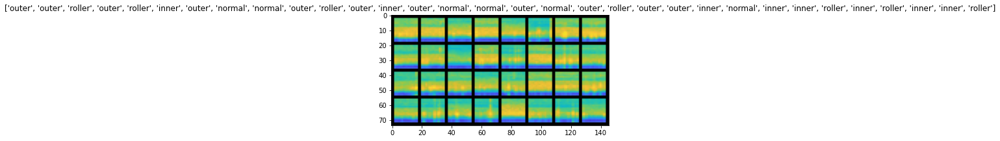

0.9596434831619263
0.5120935440063477
0.35807520151138306
0.24747151136398315
0.20955239236354828
0.203151673078537
0.07050585001707077
0.12480198591947556
0.09809550642967224
0.10659562796354294
0.1435883492231369
0.272902250289917
0.29830265045166016
0.09499259293079376
0.1406402438879013
0.07851435989141464
0.08029881119728088
0.06256674230098724
0.025444917380809784
0.137868732213974
0.12359656393527985
0.040255654603242874
0.09012745320796967
0.0703493058681488
0.06411249935626984
0.029791435226798058
0.12631194293498993
0.15016305446624756
0.048492223024368286
0.05824747681617737
0.14297032356262207
0.2027629017829895
0.028656087815761566
0.13781332969665527
0.06748189777135849
0.08037298917770386
0.06778053194284439
0.08583386987447739
0.059432774782180786
0.06824852526187897
0.07182231545448303
0.062447622418403625
0.08993726968765259
0.055542897433042526
0.07338497042655945
0.10673421621322632
0.03823358565568924
0.08589553087949753
0.14263609051704407
0.03504219651222229
Fini

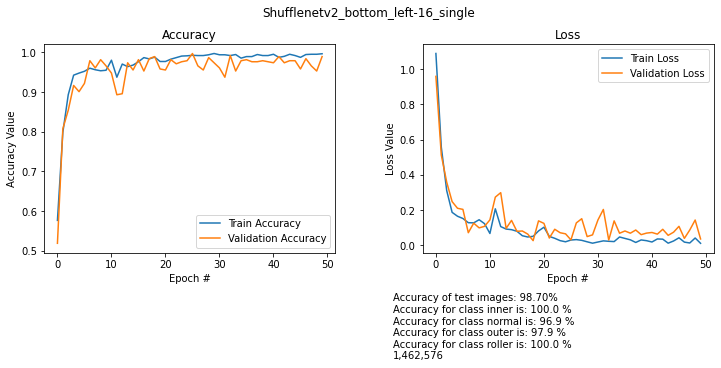

images/bottom_left-16_single/train


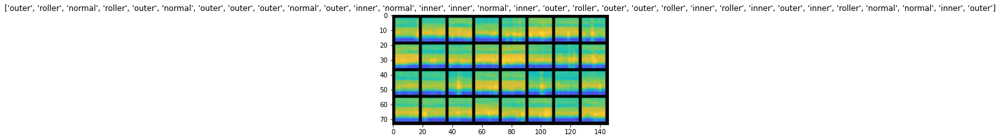

0.9379965662956238
0.5984287261962891
0.5636855363845825
0.3242424726486206
0.7160695791244507
0.2473549246788025
0.18941771984100342
0.19596919417381287
0.13876838982105255
0.12155348062515259
0.2284119725227356
0.1132517009973526
0.25003817677497864
0.06319843232631683
0.12290158867835999
0.16679662466049194
0.07110481709241867
0.07022178173065186
0.06432737410068512
0.09156501293182373
0.07340610027313232
0.11492452025413513
0.2424592226743698
0.07020150870084763
0.05824899300932884
0.05972845479846001
0.0456368625164032
0.11110521852970123
0.03356599062681198
0.14516252279281616
0.09736716747283936
0.028887448832392693
0.03830127418041229
0.025848841294646263
0.10171835124492645
0.054661743342876434
0.03578890115022659
0.03292621672153473
0.030482620000839233
0.051026999950408936
0.12291762232780457
0.26914384961128235
0.07062646746635437
0.04475881904363632
0.05283641815185547
0.040860362350940704
0.018446441739797592
0.04965599626302719
0.01912332884967327
0.12022191286087036
Fin

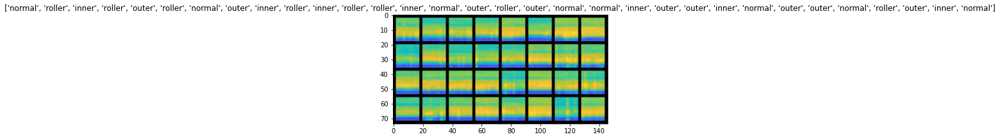

1.1062469482421875
0.48861998319625854
0.2668423652648926
0.17147284746170044
0.3859754204750061
0.19671770930290222
1.0422502756118774
0.1229713186621666
0.12131637334823608
0.04868600517511368
0.09227310121059418
0.2843617796897888
0.1878107637166977
0.06897225230932236
0.14529871940612793
0.047366123646497726
0.05364210531115532
0.05832524597644806
0.0848214328289032
0.16893568634986877
0.20351362228393555
0.049605175852775574
0.0930197685956955
0.03150263428688049
0.06979058682918549
0.09848257899284363
0.13874638080596924
0.052282944321632385
0.09126129746437073
0.022373592481017113
0.051251135766506195
0.06456538289785385
0.058633655309677124
0.11821262538433075
0.08874373137950897
0.07167486846446991
0.04787848889827728
0.09620147198438644
0.19143250584602356
0.03682465851306915
0.04086757451295853
0.1212526187300682
0.011545851826667786
0.037601739168167114
0.04388972371816635
0.06706030666828156
0.03684542700648308
0.026493489742279053
0.022699296474456787
0.03737754374742508


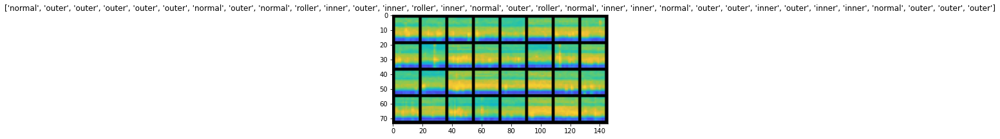

1.1166372299194336
1.1395375728607178
0.507093071937561
0.22088885307312012
0.15156307816505432
0.1513938307762146
0.3440846800804138
0.15019504725933075
0.13266615569591522
0.09600763767957687
0.0943128764629364
0.09185301512479782
0.1626909226179123
0.09995196759700775
0.04849443584680557
0.11729525029659271
0.08477430790662766
0.07029201090335846
0.06869283318519592
0.08620395511388779
0.053391799330711365
0.04955938458442688
0.08793264627456665
0.059899475425481796
0.05039334297180176
0.04920686036348343
0.05933855101466179
0.06325718760490417
0.042354729026556015
0.1381368488073349
0.049359031021595
0.058746811002492905
0.04288483411073685
0.025294490158557892
0.09033908694982529
0.05829814821481705
0.03606591373682022
0.04956220090389252
0.04656592756509781
0.19921337068080902
0.09587948769330978
0.08947241306304932
0.022244153544306755
0.03879950940608978
0.030306432396173477
0.041226841509342194
0.039559196680784225
0.0453166663646698
0.03692822530865669
0.07051361352205276
Fin

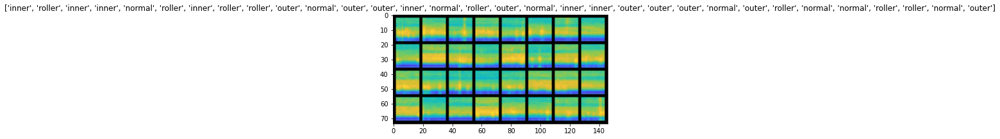

0.7692685127258301
0.3519159257411957
0.6410815715789795
0.20921316742897034
0.15678761899471283
0.08653026819229126
0.15570615231990814
0.08707490563392639
0.08303549140691757
0.171304389834404
0.06864122301340103
0.16874152421951294
0.25492599606513977
0.09545323252677917
0.02195482701063156
0.03554307296872139
0.11158084124326706
0.08405720442533493
0.10924290865659714
0.05567215383052826
0.04222531616687775
0.07211466133594513
0.04448365792632103
0.07662501186132431
0.07761329412460327
0.03965660184621811
0.03880571201443672
0.03426342457532883
0.04408439248800278
0.015777798369526863
0.06426297128200531
0.018353860825300217
0.02716771513223648
0.02816227450966835
0.06763967871665955
0.11757700145244598
0.04096654802560806
0.017216287553310394
0.020465999841690063
0.03811873495578766
0.16863130033016205
0.02451055869460106
0.04807191714644432
0.03898666054010391
0.02502584271132946
0.03096514567732811
0.04748179763555527
0.04916556179523468
0.7239035367965698
0.03117634356021881
Fi

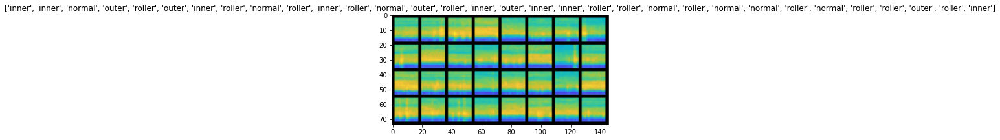

0.8063926696777344
0.33460232615470886
0.7102105617523193
0.21232102811336517
0.09806614369153976
0.13234087824821472
0.07440456748008728
0.2639372944831848
0.12224620580673218
0.1593068540096283
0.11489269137382507
0.11915571987628937
0.12056420743465424
0.16792558133602142
0.09948375821113586
0.11172079294919968
0.10350678861141205
0.07510266453027725
0.04884020611643791
0.07452590018510818
0.27118080854415894
0.10150368511676788
0.1277877539396286
0.10811459273099899
0.07476943731307983
0.12205024808645248
0.06958560645580292
0.4239707589149475
0.07618913054466248
0.052959930151700974
0.044967204332351685
0.05227608233690262
0.09795515984296799
0.0614323727786541
0.25807327032089233
0.05915157496929169
0.16554318368434906
0.07010213285684586
0.11992170661687851
0.019096147269010544
0.03919440507888794
0.052666373550891876
0.030376290902495384
0.03663934767246246
0.05900495871901512
0.0758635550737381
0.03595751151442528
0.044987406581640244
0.019334018230438232
0.019551903009414673


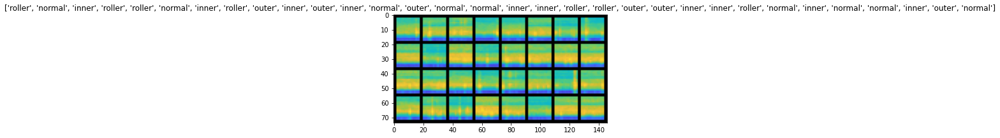

1.3099040985107422
0.5259021520614624
0.3698318898677826
0.27139443159103394
0.18511468172073364
0.25251126289367676
0.13136106729507446
0.08951379358768463
0.3549674451351166
0.10141482204198837
0.37989866733551025
0.08820807933807373
0.1440286934375763
0.0887032300233841
0.12372058629989624
0.08031325787305832
0.10736703127622604
0.05180928856134415
0.03975261375308037
0.323445200920105
0.09366165846586227
0.11703844368457794
0.08910095691680908
0.10177087038755417
0.16766302287578583
0.12512756884098053
0.10909181833267212
0.11755874007940292
0.043957408517599106
0.050594694912433624
0.0321783646941185
0.04376603290438652
0.10992302000522614
0.26702773571014404
0.08455601334571838
0.025214610621333122
0.23030507564544678
0.07173924893140793
0.14893990755081177
0.10067228972911835
0.031409408897161484
0.06425433605909348
0.05239150673151016
0.05205463990569115
0.043664611876010895
0.06162517890334129
0.030800877138972282
0.03559226542711258
0.04391121491789818
0.04940691217780113
Fin

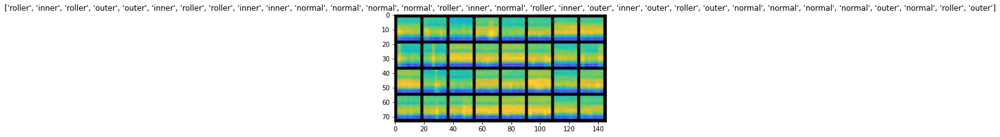

1.017071008682251
0.505536675453186
0.23127995431423187
0.24881808459758759
0.13450764119625092
0.2671893537044525
0.13429899513721466
0.14123763144016266
0.5031945109367371
0.4039483964443207
0.12003102153539658
0.2946358919143677
0.14573130011558533
0.43586838245391846
0.10145662724971771
0.07147780805826187
0.0936121791601181
0.20502017438411713
0.09245617687702179
0.07716460525989532
0.128629669547081
0.18285714089870453
0.2122335284948349
0.19323012232780457
0.1208275556564331
0.07180798053741455
0.11856937408447266
0.08231021463871002
0.3673059642314911
0.13239717483520508
0.13090066611766815
0.10351443290710449
0.07606241106987
0.12910310924053192
0.08232498168945312
0.07090628892183304
0.0569487139582634
0.09165819734334946
0.3602883517742157
0.04530094563961029
0.081060990691185
0.08265766501426697
0.10974599421024323
0.1530829221010208
0.05041227489709854
0.06533113867044449
0.10684557259082794
0.07732763141393661
0.10854306071996689
0.07101736962795258
Finish training!
Accur

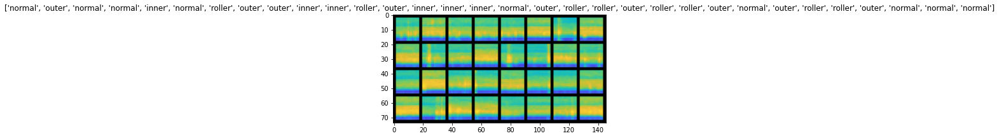

0.9374443292617798
0.5305220484733582
0.867449939250946
0.31406480073928833
0.36119887232780457
0.32293689250946045
0.13963228464126587
0.13369649648666382
0.14614413678646088
0.1633966863155365
0.12766025960445404
0.13357624411582947
0.053002309054136276
0.09246336668729782
0.06590957194566727
0.07415721565485
0.2755844295024872
0.10795705020427704
0.09819256514310837
0.05488578602671623
0.19644784927368164
0.05180617794394493
0.11640863120555878
0.2820296287536621
0.11150884628295898
0.05884350463747978
0.03821748495101929
0.1037735864520073
0.049958012998104095
0.07473599910736084
0.06805099546909332
0.13756951689720154
0.04646735638380051
0.08195855468511581
0.39438480138778687
0.1052103266119957
0.04872361943125725
0.04535103961825371
0.028885966166853905
0.1233905553817749
0.12521538138389587
0.050343699753284454
0.043164461851119995
0.12381863594055176
0.052798476070165634
0.05932076275348663
0.08915027230978012
0.04327896237373352
0.044879257678985596
0.026920517906546593
Finis

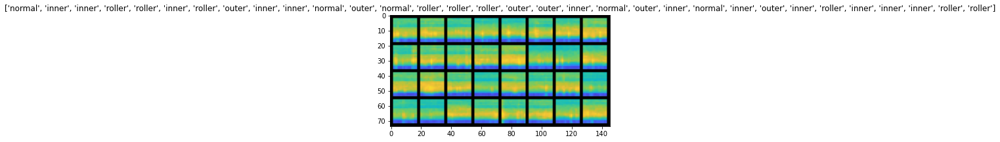

0.9237045049667358
0.5778955817222595
0.36131641268730164
0.5866759419441223
0.2526792883872986
0.19836507737636566
0.2641226053237915
0.24695196747779846
0.262509286403656
0.12511000037193298
0.5295383930206299
0.06283535808324814
0.15996231138706207
0.19969885051250458
0.1795867681503296
0.055891674011945724
0.05554376170039177
0.0690852627158165
0.161847323179245
0.11140518635511398
0.18447324633598328
0.06931938230991364
0.0765112042427063
0.15184976160526276
0.05211888253688812
0.06626567244529724
0.06645942479372025
0.03665582463145256
0.08078029006719589
0.05824071913957596
0.10402169078588486
0.02874591574072838
0.047966450452804565
0.05148652195930481
0.02556592971086502
0.06115015968680382
0.09138118475675583
0.034155167639255524
0.03403518348932266
0.08805778622627258
0.04264269024133682
0.062027134001255035
0.062441326677799225
0.05611427128314972
0.04046483710408211
0.07755789160728455
0.06077120453119278
0.11035920679569244
0.12194132059812546
0.04922736436128616
Finish t

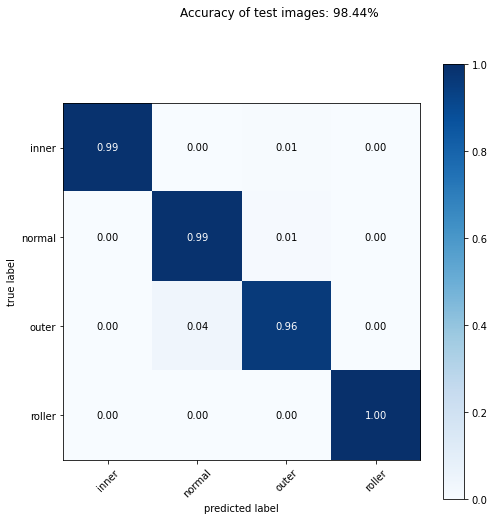

bottom_left-32_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.003 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 6.030% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 5.427% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.001 GMac, 18.537% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 6.423% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.958% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padd

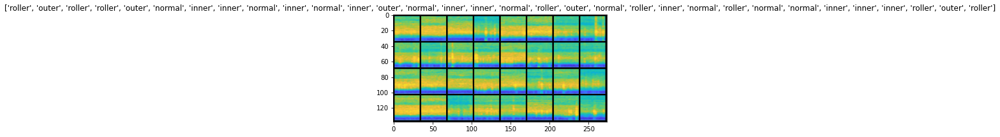

0.6992794871330261
0.19884857535362244
0.5068638324737549
0.14298996329307556
0.01680074632167816
0.041171494871377945
0.09039916098117828
0.09947268664836884
0.01863318309187889
0.14489896595478058
0.15215782821178436
0.013331238180398941
0.03757735341787338
0.041308119893074036
0.020517703145742416
0.010644471272826195
0.011601544916629791
0.011876994743943214
0.005441127344965935
0.11172257363796234
0.1605774313211441
0.010780300945043564
0.005458264611661434
0.01202047523111105
0.011702383868396282
0.0038471249863505363
0.006528091616928577
0.026794370263814926
0.014720304869115353
0.02590249851346016
0.01970064826309681
0.09986286610364914
0.008092924952507019
0.005381028633564711
0.011504650115966797
0.012004075571894646
0.008564972318708897
0.007048597559332848
0.006128021515905857
0.008994605392217636
0.005706598982214928
0.0030926987528800964
0.020357782021164894
0.0043145292438566685
0.03699081391096115
0.008662665262818336
0.008266955614089966
0.006417971104383469
0.03617700

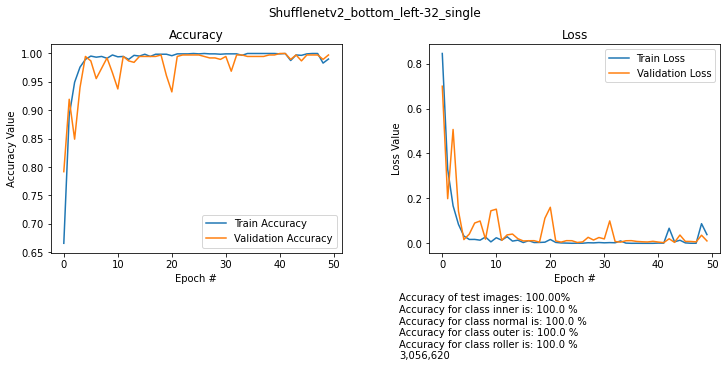

images/bottom_left-32_single/train


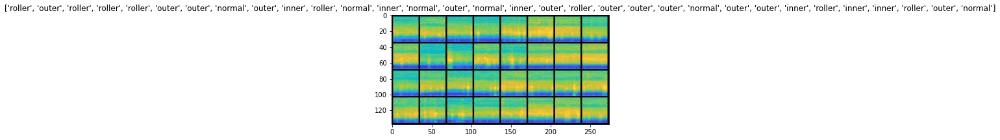

0.7128087282180786
0.3505347967147827
0.2670329809188843
0.23377731442451477
0.038607459515333176
0.009548313915729523
0.049004457890987396
0.0690665990114212
0.06542964279651642
0.009181042201817036
0.011526125483214855
0.09046036005020142
0.04912121221423149
0.006282031536102295
0.007863516919314861
0.004132398404181004
0.06314064562320709
0.01401468925178051
0.0032267614733427763
0.002321844454854727
0.037706855684518814
0.004813432227820158
0.0014825344551354647
0.01016069296747446
0.004369701724499464
0.002617271151393652
0.004860719665884972
0.001758809550665319
0.0010936763137578964
0.002232337137684226
0.001849992899224162
0.0017207043711096048
0.0014951134799048305
0.0015902649611234665
0.0015863736625760794
0.0005803052335977554
0.0007878702017478645
0.0007528890855610371
0.0009167009848169982
0.0006753826746717095
0.0012536296853795648
0.0007760321605019271
0.0003555568982847035
0.0003019252617377788
0.000430194049840793
0.0007332692621275783
0.0006096867145970464
0.00097913

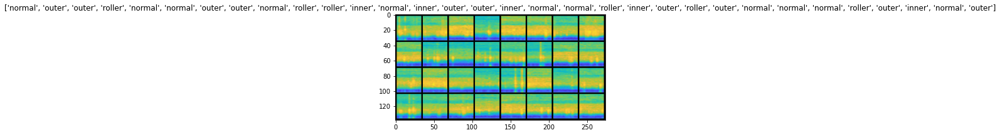

0.3792482018470764
0.8116812705993652
0.08187688887119293
0.15643221139907837
0.05847286805510521
0.03986950218677521
0.05802197754383087
0.09326808154582977
0.06204378232359886
0.06458375602960587
0.012250221334397793
0.016750182956457138
0.011638144962489605
0.024137219414114952
0.01604931801557541
0.024403952062129974
0.10512946546077728
0.02174128219485283
0.024697311222553253
0.018483253195881844
0.02480519935488701
0.013503550551831722
0.010763043537735939
0.007645181845873594
0.005739719606935978
0.003991498611867428
0.0018580581527203321
0.0020329300314188004
0.0025885505601763725
0.004234645050019026
0.02611677348613739
0.008410468697547913
0.023534666746854782
0.049583595246076584
0.0005498622194863856
0.0027227604296058416
0.0009062803583219647
0.024268602952361107
0.007658862974494696
0.009121102280914783
0.002378707053139806
0.03443647921085358
0.01211704220622778
0.022722408175468445
0.014239109121263027
0.027453145012259483
0.005902179982513189
0.005916881840676069
0.002

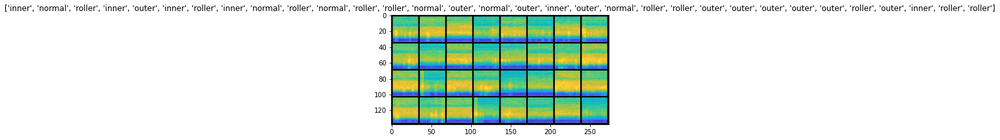

1.1517574787139893
0.5546126961708069
0.2548430562019348
0.0682552307844162
0.09990086406469345
0.11733325570821762
0.051859673112630844
0.013685825280845165
0.030489666387438774
0.03409956395626068
0.06202472373843193
0.011813248507678509
0.02174542471766472
0.0024725880939513445
0.023353336378932
0.0013232913333922625
0.23582372069358826
0.028954893350601196
0.01792880892753601
0.00591170322149992
0.051080092787742615
0.00989655964076519
0.008128311485052109
0.013587050139904022
0.04300205409526825
0.0030241000931710005
0.014881959185004234
0.005527646280825138
0.07684492319822311
0.01403779350221157
0.009946615435183048
0.0010350763332098722
0.002181657124310732
0.005298653617501259
0.041385799646377563
0.010670352727174759
0.0026694652624428272
0.0032505071721971035
0.0009501349995844066
0.0006109155947342515
0.00300611462444067
0.0022728804033249617
0.0037716454826295376
0.00694133248180151
0.0065242997370660305
0.004801575560122728
0.002029465977102518
0.0016285895835608244
0.001

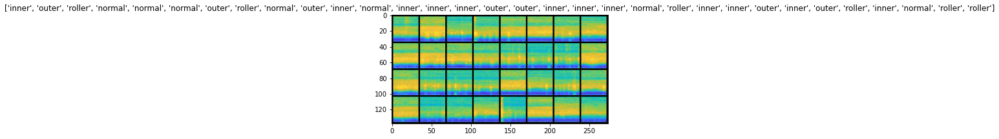

0.7854673266410828
0.34771811962127686
0.6368997097015381
0.05997026711702347
0.17661741375923157
0.01119610108435154
0.06276043504476547
0.02916075848042965
0.04521241411566734
0.10549972951412201
0.01817232184112072
0.018115267157554626
0.014473799616098404
0.00853264331817627
0.0054276082664728165
0.014686870388686657
0.2806091904640198
0.014278972521424294
0.0033881389535963535
0.014740309678018093
0.03276796266436577
0.009472733363509178
0.006412563845515251
0.004734513349831104
0.0019377318676561117
0.0024078544229269028
0.0066075073555111885
0.00700132641941309
0.005662642419338226
0.0011686792131513357
0.0024149322416633368
0.002176079200580716
0.019100073724985123
0.023916173726320267
0.003184044733643532
0.05938132852315903
0.015471696853637695
0.002598569029942155
0.0024829180911183357
0.0022421525791287422
0.0018221655627712607
0.002031924668699503
0.0019187142606824636
0.0023162388242781162
0.0021978970617055893
0.001412673620507121
0.022421669214963913
0.02575087174773216

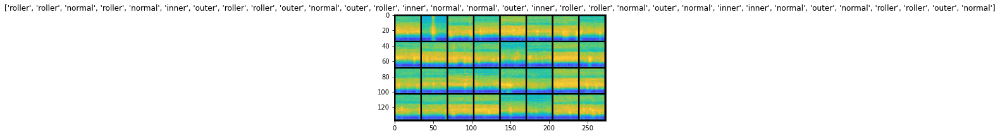

3.0164847373962402
0.41242533922195435
0.4088785648345947
0.31878018379211426
0.04146831855177879
0.17896758019924164
0.0332343615591526
0.018922477960586548
0.032349538058042526
0.014710917137563229
0.01834053359925747
0.05009683966636658
0.37239259481430054
0.0414443202316761
0.045863062143325806
0.02659246139228344
0.018750080838799477
0.015229912474751472
0.02791440114378929
0.02209407649934292
0.04339231178164482
0.03057396411895752
0.026209687814116478
0.012368818745017052
0.08415752649307251
0.1692126840353012
0.024746093899011612
0.010220390744507313
0.015382010489702225
0.010809375904500484
0.0111720971763134
0.01549566350877285
0.018286382779479027
0.04217419773340225
0.023418806493282318
0.005369014106690884
0.020289139822125435
0.003409964730963111
0.002608650363981724
0.0028688935562968254
0.04665662348270416
0.0011854603653773665
0.001199129968881607
0.007560528814792633
0.002315964549779892
0.0012713641626760364
0.006039491854608059
0.0013662492856383324
0.00211021909490

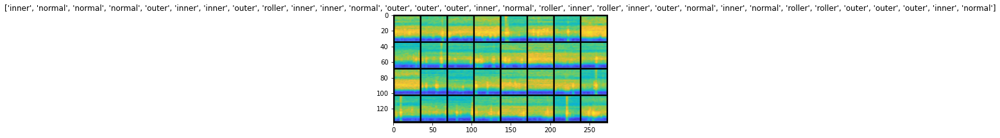

1.24794340133667
0.3738739490509033
0.2006567418575287
0.2103840410709381
0.08368188142776489
0.18447697162628174
0.13097511231899261
0.06294567883014679
0.2019098997116089
0.0430220328271389
0.0879567489027977
0.014615200459957123
0.07004982233047485
0.01443733274936676
0.015602050349116325
0.023442162200808525
0.051527805626392365
0.015486609190702438
0.04338086396455765
0.06063949689269066
0.03440617024898529
0.01618589088320732
0.052654512226581573
0.03535809367895126
0.026091335341334343
0.15925359725952148
0.05215933546423912
0.025559624657034874
0.01021680049598217
0.009709789417684078
0.04921935498714447
0.01716800220310688
0.01706838607788086
0.01797359064221382
0.013036816380918026
0.020752202719449997
0.018123062327504158
0.011220855638384819
0.013446390628814697
0.01632455550134182
0.02044108510017395
0.01340310089290142
0.00920356996357441
0.007540971040725708
0.010632237419486046
0.013765363954007626
0.01198103092610836
0.011323275044560432
0.01184967439621687
0.009890357

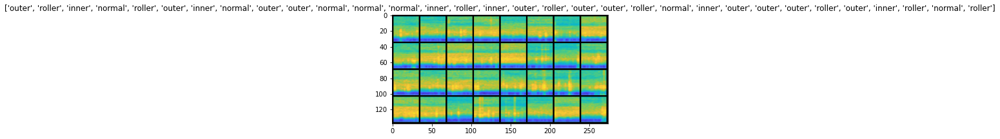

0.49551546573638916
0.6699711084365845
0.29026705026626587
0.11711861193180084
0.04937618598341942
0.013128126040101051
0.03587372601032257
0.011825157329440117
0.004805757198482752
0.04077673330903053
0.007280884310603142
0.04714347422122955
0.21156732738018036
0.018442140892148018
0.04048547521233559
0.002846064046025276
0.01273186132311821
0.0250548105686903
0.012406490743160248
0.01510155014693737
0.014890335500240326
0.016158130019903183
0.017649386078119278
0.0049720387905836105
0.00882495567202568
0.015149409882724285
0.0036589461378753185
0.006896830629557371
0.007974469102919102
0.001472315052524209
0.0009489916265010834
0.0052735405042767525
0.0006681326776742935
0.00045762292575091124
0.0015703788958489895
0.0007643201388418674
0.0006264752591960132
0.00035435493919067085
0.0011044068960472941
0.001352682476863265
0.0017704515485092998
0.001371485646814108
0.0009952147956937551
0.0004021665663458407
0.0005962292780168355
0.0022737772669643164
0.005442780442535877
0.006257631

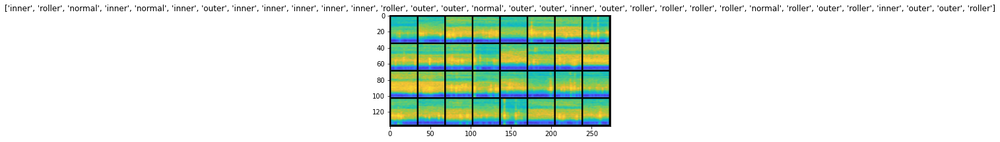

1.75771164894104
0.6027477979660034
0.3451697826385498
0.23015326261520386
0.07392504066228867
0.018436722457408905
0.018046509474515915
0.017652077600359917
0.019888512790203094
0.011332802474498749
0.04868663102388382
0.04930064082145691
0.02437068149447441
0.018750356510281563
0.016408704221248627
0.032616883516311646
0.01944621466100216
0.011371344327926636
0.010795249603688717
0.009846108965575695
0.00972258672118187
0.009870070964097977
0.010855009779334068
0.09584759920835495
0.016999654471874237
0.013712223619222641
0.010208040475845337
0.012048790231347084
0.009357213973999023
0.009958278387784958
0.008120178245007992
0.00887842383235693
0.009328535757958889
0.007944880053400993
0.007013787981122732
0.0078183114528656
0.007968535646796227
0.010166002437472343
0.007790770381689072
0.007759653031826019
0.007287559565156698
0.008338136598467827
0.009790094569325447
0.009095339104533195
0.008029591292142868
0.008896813727915287
0.008744834922254086
0.007704857736825943
0.007657311

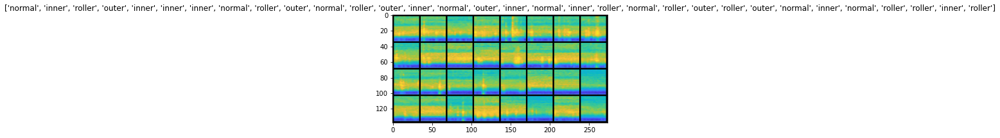

1.047576904296875
0.3693247437477112
0.14720061421394348
0.20623564720153809
0.14542683959007263
0.06764555722475052
0.05907884240150452
0.07559062540531158
0.05379115045070648
0.011140371672809124
0.007657915353775024
0.0035655009560287
0.04031316936016083
0.019910737872123718
0.03448667377233505
0.012997280806303024
0.022848039865493774
0.13515181839466095
0.011316615156829357
0.024083774536848068
0.00652567483484745
0.0854894369840622
0.03837238624691963
0.08155395090579987
0.0007719036075286567
0.008017698302865028
0.0024935847613960505
0.0013200942194089293
0.0010012902785092592
0.00092830799985677
0.0006998686585575342
0.0005163827445358038
0.0005279473261907697
0.002919179853051901
0.02956927940249443
0.007197977043688297
0.0033729360438883305
0.013443747535347939
0.001720865722745657
0.0018537512514740229
0.0012162034399807453
0.0027313116006553173
0.0014699529856443405
0.0009677472407929599
0.0006664012325927615
0.003290367778390646
0.019705932587385178
0.07511556148529053
0.0

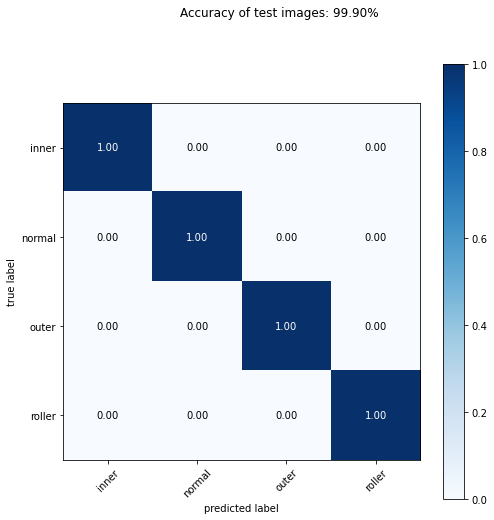

bottom_left-64_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.012 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.001 GMac, 6.036% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.001 GMac, 5.433% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.002 GMac, 18.555% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.001 GMac, 6.429% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.959% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2)

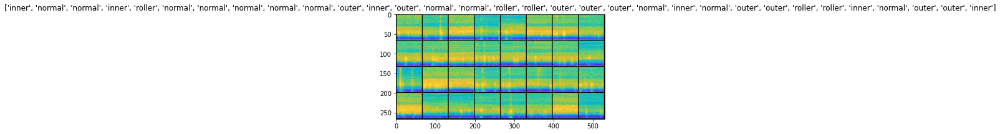

1.2547646760940552
0.02772516757249832
0.023792970925569534
0.02190803363919258
0.03605475276708603
0.004521169234067202
0.017200853675603867
0.0011920747347176075
0.01684587262570858
0.02644280716776848
0.004543442279100418
0.0007221802370622754
0.00022751043434254825
0.00016578396025579423
7.529449067078531e-05
6.675455369986594e-05
6.192727596499026e-05
7.237651152536273e-05
5.275047442410141e-05
0.0009550646645948291
0.00023905803391244262
0.0006921577733010054
0.0006214866298250854
0.00011172280937898904
6.913486868143082e-05
0.00047349429223686457
4.8494894144823775e-05
5.1416522182989866e-05
5.9097768826177344e-05
6.279673834796995e-05
8.709621033631265e-05
9.369907638756558e-05
8.447635627817363e-05
5.752226570621133e-05
0.0001858290343079716
0.005211676470935345
0.0005486840382218361
0.00039647280937060714
0.000933329458348453
0.0002267746313009411
0.0001693094673100859
8.722759957890958e-05
8.202858589356765e-05
6.395294622052461e-05
3.753712371690199e-05
3.470020601525903e-0

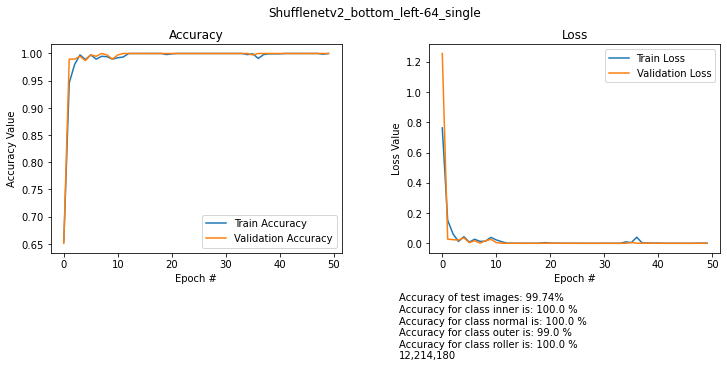

images/bottom_left-64_single/train


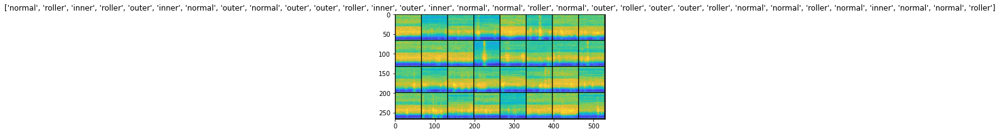

0.6616083383560181
0.12996500730514526
0.03350507467985153
0.0023406236432492733
0.020058412104845047
0.021621566265821457
0.001084639923647046
0.001869188854470849
0.000580780440941453
0.003826507832854986
0.000654735486023128
0.0006743485573679209
0.00025447868392802775
0.09029825776815414
0.004924941807985306
0.03449159488081932
0.0007626082515344024
0.07406491041183472
0.0003290597815066576
8.697478187968954e-05
8.26710820547305e-05
0.00010203213605564088
5.709526521968655e-05
3.3947078918572515e-05
5.3880721679888666e-05
5.068019891041331e-05
0.0007447928655892611
0.018497208133339882
0.0001620587718207389
0.00030009433976374567
0.00012425438035279512
0.0002028095186688006
0.0007772529497742653
6.677717465208843e-05
0.00019126376719214022
6.483301694970578e-05
0.00010212873166892678
5.4647574870614335e-05
2.7884878363693133e-05
6.948504596948624e-05
6.1010468925815076e-05
0.00010485731763765216
8.762575453147292e-05
7.561663369415328e-05
7.550853479187936e-05
4.984420593245886e-05

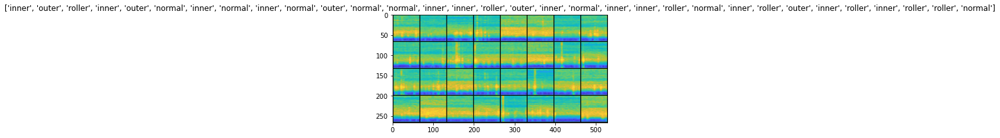

0.6688909530639648
0.5509824752807617
0.0951557457447052
0.023080160841345787
0.05816114693880081
0.03775584325194359
0.018345562741160393
0.022787608206272125
0.005320643074810505
0.0013903318904340267
0.0009520674939267337
0.00257347640581429
0.0022487109526991844
0.023437051102519035
0.001098451903089881
0.009448491036891937
0.0018176545854657888
0.0006563037168234587
0.0003493997501209378
0.00032077112700790167
0.0011848632711917162
0.0001963740069186315
0.00021232335711829364
0.02830824814736843
0.003243554849177599
0.00032135596848092973
0.0011704720091074705
0.07173594832420349
0.0007121171802282333
0.0010459580225870013
7.576617645099759e-05
6.378389662131667e-05
5.594272442976944e-05
0.00030717882327735424
7.770951197016984e-05
0.006430409383028746
0.006681319326162338
0.00015946204075589776
0.007119530346244574
0.00021710357395932078
0.0007302844896912575
0.00032534217461943626
0.00032058381475508213
0.0001929650316014886
0.011751558631658554
0.005879714619368315
0.0001095295

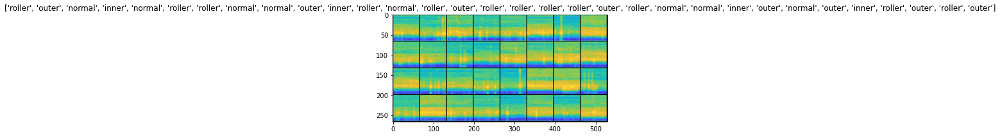

1.3927419185638428
0.02260875329375267
0.120285764336586
0.004236570559442043
0.02295907959342003
0.0091359568759799
0.003341750940307975
0.011077689938247204
0.03680645674467087
0.01746690832078457
0.005893220659345388
0.0062111541628837585
0.026242293417453766
0.0009854468517005444
0.002058852929621935
0.002505337819457054
0.0016283390577882528
0.001396740204654634
0.0012119048042222857
0.0018873440567404032
0.0019216143991798162
0.0011698749149218202
0.0007085066754370928
0.0010800494346767664
0.0016198849771171808
0.0007165453862398863
0.000639472680632025
0.0005488516762852669
0.001204310217872262
0.0010724723106250167
0.0016561553347855806
0.0006595428567379713
0.0010562811512500048
0.00012362122652120888
3.004392419825308e-05
2.7910544304177165e-05
6.0958482208661735e-05
5.5170756240841e-05
3.755797661142424e-05
5.5538592278026044e-05
3.558175376383588e-05
9.806157322600484e-05
0.002314232289791107
0.00013687882164958864
0.00010729648056440055
0.00024288854910992086
0.0001124906

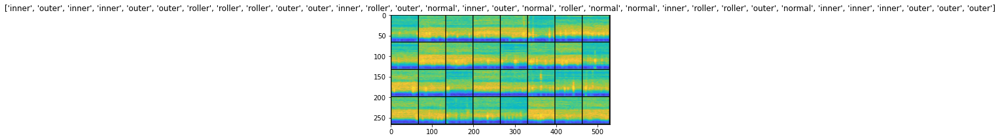

0.6328312754631042
0.07159605622291565
0.20325914025306702
0.08662500232458115
0.020603373646736145
0.0048283240757882595
0.1552261859178543
0.0016748046036809683
0.001227700151503086
0.0027082166634500027
0.014988802373409271
0.005883780308067799
0.0002462749253027141
0.0025661643594503403
0.0006042010500095785
0.00047668800107203424
0.0002870243042707443
0.0016552632441744208
0.0027059358544647694
0.0005485086003318429
0.0036769467405974865
0.00036762116360478103
0.008247649297118187
0.002634507603943348
0.0003811705100815743
0.001972099533304572
0.0003613618900999427
0.007067739497870207
0.006395755335688591
0.00018795205687638372
0.0016108055133372545
0.000372334907297045
0.00012741181126330048
0.00010821747127920389
0.0002518949331715703
0.00045305053936317563
0.00027967127971351147
0.00017315898730885237
0.0001661409332882613
7.870594708947465e-05
7.278895645868033e-05
5.583891106653027e-05
4.908826667815447e-05
0.0001978207001229748
0.00011645030463114381
9.034724644152448e-05
5

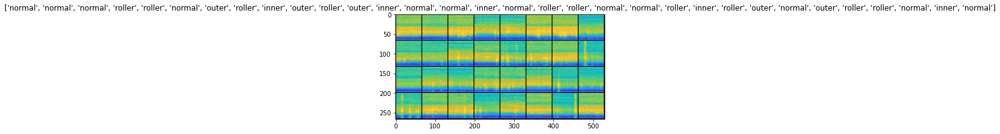

2.205352783203125
0.108876071870327
0.1366540789604187
0.005829762667417526
0.21108567714691162
0.010232985019683838
0.003454302903264761
0.018125001341104507
0.10718893259763718
0.028571676462888718
0.05189981684088707
0.008003887720406055
0.006635876372456551
0.00642460398375988
0.0033400198444724083
0.013172786682844162
0.01427329983562231
0.011783672496676445
0.011530810967087746
0.010033469647169113
0.014690442010760307
0.017254138365387917
0.01148926094174385
0.014354042708873749
0.012656132690608501
0.012793892994523048
0.012070994824171066
0.013540273532271385
0.015185567550361156
0.011276892386376858
0.012165687046945095
0.013863424770534039
0.011868789792060852
0.013756882399320602
0.012746459804475307
0.013677096925675869
0.013574196957051754
0.014396816492080688
0.013217678293585777
0.013478768989443779
0.01149928942322731
0.017697468400001526
0.021642770618200302
0.017485186457633972
0.019725561141967773
0.023986846208572388
0.021201521158218384
0.023122427985072136
0.0203

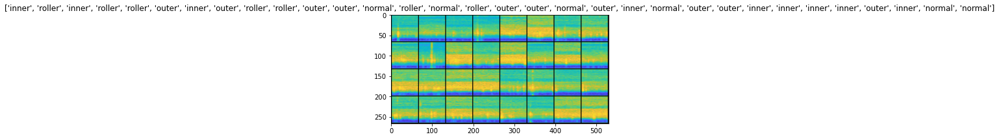

2.68037486076355
0.10594804584980011
0.01712659001350403
0.03784511983394623
0.022042501717805862
0.003292256034910679
0.05489121004939079
0.019062332808971405
0.0034421549644321203
0.016291998326778412
0.003524398896843195
0.00045756864710710943
0.005561420693993568
0.03452673926949501
0.04292323440313339
0.010026652365922928
0.012645380571484566
0.01414102129638195
0.09193529933691025
0.027789689600467682
0.0019775312393903732
0.007528896443545818
0.011324217543005943
0.00877082534134388
0.0018787848530337214
0.01283651776611805
0.0011137333931401372
0.004742753691971302
0.009968828409910202
0.013462824746966362
0.005225989501923323
0.004044320434331894
0.0012294239131733775
0.001001229858957231
0.0011839424259960651
0.0012381644919514656
0.0035659975837916136
0.0016346591291949153
0.001451697084121406
0.012481363490223885
0.005088060162961483
0.008033562451601028
0.00021738586656283587
0.0001850949920481071
0.00017318755271844566
0.00020875633344985545
0.00014500340330414474
0.00014

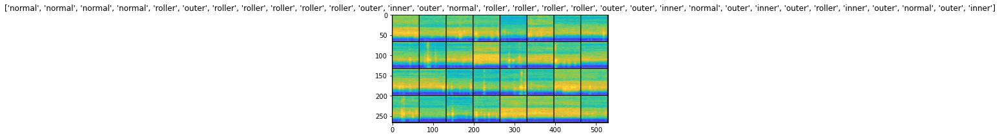

1.6143131256103516
0.049758657813072205
0.017447877675294876
1.3144869804382324
0.03456946462392807
0.04490843415260315
0.0009162984788417816
0.017170533537864685
0.0023438953794538975
0.0011790277203544974
0.009831765666604042
0.0006314293714240193
0.0010686437599360943
0.0004025007365271449
0.00017115226364694536
0.0009035211405716836
0.00020301638869568706
0.2504883110523224
0.007109480910003185
0.0001875745365396142
0.01604323461651802
0.0001671336794970557
8.581731526646763e-05
6.652921729255468e-05
6.726378342136741e-05
7.908679253887385e-05
0.015593064948916435
0.0006604079389944673
0.0003984352806583047
0.0011776459868997335
0.0003297789371572435
8.955338853411376e-05
0.00015422177966684103
0.00012601757771335542
0.00855408888310194
0.0010543321259319782
0.0009290250018239021
0.0006300235982052982
0.00028837661375291646
0.0009567391825839877
0.0001535660558147356
0.00010079202183987945
6.456179835367948e-05
6.395681702997535e-05
4.412351608276367
0.0008066684240475297
0.0017584

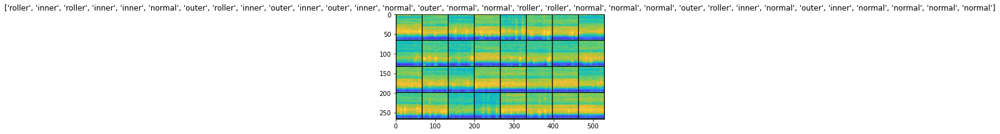

1.1130778789520264
0.16039109230041504
0.01583678647875786
0.0028151562437415123
0.014547477476298809
0.01700032502412796
0.007345288526266813
0.0031893884297460318
0.06940949708223343
0.0015272852033376694
0.05392603203654289
0.05780566856265068
0.012692968361079693
0.001838476862758398
0.0015051010996103287
0.0004161630931776017
0.0008616107515990734
0.0006228970014490187
0.0009532303083688021
0.0005386345437727869
0.0004666383028961718
0.0004183335695415735
0.21855148673057556
0.00030880916165187955
0.00011282922059763223
6.208203558344394e-05
0.00015442959556821734
8.532311039743945e-05
6.569143442902714e-05
7.58217356633395e-05
6.404901796486229e-05
5.4165800975169986e-05
5.573182352236472e-05
4.353483018348925e-05
5.07272343384102e-05
4.753303073812276e-05
7.37097579985857e-05
5.7691941037774086e-05
4.8117974074557424e-05
6.218066846486181e-05
7.340853335335851e-05
4.741794691653922e-05
3.080891474382952e-05
2.3860702640376985e-05
0.00011122399882879108
1.746919224387966e-05
1.75

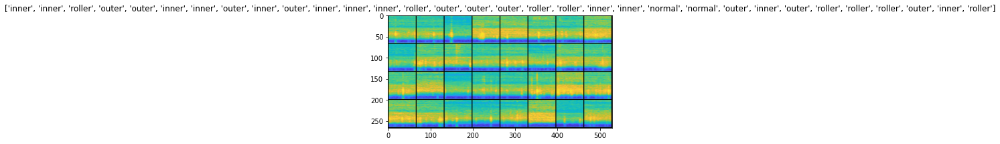

0.43400561809539795
0.4163249135017395
0.007980650290846825
0.014002556912600994
0.1060149222612381
0.014756838791072369
0.00111506471876055
0.16523772478103638
0.0029880800284445286
0.002910841256380081
0.00030444649746641517
0.002736177761107683
0.0033111898228526115
0.0037350007332861423
0.016813410446047783
0.010393107309937477
0.009759420529007912
0.0037136971950531006
0.002815278246998787
0.0025802897289395332
0.0016114965546876192
0.0022954288870096207
0.0025764876045286655
0.00044007014366798103
0.0006703872932121158
0.0010389573872089386
0.00042402310646139085
0.0006334490026347339
0.0005108854384161532
0.0003552655107341707
0.00042981604929082096
0.0002982171718031168
0.00026935688219964504
0.011295629665255547
0.017488060519099236
0.0010139835067093372
0.000655766692943871
0.00019944048835895956
0.0002507118333596736
0.00013890914851799607
0.001975208055227995
0.0007975214393809438
0.0002955494564957917
0.0001334282715106383
0.00044944690307602286
0.0001096760606742464
0.000

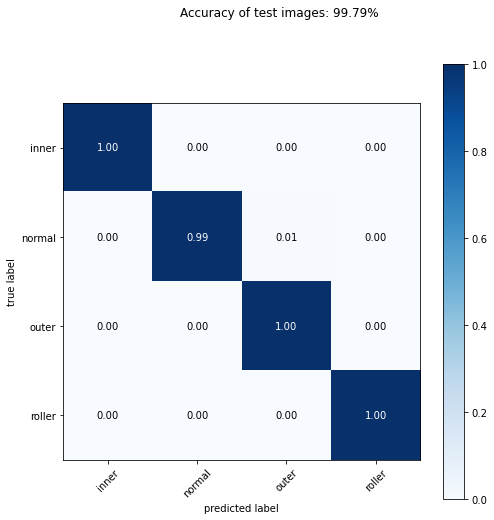

bottom_right-16_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.001 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 3.151% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 2.836% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.210% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.0 GMac, 9.685% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 3.356% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.500% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.059% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), paddin

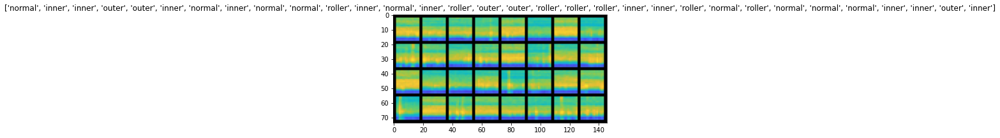

1.281495451927185
0.6894819736480713
0.4205421209335327
0.3495778441429138
0.49584007263183594
0.16840426623821259
0.1889333724975586
0.14536228775978088
0.0888018012046814
0.29034388065338135
0.13642174005508423
0.19204775989055634
0.07109315693378448
0.1666868031024933
0.09477752447128296
0.060692474246025085
0.1392429769039154
0.07851511240005493
0.08202719688415527
0.051832716912031174
0.21920685470104218
0.07076209038496017
0.17331671714782715
0.051018744707107544
0.05173676460981369
0.09724541753530502
0.08962397277355194
0.0710100382566452
0.03937903791666031
0.04254145175218582
0.04858521372079849
0.2018236219882965
0.07165292650461197
0.13579294085502625
0.05057293176651001
0.06174135208129883
0.026446586474776268
0.06421778351068497
0.03156110644340515
0.06659025698900223
0.03221841901540756
0.11031430214643478
0.091618113219738
0.08506430685520172
0.06538921594619751
0.055824004113674164
0.06741748750209808
0.03937959671020508
0.06467723101377487
0.16950613260269165
Finish t

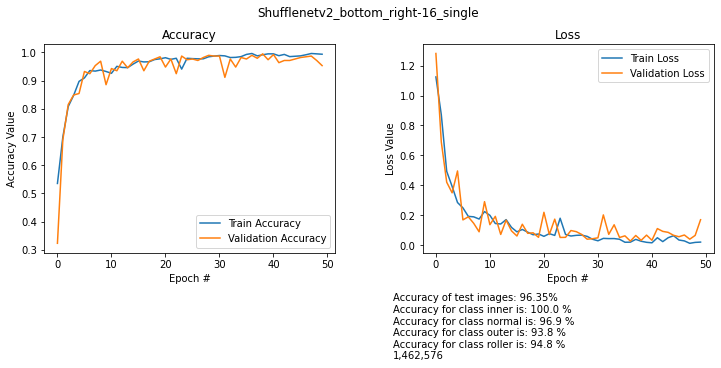

images/bottom_right-16_single/train


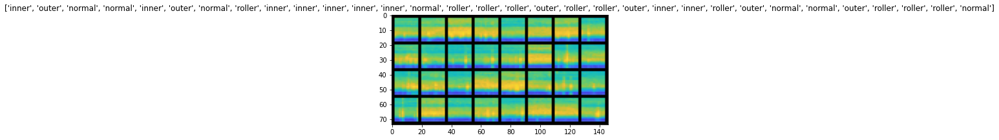

0.9782914519309998
0.7308732867240906
0.9502522349357605
0.4258924424648285
0.17174085974693298
0.30545300245285034
0.3043811023235321
0.09307874739170074
0.1504897177219391
0.3248998522758484
0.06667718291282654
0.09441708773374557
0.2912074029445648
0.05101558193564415
0.10068945586681366
0.16843974590301514
0.28888794779777527
0.07548302412033081
0.1836261749267578
0.0755573958158493
0.047232598066329956
0.09004275500774384
0.05069797858595848
0.04222017526626587
0.08729442954063416
0.10127701610326767
0.15387988090515137
0.07669410109519958
0.09342839568853378
0.05456387996673584
0.11920987814664841
0.04550866782665253
0.16072577238082886
0.07293272018432617
0.04446001350879669
0.06565871834754944
0.08020284026861191
0.2088613212108612
0.15044879913330078
0.046403177082538605
0.0380026176571846
0.06972239911556244
0.05059469863772392
0.04942437261343002
0.19652554392814636
0.08243340998888016
0.11313311755657196
0.045707643032073975
0.06736506521701813
0.27211999893188477
Finish tr

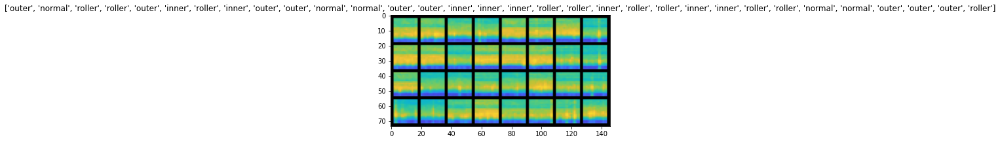

1.103940486907959
0.4779509902000427
0.2487337440252304
0.19407033920288086
0.12963071465492249
0.16800741851329803
0.148982971906662
0.23155862092971802
0.13559111952781677
0.16035638749599457
0.11641895771026611
0.12626191973686218
0.10391049832105637
0.14210963249206543
0.116169273853302
0.16186979413032532
0.5694963335990906
0.16784033179283142
0.07668759673833847
0.1045721024274826
0.1936090886592865
0.08062689751386642
0.07801182568073273
0.10860224068164825
0.04920069873332977
0.07326166331768036
0.08522661030292511
0.07675570249557495
0.059425320476293564
0.0504448264837265
0.03754545748233795
0.11140134930610657
0.06458084285259247
0.24308088421821594
0.027765285223722458
0.033292241394519806
0.0782160609960556
0.031887587159872055
0.0913667231798172
0.07423986494541168
0.07946456968784332
0.038420263677835464
0.02849281206727028
0.041223399341106415
0.024377254769206047
0.12895074486732483
0.04603588581085205
0.04328834265470505
0.019684500992298126
0.05080515146255493
Finish

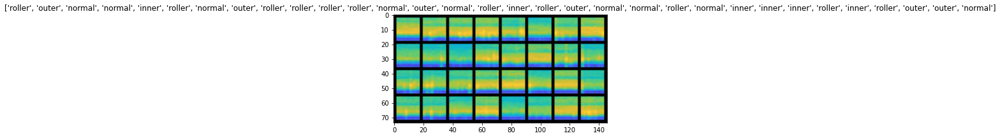

0.9717351794242859
0.447788804769516
0.3739038407802582
0.4728451371192932
0.2814633548259735
0.1360410749912262
0.12973511219024658
0.3288639485836029
0.22326909005641937
0.4390888214111328
0.1275501698255539
0.11028694361448288
0.15378527343273163
0.11246049404144287
0.058536410331726074
0.06704341620206833
0.11019083112478256
0.3037663400173187
0.17791961133480072
0.08699607104063034
0.07022504508495331
0.0506281852722168
0.06121763214468956
0.044001609086990356
0.0645069032907486
0.06002768129110336
0.0704454854130745
0.09387820214033127
0.12890276312828064
0.02399320900440216
0.14147216081619263
0.13962940871715546
0.05633781477808952
0.04890069365501404
0.19688627123832703
0.06705059111118317
0.0496155321598053
0.03294933959841728
0.01780547946691513
0.05095190554857254
0.06405395269393921
0.02957935258746147
0.07850365340709686
0.3016353249549866
0.028153732419013977
0.04902849346399307
0.06089440733194351
0.041162390261888504
0.064010389149189
0.05766814202070236
Finish trainin

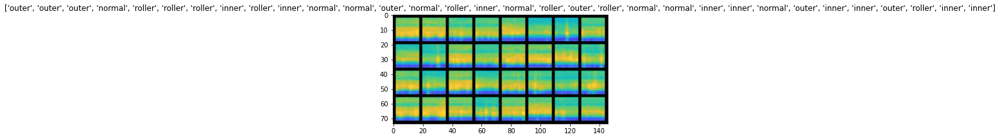

1.5724377632141113
0.8360780477523804
0.6225791573524475
0.5361674427986145
0.39515241980552673
0.6622499823570251
0.20947657525539398
0.15518414974212646
0.16902278363704681
0.11654986441135406
0.09061838686466217
0.09928750991821289
0.08056730031967163
0.05419927462935448
0.06326191127300262
0.12525708973407745
0.12443827837705612
0.03868448734283447
0.08300928771495819
0.24209865927696228
0.08756988495588303
0.06316554546356201
0.09907852113246918
0.18244320154190063
0.046162061393260956
0.17146538197994232
0.2932603061199188
0.0560111366212368
0.036364514380693436
0.022448770701885223
0.018113497644662857
0.022037362679839134
0.11131805181503296
0.047840654850006104
0.11352241039276123
0.030622294172644615
0.01823391392827034
0.008378470316529274
0.04114379733800888
0.05264480412006378
0.030281078070402145
0.01416080817580223
0.17624852061271667
0.10745102167129517
0.03283701837062836
0.029332324862480164
0.02723262831568718
0.047661811113357544
0.027814403176307678
0.0177484974265

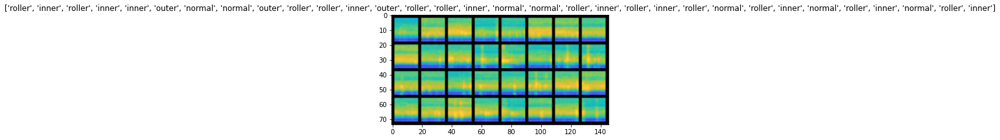

1.1136181354522705
0.48576730489730835
0.3769921064376831
0.4156542718410492
0.1750681847333908
0.10141076147556305
0.12018706649541855
0.13740448653697968
0.06800593435764313
0.10963104665279388
0.04606780409812927
0.10283450782299042
0.21019451320171356
0.313151091337204
0.10720910876989365
0.0815546065568924
0.0256490521132946
0.05708297714591026
0.0601627379655838
0.17837028205394745
0.08185533434152603
0.03273358196020126
0.03483425825834274
0.07486210763454437
0.09593337774276733
0.09010665118694305
0.144022136926651
0.020563123747706413
0.060257893055677414
0.0739917904138565
0.36449092626571655
0.10409142822027206
0.028045466169714928
0.07654016464948654
0.07963733375072479
0.04848448559641838
0.05562513694167137
0.06388434022665024
0.05956115573644638
0.04215425252914429
0.032182883471250534
0.03960104659199715
0.05197031423449516
0.0579824224114418
0.09500350803136826
0.03305961564183235
0.0635109543800354
0.03624551743268967
0.13770653307437897
0.041054617613554
Finish train

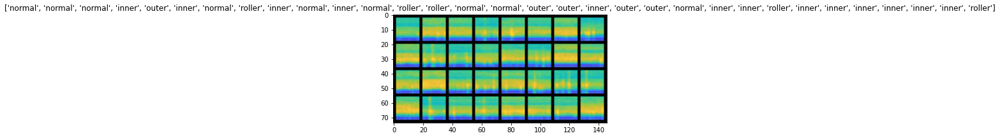

0.9340704679489136
0.5391428470611572
0.4118770956993103
0.7439073324203491
0.19960391521453857
0.10688966512680054
0.12807095050811768
0.10837496817111969
0.09770584106445312
0.1290430724620819
0.14964614808559418
0.3228873908519745
0.07522208988666534
0.2926246225833893
0.13897840678691864
0.1587737798690796
0.23316268622875214
0.09383603185415268
0.15722879767417908
0.219655379652977
0.05817171931266785
0.08135879039764404
0.21760281920433044
0.056609898805618286
0.11873489618301392
0.04643455147743225
0.05918902903795242
0.10254791378974915
0.04383023828268051
0.038702961057424545
0.037981919944286346
0.04274759441614151
0.07814013212919235
0.05369901284575462
0.09021833539009094
0.06898697465658188
0.05738519877195358
0.07603266835212708
0.1867857426404953
0.09237483143806458
0.08688303828239441
0.05217745900154114
0.020218372344970703
0.03182956576347351
0.07564890384674072
0.06749533116817474
0.11847927421331406
0.01680007576942444
0.015406038612127304
0.03543568402528763
Finish

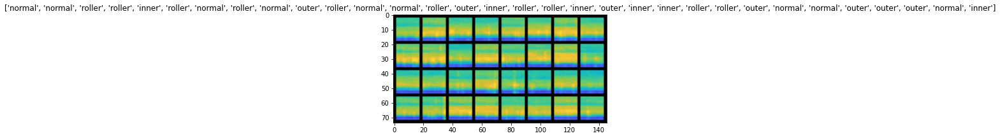

1.163374423980713
0.33047226071357727
0.16164641082286835
0.14815853536128998
0.13495784997940063
0.08636882901191711
0.11308173835277557
0.11590629070997238
0.24389497935771942
0.14126640558242798
0.08182331919670105
0.0907280296087265
0.04316067323088646
0.11183538287878036
0.06818552315235138
0.05112607777118683
0.07407285273075104
0.040131278336048126
0.09439723938703537
0.03853726387023926
0.06692372262477875
0.1064431220293045
0.0678890198469162
0.0479058101773262
0.05402400344610214
0.08820962905883789
0.0804901123046875
0.11772894859313965
0.10711440443992615
0.04668937623500824
0.023514598608016968
0.01998709887266159
0.07555480301380157
0.34156638383865356
0.07239876687526703
0.045207053422927856
0.06357799470424652
0.04542943835258484
0.08048497140407562
0.04983394965529442
0.01981731504201889
0.014853673055768013
0.014025024138391018
0.013743839226663113
0.05423109978437424
0.015102889388799667
0.011464118957519531
0.023867838084697723
0.022192303091287613
0.070690050721168

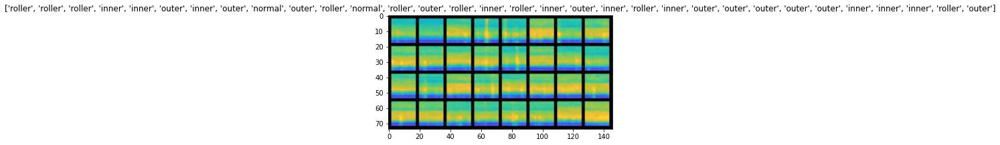

1.0551769733428955
0.3815724849700928
0.2144070863723755
0.28354835510253906
0.19088050723075867
0.14138802886009216
0.9523927569389343
0.10482381284236908
0.07493098080158234
0.07020187377929688
0.06340713798999786
0.05287814140319824
0.09229631721973419
0.0710172951221466
0.058821406215429306
0.331892192363739
0.10267767310142517
0.16705703735351562
0.05597735941410065
0.04648555442690849
0.059713851660490036
0.07637252658605576
0.061080001294612885
0.04964160919189453
0.072564497590065
0.03204520046710968
0.11084892600774765
0.11236609518527985
0.02526404708623886
0.0243174210190773
0.017526693642139435
0.03365238010883331
0.16345849633216858
0.016299370676279068
0.01837184652686119
0.02428397350013256
0.014078754931688309
0.0971774011850357
0.03001169115304947
0.15481753647327423
0.1299574077129364
0.0446738563477993
0.061455659568309784
0.015604889020323753
0.10746489465236664
0.02964020147919655
0.021398579701781273
0.013606427237391472
0.03639757260680199
0.019988976418972015
Fi

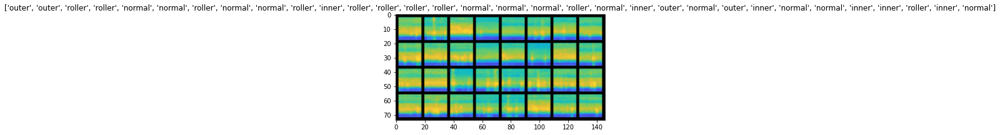

1.4688804149627686
0.4932233989238739
0.2431597113609314
0.1972261667251587
0.20276391506195068
0.5288921594619751
0.19597259163856506
0.6079387664794922
0.13406437635421753
0.20314645767211914
0.1065225750207901
0.09842464327812195
0.09109797328710556
0.13864029943943024
0.2066844403743744
0.18774257600307465
0.11193932592868805
0.12920531630516052
0.1474200189113617
0.1580010950565338
0.11553801596164703
0.3781896233558655
0.1645694375038147
0.11489363014698029
0.1943730115890503
0.06773091852664948
0.09051814675331116
0.06255614757537842
0.10969789326190948
0.06927285343408585
0.1334879845380783
0.08845063298940659
0.26258140802383423
0.09127697348594666
0.11583501100540161
0.06578737497329712
0.04705767333507538
0.07811807096004486
0.032383281737565994
0.11722411215305328
0.11349603533744812
0.09351961314678192
0.08715232461690903
0.15825730562210083
0.0627647340297699
0.29521673917770386
0.052503474056720734
0.072829969227314
0.0879034698009491
0.07186273485422134
Finish training!

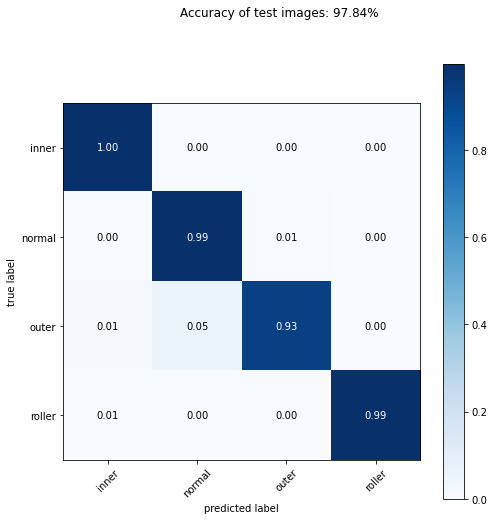

bottom_right-32_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.003 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 6.030% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 5.427% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.001 GMac, 18.537% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 6.423% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.958% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), pad

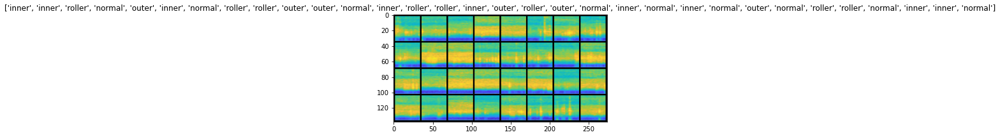

0.8542119264602661
0.2621750831604004
0.12373173236846924
0.24119138717651367
0.07254385948181152
0.062480807304382324
0.4396987557411194
0.11970064043998718
0.16249792277812958
0.03270139545202255
0.020378392189741135
0.04305347800254822
0.036711953580379486
0.04464190825819969
0.02649654448032379
0.00486512016505003
0.022282449528574944
0.003884259145706892
0.016364388167858124
0.03237273544073105
0.00335431145504117
0.007058821152895689
0.019051089882850647
0.006876449566334486
0.013241155073046684
0.001786102307960391
0.004296684637665749
0.0013757151318714023
0.007977640256285667
0.0015060554724186659
0.0024249949492514133
0.005407171323895454
0.002179758157581091
0.014213500544428825
0.003849469590932131
0.001987252850085497
0.02808760665357113
0.0007637952803634107
0.003194762161001563
0.012416386976838112
0.0052438098937273026
0.027213875204324722
0.010356384329497814
0.009084556251764297
0.006725431419909
0.004287605173885822
0.003295007860288024
0.00395806273445487
0.00358761

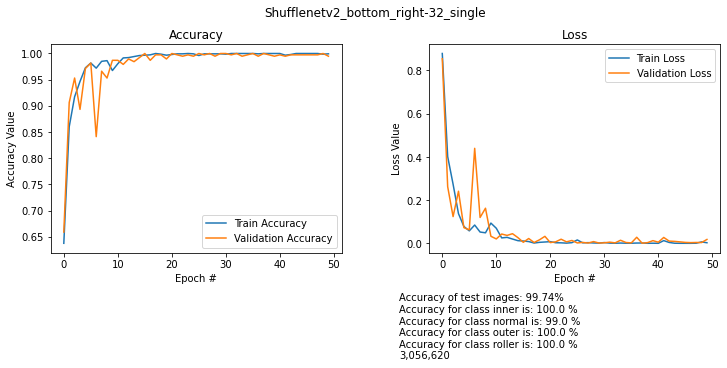

images/bottom_right-32_single/train


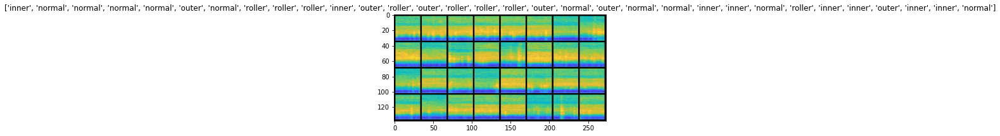

0.5508878231048584
0.09067799150943756
0.20645037293434143
0.05126790329813957
0.030708765611052513
0.055767983198165894
0.09635650366544724
0.03642045706510544
0.03573675453662872
0.033765748143196106
0.005951438099145889
0.049444861710071564
0.03103029355406761
0.005947453435510397
0.16052985191345215
0.028524182736873627
0.03224847465753555
0.00532643822953105
0.022522728890180588
0.02117803692817688
0.01588767021894455
0.027633747085928917
0.01755639538168907
0.028399154543876648
0.006797711830586195
0.00855732336640358
0.010399038903415203
0.018462074920535088
0.2340013086795807
0.06932938098907471
0.03426046296954155
0.032034896314144135
0.01161003764718771
0.006303138565272093
0.006540930829942226
0.0033809717278927565
0.008401656523346901
0.01787852868437767
0.007960392162203789
0.00697941891849041
0.006861749105155468
0.007186246104538441
0.005525009706616402
0.00719328923150897
0.006880267523229122
0.006614663638174534
0.005526389926671982
0.008973360061645508
0.0089790178462

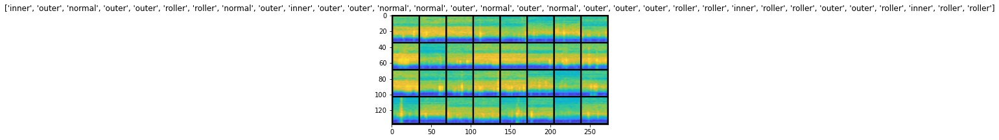

0.5876604914665222
0.2000337541103363
0.11820044368505478
0.3436177372932434
0.009937971830368042
0.007625681813806295
0.01199263148009777
0.026285097002983093
0.010798669420182705
0.009468681178987026
0.0024791276082396507
0.018368642777204514
0.006054024677723646
0.02231096290051937
0.0035616839304566383
0.018751677125692368
0.018760092556476593
0.0060517508536577225
0.0033850749023258686
0.018665827810764313
0.016886960715055466
0.001413318794220686
0.001690978417173028
0.0021648574620485306
0.015572011470794678
0.0017688414081931114
0.0006288343574851751
0.00046122627099975944
0.00037153015728108585
0.0005648994701914489
0.0004006733070127666
0.008928261697292328
0.005128365941345692
0.0026584656443446875
0.0023626605980098248
0.0012629602570086718
0.0005018748342990875
0.0006106052896939218
0.0007149611483328044
0.00041331571992486715
0.0006642824737355113
0.0025478736497461796
0.0008818100905045867
0.0006215481553226709
0.0007041924400255084
0.0010606267023831606
0.00101085321512

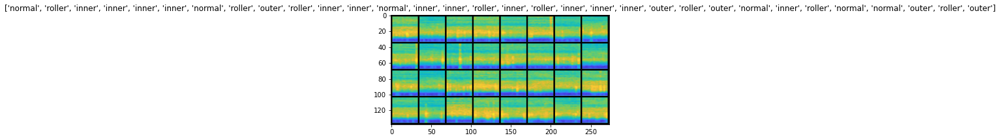

2.8620057106018066
0.6098406314849854
0.329572856426239
0.08218541741371155
0.0688701868057251
0.026366040110588074
0.0705842524766922
0.03401926904916763
0.04320704564452171
0.004281307570636272
0.007097654975950718
0.012692417949438095
0.02058499865233898
0.12440580129623413
0.015120572410523891
0.27756744623184204
0.0073753539472818375
0.007611348759382963
0.0014352751895785332
0.004590657074004412
0.001768062124028802
0.014744240790605545
0.00352161331102252
0.0013082127552479506
0.0008706093649379909
0.0009441502625122666
0.0011106625897809863
0.0004911191063001752
0.00042728561675176024
0.08418986201286316
0.0681769847869873
0.0016981986118480563
0.0007497838232666254
0.0008648041402921081
0.04660894721746445
0.0023064243141561747
0.013874976895749569
0.0035743878688663244
0.00040847627678886056
0.00119885616004467
0.0006035850383341312
0.020173892378807068
0.0004829541430808604
0.012118371203541756
0.0007822960033081472
0.00014594232197850943
0.00521114282310009
0.00039629600360

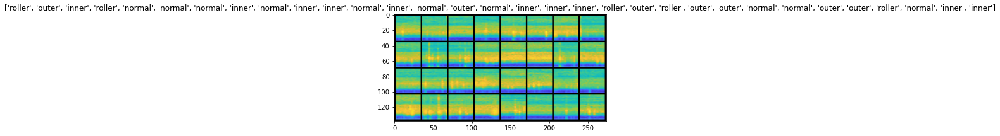

0.988261878490448
0.1508035957813263
0.4402548670768738
0.06512370705604553
0.06379201263189316
0.19317364692687988
0.015616072341799736
0.10178181529045105
0.34410327672958374
0.027174748480319977
0.010254484601318836
0.006959967315196991
0.017801374197006226
0.05405397713184357
0.009268958121538162
0.013954509049654007
0.012259363196790218
0.047920845448970795
0.740884006023407
0.0028557588811963797
0.00790872611105442
0.008513347245752811
0.020387522876262665
0.01934843324124813
0.0908597931265831
0.010697416961193085
0.018433794379234314
0.01150454580783844
0.005615588277578354
0.004865121096372604
0.004669806454330683
0.004238075576722622
0.004217728041112423
0.0018846504390239716
0.002235256601125002
0.001386485993862152
0.002146474551409483
0.00114463921636343
0.00234775198623538
0.002564678667113185
0.00849136896431446
0.014059161767363548
0.0012501617893576622
0.0011093488428741693
0.0014682374894618988
0.0022211968898773193
0.002292314078658819
0.0021641990169882774
0.0011352

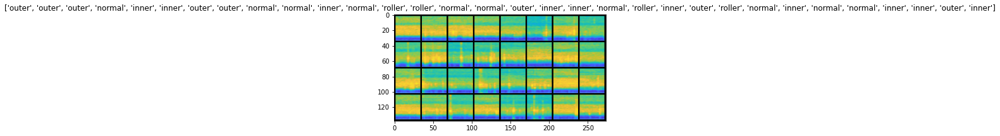

1.0712093114852905
0.5986568331718445
0.44599252939224243
0.0454714298248291
0.09812481701374054
0.22786349058151245
0.029059819877147675
0.04195871204137802
0.01660299487411976
0.005108685232698917
0.0040182992815971375
0.013393758796155453
0.004791158717125654
0.003508811816573143
0.009066506288945675
0.0015791549813002348
0.008344696834683418
0.00188816012814641
0.0034172830637544394
0.00035976964863948524
0.0011719678295776248
0.0017679383745416999
0.0005943477153778076
0.39142948389053345
0.07289194315671921
0.004981351550668478
0.01034064032137394
0.0025199803058058023
0.0031748898327350616
0.0073732901364564896
0.002642383798956871
0.009274223819375038
0.005712489597499371
0.0006589068798348308
0.0016606578137725592
0.001353178871795535
0.0009168474352918565
0.0008242507465183735
0.0008577640983276069
0.0011282232590019703
0.0009066021302714944
0.0009177380125038326
0.006150475703179836
0.0012301912065595388
0.0030287771951407194
0.00138476537540555
0.0009784152498468757
0.00153

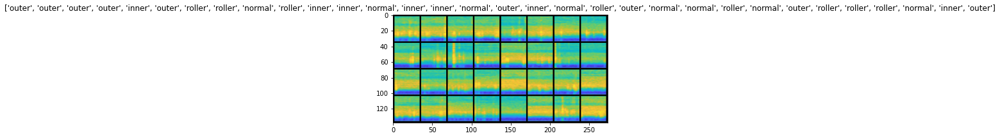

2.943253993988037
0.45017343759536743
0.35016101598739624
0.17436520755290985
0.18372440338134766
0.13593779504299164
0.03043491207063198
0.09828399866819382
0.015600352548062801
0.02930966578423977
0.06967881321907043
0.08475115150213242
0.10247032344341278
0.11787796020507812
0.017178921028971672
0.009652689099311829
0.02240278199315071
0.025819551199674606
0.009731161408126354
0.026545241475105286
0.016866091638803482
0.018185846507549286
0.050922807306051254
0.024071281775832176
0.04129832983016968
0.011002158746123314
0.059225670993328094
0.04000922292470932
0.06797605752944946
0.02006099559366703
0.09081269800662994
0.01554911956191063
0.01717722974717617
0.0040685515850782394
0.006339408457279205
0.009626422077417374
0.014756012707948685
0.014978379011154175
0.019356045871973038
0.023834340274333954
0.022503573447465897
0.019054856151342392
0.023666389286518097
0.011886960826814175
0.017354272305965424
0.02065219357609749
0.02172776311635971
1.7756503820419312
0.0533424019813537

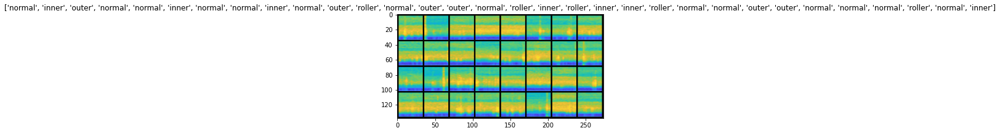

1.1036914587020874
0.1285979300737381
0.06877955049276352
0.029630817472934723
0.052595652639865875
0.048145145177841187
0.032134465873241425
0.1524994969367981
0.010309041477739811
0.07164657115936279
0.021365273743867874
0.01534464955329895
0.07080692797899246
0.03515757620334625
0.002040131716057658
0.0027077391277998686
0.00418078014627099
0.004162435419857502
0.004388525150716305
0.002744746394455433
0.006761945318430662
0.0013954979367554188
0.0032828233670443296
0.017914412543177605
0.005190202035009861
0.009161624126136303
0.008694348856806755
0.0035260184668004513
0.00403537368401885
0.009878415614366531
0.004445680882781744
0.002829954493790865
0.003341308329254389
0.002895556390285492
0.0027084876783192158
0.003104757284745574
0.00964355282485485
0.0068666874431073666
0.01040390320122242
0.0031927917152643204
0.004699908196926117
0.0032097753137350082
0.0009530810639262199
0.0012111463584005833
0.0011148630874231458
0.0018183283973485231
0.0014491640031337738
0.0021352036856

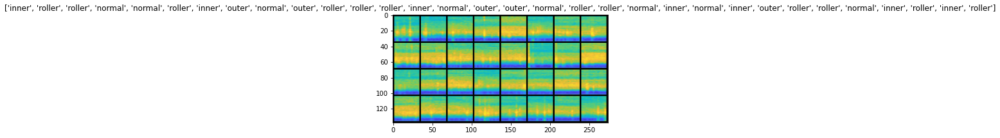

1.741970419883728
0.9747655391693115
0.15853530168533325
0.14495797455310822
0.11216519773006439
0.053403954952955246
0.08447092771530151
0.1029721051454544
0.06910517811775208
0.03389336168766022
0.019281119108200073
0.022892577573657036
0.024269629269838333
0.012744146399199963
0.0280379056930542
0.030526641756296158
0.0180596224963665
0.055643267929553986
0.013394763693213463
0.004063475877046585
0.057185377925634384
0.006764316000044346
0.004742539022117853
0.010338612832129002
0.0049240547232329845
0.050180237740278244
0.013283679261803627
0.06710981577634811
0.048678092658519745
0.13482801616191864
0.13919883966445923
0.021494124084711075
0.002247571712359786
0.001739775063470006
0.001245215185917914
0.0022400924935936928
0.0014678963925689459
0.005415724590420723
0.0005037225782871246
0.0003477598656900227
0.000381677586119622
0.00038428447442129254
0.0002851811586879194
0.00027596292784437537
0.0003073814732488245
0.0002826199634000659
0.0002678282908163965
0.000435884197941049

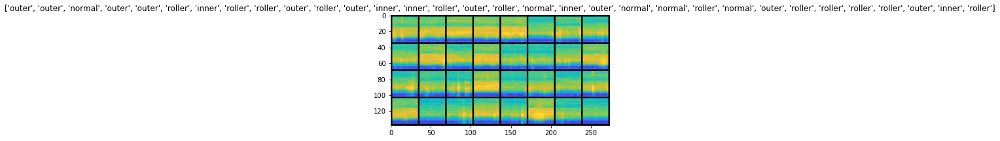

1.075084924697876
0.3283016085624695
0.10983017086982727
0.3510152995586395
0.12592393159866333
0.006573238875716925
0.035920239984989166
0.0015610784757882357
0.0031242389231920242
0.027186408638954163
0.005746768321841955
0.0022786781191825867
0.006184255704283714
0.0051671769469976425
0.0010429325047880411
0.0006834484520368278
0.0017456184141337872
0.0010488596744835377
0.014786841347813606
0.12810325622558594
0.005851604975759983
0.0045488267205655575
0.003856831695884466
0.005794360768049955
0.0056348866783082485
0.2820959687232971
0.017461184412240982
0.002041327301412821
0.008210426196455956
0.0022214544005692005
0.0007013778085820377
0.0003697063948493451
0.0033688731491565704
0.011372595094144344
0.0029200322460383177
0.0007289612549357116
0.0004018415929749608
0.00988380890339613
0.004096121061593294
0.1273021101951599
0.15433761477470398
0.18545538187026978
0.009758793748915195
0.002575154881924391
0.003726918948814273
0.10431086272001266
0.052938543260097504
0.007894581183

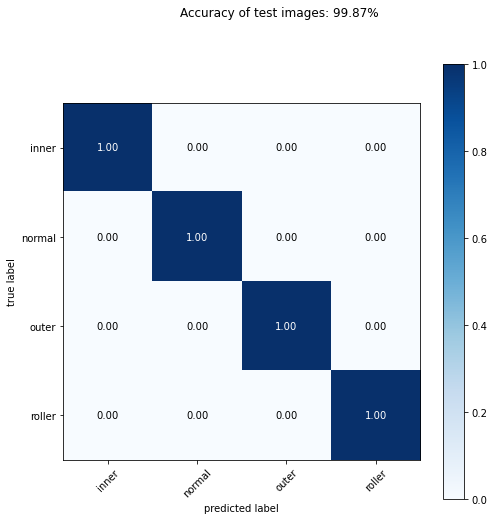

bottom_right-64_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.012 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.001 GMac, 6.036% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.001 GMac, 5.433% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.002 GMac, 18.555% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.001 GMac, 6.429% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.959% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2

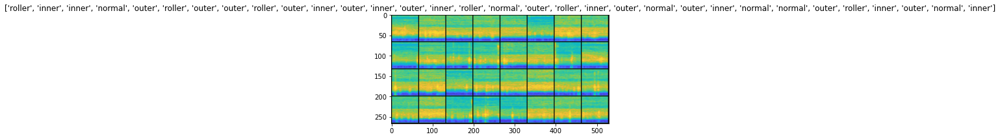

3.260807991027832
0.04159980267286301
0.0075630745850503445
0.07225819677114487
0.033487796783447266
0.0183354951441288
0.010172145441174507
0.0010104356333613396
0.0015058958670124412
0.00038127388688735664
0.00031969405245035887
0.005508901085704565
0.07280394434928894
0.004920714534819126
0.0015492838574573398
0.0021548441145569086
0.003390438389033079
0.00010044813097920269
0.0013455869629979134
0.0005307174287736416
0.0004917471669614315
0.004822698421776295
0.0025449383538216352
0.0005278824246488512
0.001145780785009265
0.00015955221897456795
0.0005319347255863249
0.00037639058427885175
0.00039691367419436574
0.0012609193800017238
0.0036464601289480925
0.005129583179950714
0.007132114376872778
0.00692369369789958
0.005508939735591412
0.00340785994194448
0.004203115589916706
0.0002183406031690538
0.0004489267885219306
0.0003509220841806382
0.012708588503301144
0.024116456508636475
0.015198580920696259
0.010275181382894516
0.010272897779941559
0.010180211625993252
0.01041357219219

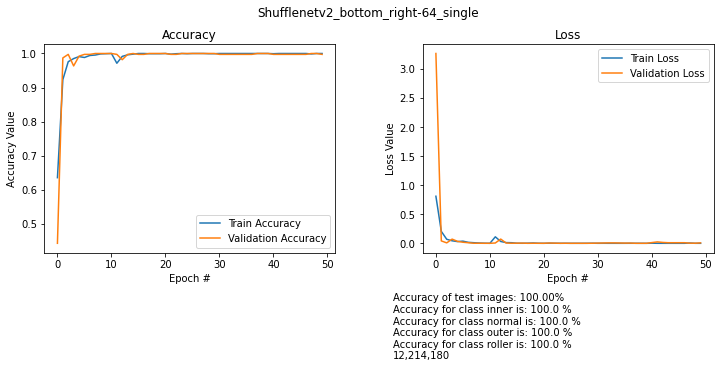

images/bottom_right-64_single/train


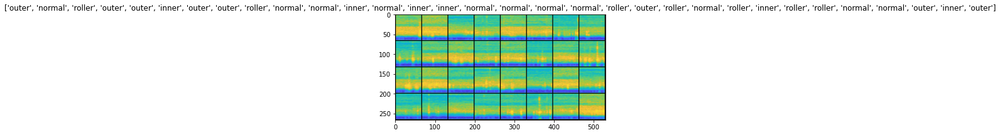

0.9444550275802612
0.25584518909454346
0.5569663643836975
0.11449890583753586
0.027637232095003128
0.004183345474302769
0.029040059074759483
0.00037697292282246053
0.028669454157352448
0.0008951177587732673
0.005397809203714132
0.0006123038474470377
0.009515930898487568
0.0005587166524492204
0.015213808976113796
0.0004816522996407002
0.00020926671277265996
0.00014492112677544355
0.00011372145672794431
0.00014504019054584205
0.01288795005530119
0.0025023319758474827
0.0007434907602146268
0.0008204776677303016
0.13410316407680511
0.007407615892589092
0.00019041544874198735
0.00022247908054850996
0.00012278281792532653
0.00011855992488563061
0.0024098102003335953
0.00334001611918211
0.0016594543121755123
5.448312731459737e-05
8.275420259451494e-05
4.9697886424837634e-05
4.282260488253087e-05
3.5855140595231205e-05
0.008026357740163803
0.0003844229504466057
0.0004870312986895442
0.00015249050920829177
0.00022065389202907681
0.00014208474021870643
0.00018727488350123167
0.000161169766215607

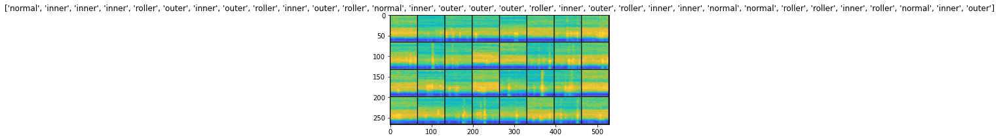

0.41142839193344116
0.021838951855897903
0.542209804058075
0.03478136286139488
0.560656726360321
0.058631472289562225
0.021659288555383682
0.0035293973051011562
0.1804007887840271
0.0047866846434772015
0.0022103707306087017
0.0015030214563012123
0.0004816438304260373
0.011654989793896675
0.004496511071920395
0.02120356075465679
0.002977358642965555
0.0005562105216085911
0.0008610467193648219
0.0006209720158949494
0.0003488327783998102
0.0001981073583010584
0.0003256021882407367
0.0006634325254708529
0.00386001355946064
0.00444784015417099
0.005676619242876768
0.0007615340873599052
0.00025211548199877143
0.00014870695304125547
0.0011440233793109655
0.00016940476780291647
0.00029015267500653863
0.0005052290507592261
0.0010033564176410437
0.0005771524738520384
0.000491661368869245
0.0002174212713725865
0.0012270170263946056
0.0011875012423843145
0.0022651166655123234
0.0011547498870640993
0.0004157540970481932
0.0017701586475595832
0.008202197030186653
0.0001677570107858628
0.001052051549

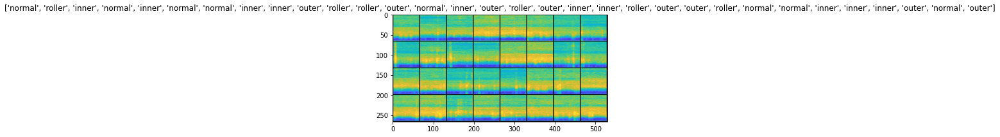

1.0760389566421509
0.15729518234729767
0.08407332748174667
0.08903034776449203
0.13312870264053345
0.01715182512998581
0.0014399143401533365
0.1017371267080307
0.0013513602316379547
0.003555519971996546
0.003257422475144267
0.0013286613393574953
0.08621171116828918
0.02339169755578041
0.005321137141436338
0.007197496481239796
0.004985596518963575
0.008451166562736034
0.010041654109954834
0.003602887038141489
0.04397457838058472
0.015583038330078125
0.0013030325062572956
0.028729643672704697
0.000700082047842443
0.0019428310915827751
0.000645340362098068
0.00029840931529179215
0.0003362552961334586
0.001125985523685813
0.05498138815164566
0.00020652169769164175
0.04490865021944046
0.09632211178541183
0.004992370959371328
0.005149859469383955
0.0010019480250775814
0.0007419681642204523
0.0009078297298401594
0.0005940726259723306
0.0006655334727838635
0.0007544094696640968
0.0005236444994807243
0.000714677560608834
0.0011627960484474897
0.0005562679143622518
0.00027089857030659914
0.00016

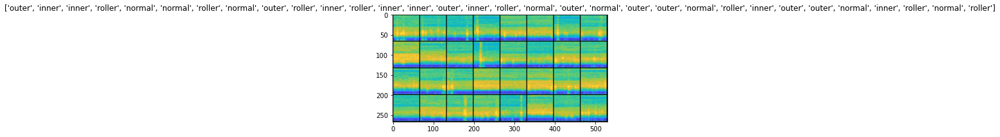

0.5310267806053162
0.20822930335998535
0.025856634601950645
0.02315322682261467
0.020092492923140526
0.0031142598018050194
0.0022962545044720173
0.019804075360298157
0.0062114642933011055
0.0006512714317068458
0.008800085633993149
0.032829251140356064
0.031772430986166
0.0020163357257843018
0.00030454713851213455
0.00011936685041291639
0.0007588104344904423
0.00025711936177685857
0.0002255226718261838
0.00019572504970710725
8.731996058486402e-05
8.382132364204153e-05
7.236370583996177e-05
0.00012290655286051333
6.368441972881556e-05
7.89307669037953e-05
8.290562254842371e-05
0.00015392398927360773
0.04272624850273132
0.029351476579904556
0.021077249199151993
0.016489127650856972
0.033388588577508926
0.06058063358068466
0.0027024324517697096
0.0004965778207406402
0.0020883376710116863
0.0023044836707413197
0.0011922019766643643
0.0007586797000840306
0.0007945172255858779
0.0008025171118788421
0.00034785011666826904
0.00012732137111015618
8.306748350150883e-05
2.9348429961828515e-05
3.47

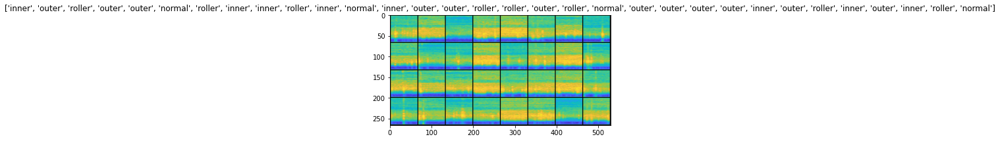

0.7321885824203491
0.06438635289669037
0.09040483832359314
0.006711781024932861
0.013420196250081062
0.03756837174296379
0.011616267263889313
0.012665262445807457
0.034151144325733185
0.0009934284025803208
0.001382171642035246
0.02317861095070839
0.015041926875710487
0.0048708003014326096
0.01868640072643757
0.019569363445043564
0.003985903225839138
0.0023122290149331093
0.0004221628769300878
0.000172432919498533
0.00013004134234506637
0.0005645568016916513
0.0001478479680372402
0.00030037795659154654
0.0001089741344912909
0.0002499010879546404
0.0005740220076404512
0.00090799480676651
0.00015470317157451063
0.0001449211995350197
6.996006413828582e-05
9.097692964132875e-05
8.292710117530078e-05
5.98239857936278e-05
8.990308560896665e-05
5.470472387969494e-05
0.0009135669097304344
0.0022624197881668806
0.01111788209527731
0.0008398026111535728
0.0007521221414208412
0.0014217966236174107
0.0005725735682062805
0.002028152346611023
0.0029994340147823095
0.0017039852682501078
0.001008438877

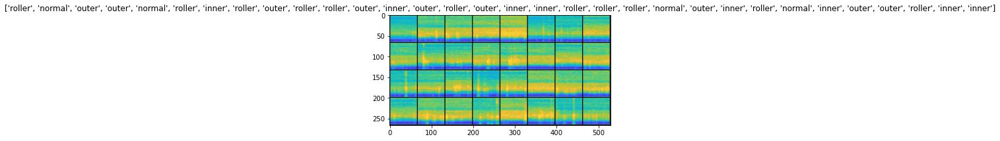

2.1886463165283203
0.5129665732383728
0.03992103785276413
0.04445551335811615
0.019977634772658348
0.005076147615909576
0.01148208137601614
0.012229710817337036
0.008789308369159698
0.0009940880117937922
0.00016875096480362117
0.00011998656555078924
0.00019364486797712743
7.184519927250221e-05
5.843539474881254e-05
9.251809387933463e-05
5.485658039106056e-05
5.538876212085597e-05
4.8196390707744285e-05
0.00010703733278205618
0.0002522227878216654
7.472033030353487e-05
0.0010193490888923407
0.0015390245243906975
0.014162478968501091
0.0009244026150554419
0.006840846501290798
0.0015612561255693436
0.0013047200627624989
0.001246682833880186
0.0017838472267612815
0.0020186256151646376
0.0012895922409370542
0.0032804913353174925
0.0034528018441051245
0.00378265418112278
0.004777812864631414
0.0031820014119148254
0.004354376345872879
0.006858320441097021
0.003164707450196147
0.005915125831961632
0.007024483755230904
0.00609622523188591
0.00721002696081996
0.005328773520886898
0.0062861624173

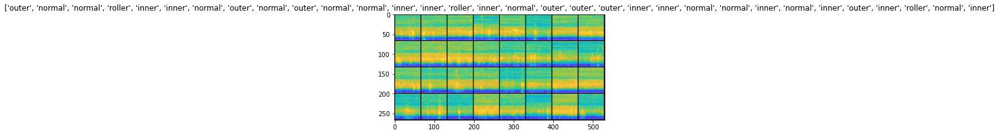

0.7611273527145386
0.09847532957792282
0.22831755876541138
0.003068597987294197
0.06854240596294403
0.026928674429655075
0.004972388036549091
0.0025718510150909424
0.009036378934979439
0.06688450276851654
0.010577250272035599
0.010178937576711178
0.011861992999911308
0.010410314425826073
0.004864192102104425
0.0064345067366957664
0.00795856211334467
0.009469125419855118
0.006948171183466911
0.013356290757656097
0.13391725718975067
0.006599821150302887
0.007211442571133375
0.008610280230641365
0.0076170130632817745
0.006048956420272589
0.007668016478419304
0.0025242608971893787
0.0045477766543626785
0.004074594937264919
0.004430833738297224
0.007107170298695564
0.011534838005900383
0.010495047084987164
0.018286962062120438
0.032067470252513885
0.015756603330373764
0.01574433222413063
0.0071576181799173355
0.008048130199313164
0.0004060069040860981
0.00030096981208771467
0.00025059538893401623
0.00021936054690741003
0.00010691900388337672
0.00019974508904851973
0.00010720900900196284
4.8

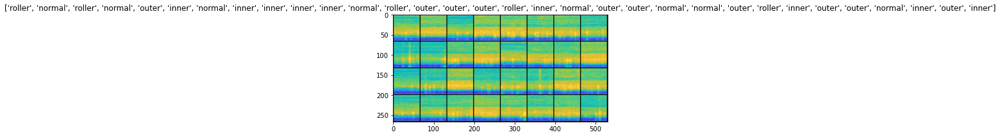

0.8386914730072021
0.1285419464111328
0.02570720575749874
0.032989710569381714
0.04404224455356598
0.0031237355433404446
0.04555673897266388
0.06937121599912643
0.07225164026021957
0.01003403589129448
0.0029047317802906036
0.0016743330052122474
0.01639362797141075
0.006584726274013519
0.005314098205417395
0.0038180004339665174
0.007470584940165281
0.007794498931616545
0.00333226821385324
0.004577537067234516
0.0005773045122623444
0.0021204377990216017
0.0012034394312649965
0.0009100809111259878
0.0020824489183723927
0.0017890685703605413
0.0006004151655361056
0.00022705478477291763
0.009027061983942986
0.008587423712015152
0.0007278787670657039
0.0048485794104635715
0.0018560804892331362
0.3673059642314911
0.004393641836941242
0.01001350674778223
0.0012903246097266674
0.0001450612471671775
0.004531611688435078
0.0005922773852944374
0.0001824772043619305
0.00011035152419935912
0.00022045795049052685
0.00014781070058234036
0.00017755359294824302
0.00010345752525608987
0.00012011321814497

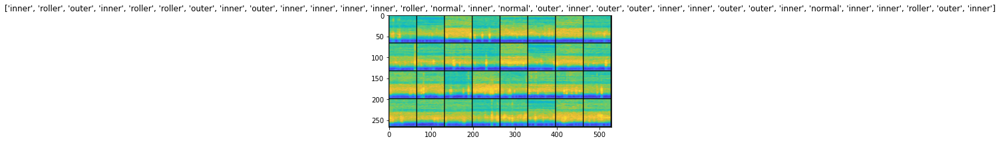

0.5810675621032715
0.025013698264956474
0.21617472171783447
0.040020208805799484
0.0009623313671909273
0.0011742135975509882
0.02698330394923687
0.19524046778678894
0.07221777737140656
0.005464689806103706
0.0010768070351332426
0.002616331446915865
0.02827523462474346
0.004630273208022118
0.011673932895064354
0.009746469557285309
0.002459923969581723
0.00027036870596930385
0.00023651483934372663
0.00017030717572197318
0.00022571877343580127
0.00019865078502334654
9.734473860589787e-05
0.0002470316831022501
9.71455592662096e-05
0.00046528998063877225
0.00045135803520679474
7.095753971952945e-05
8.85451736394316e-05
4.9849644710775465e-05
6.0020258388249204e-05
0.0002004176494665444
0.011221472173929214
0.003992940299212933
0.0003651932056527585
0.00019827496726065874
0.000222931252210401
9.006659092847258e-05
6.960488099139184e-05
5.703599890694022e-05
5.60646403755527e-05
5.50813419977203e-05
4.841026020585559e-05
5.483340646605939e-05
3.768082387978211e-05
2.8954475055797957e-05
3.688

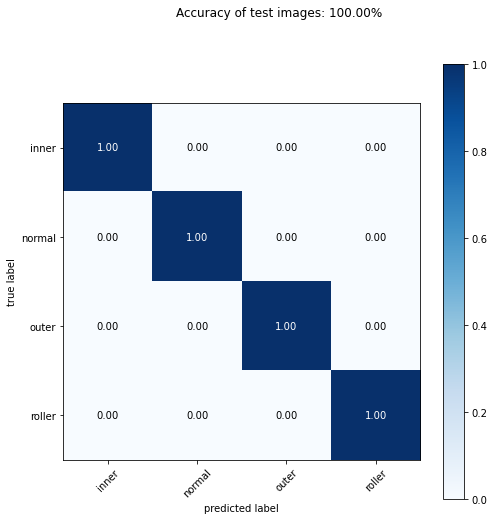

middle-16_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.001 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 3.151% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 2.836% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.210% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.0 GMac, 9.685% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 3.356% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.500% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.059% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 

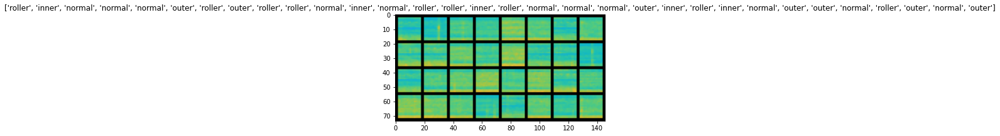

1.462113857269287
0.89056795835495
0.37425023317337036
0.6998156309127808
0.3227352797985077
0.16853027045726776
0.16936568915843964
0.21910659968852997
0.1985832154750824
0.13025715947151184
0.2789388597011566
0.14677032828330994
0.30280163884162903
0.10436095297336578
0.10843216627836227
0.10943678021430969
0.1168680489063263
0.11471860855817795
0.09534874558448792
0.1639222800731659
0.07543867826461792
0.08161342144012451
0.14626316726207733
0.12322824448347092
0.12742172181606293
0.06153016909956932
0.08135057240724564
0.153478741645813
0.11048924922943115
0.082979217171669
0.1203017458319664
0.07578285038471222
0.07029998302459717
0.10054304450750351
0.12579941749572754
0.05130748450756073
0.10313107073307037
0.09520934522151947
0.06637967377901077
0.10149931162595749
0.139755979180336
0.09207253158092499
0.07251529395580292
0.10497724264860153
0.09845533221960068
0.06731749325990677
0.04823677986860275
0.06666948646306992
0.08099441975355148
0.09294959902763367
Finish training!
A

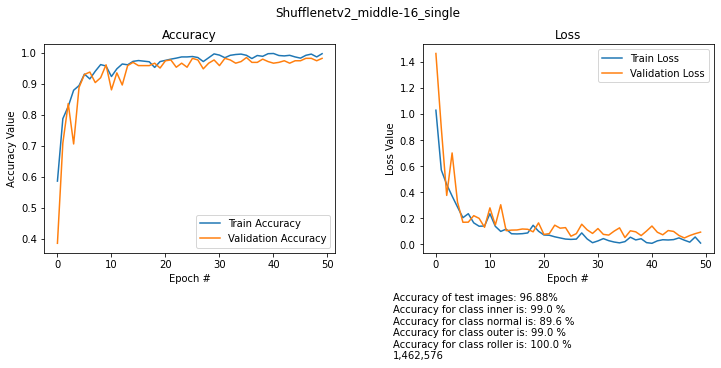

images/middle-16_single/train


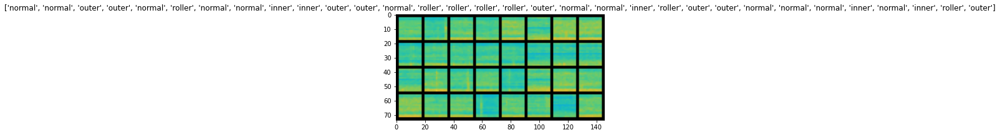

0.9791796207427979
0.6409335136413574
0.5132848620414734
0.5299820303916931
0.2567046880722046
0.22510504722595215
0.10420210659503937
0.2121410071849823
0.15521293878555298
0.2876248359680176
0.09799983352422714
0.1856183111667633
0.09924240410327911
0.09933125972747803
0.06769237667322159
0.07018047571182251
0.13275155425071716
0.0575539693236351
0.08745651692152023
0.06534314155578613
0.033252403140068054
0.050233613699674606
0.09701839089393616
0.031548015773296356
0.11537931859493256
0.10592697560787201
0.10720502585172653
0.04321809113025665
0.05681494623422623
0.036550186574459076
0.04545530676841736
0.04249436408281326
0.05537734180688858
0.06127382442355156
0.22139579057693481
0.09368732571601868
0.06256760656833649
0.2607753872871399
0.046382270753383636
0.058700110763311386
0.06662189960479736
0.05495309457182884
0.05470484495162964
0.05456814169883728
0.04161501303315163
0.03693491593003273
0.03220030292868614
0.045557864010334015
0.11348432302474976
0.044711701571941376
Fi

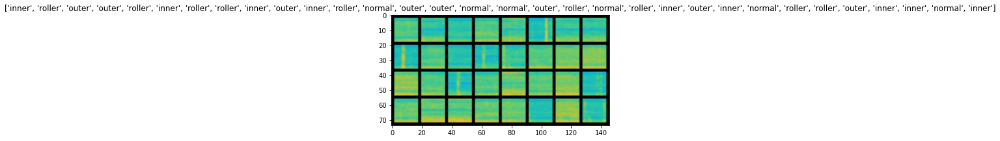

1.1141703128814697
0.7848633527755737
0.38001084327697754
0.5037431716918945
0.2363927811384201
0.26227837800979614
0.2074141800403595
0.19990065693855286
0.5808936953544617
0.20564737915992737
0.17863169312477112
0.13578173518180847
0.08351432532072067
0.17635378241539001
0.38862407207489014
0.11963380873203278
0.05135643482208252
0.05698250234127045
0.0730370432138443
0.43998417258262634
0.18309959769248962
0.0841234028339386
0.09232796728610992
0.13853400945663452
0.06001094728708267
0.03197326138615608
0.06712129712104797
0.22879445552825928
0.08675502985715866
0.05588286742568016
0.2714083790779114
0.04816597327589989
0.03295309096574783
0.12158244848251343
0.12876521050930023
0.03460399806499481
0.04618266224861145
0.07556605339050293
0.04719933122396469
0.05348772555589676
0.09405282139778137
0.07393723726272583
0.23944292962551117
0.05805714428424835
0.07860268652439117
0.06431129574775696
0.02767324075102806
0.024502230808138847
0.03545841574668884
0.027480684220790863
Finish 

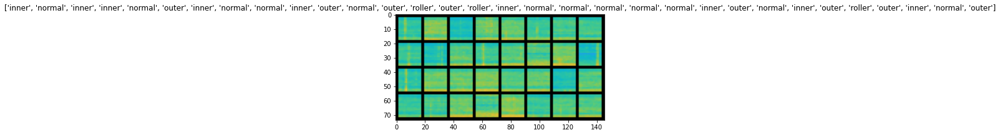

1.1183397769927979
0.454586923122406
0.8552369475364685
0.3213525414466858
0.8029886484146118
0.42691725492477417
0.5017696619033813
0.4030228555202484
0.3425256609916687
0.5267412066459656
0.15574359893798828
0.16871580481529236
0.13538441061973572
0.1784786432981491
0.16407208144664764
0.19566796720027924
0.157683327794075
0.22250984609127045
0.1545383334159851
0.12109038233757019
0.207529217004776
0.17649158835411072
0.15041285753250122
0.07934030890464783
0.08410091698169708
0.13057342171669006
0.2352977693080902
0.43614423274993896
0.1135859340429306
0.19949287176132202
0.0973120927810669
0.10499830543994904
0.06288496404886246
0.10149820894002914
0.06225191056728363
0.05514281988143921
0.2623633146286011
0.10061690211296082
0.04901006817817688
0.1486615240573883
0.06516221165657043
0.10063968598842621
0.14491571485996246
0.03163716942071915
0.07990586757659912
0.07415711879730225
0.026598861441016197
0.04846394062042236
0.046951599419116974
0.03671159967780113
Finish training!
Ac

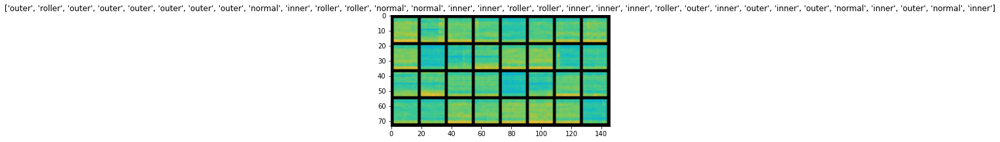

1.3127045631408691
0.668853223323822
0.36845558881759644
0.4381485879421234
0.2044381946325302
0.129291832447052
0.12538622319698334
0.16737553477287292
0.19670546054840088
0.20907938480377197
0.15110164880752563
0.16760855913162231
0.11888022720813751
0.13552334904670715
0.09100490063428879
0.06505852937698364
0.07404924184083939
0.09258268773555756
0.07846232503652573
0.07621244341135025
0.0791839063167572
0.0849878340959549
0.08163776993751526
0.05729270726442337
0.047015219926834106
0.036947526037693024
0.07216624170541763
0.04316679760813713
0.05788110941648483
0.0343443937599659
0.043143369257450104
0.05873797461390495
0.11503790318965912
0.05446048825979233
0.036070384085178375
0.040799420326948166
0.061004966497421265
0.03261028230190277
0.04122226685285568
0.12328442186117172
0.031341344118118286
0.0491020493209362
0.026931032538414
0.04543519765138626
0.04948386177420616
0.024712679907679558
0.029046595096588135
0.022074460983276367
0.024581626057624817
0.04577907547354698
Fi

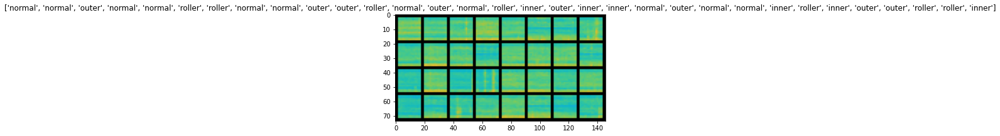

0.8641901016235352
1.1326783895492554
0.38556596636772156
0.3512711226940155
0.2727102041244507
0.36429595947265625
0.30324864387512207
0.13184300065040588
0.12346689403057098
0.14159569144248962
0.20420968532562256
0.11610393226146698
0.2028786838054657
0.09461498260498047
0.06413208693265915
0.14214879274368286
0.1360594928264618
0.091606006026268
0.10601948201656342
0.08696223795413971
0.10195979475975037
0.07357612997293472
0.19200539588928223
0.07920551300048828
0.04575277864933014
0.08808758109807968
0.07049544900655746
0.06887279450893402
0.09163713455200195
0.10211735963821411
0.13648125529289246
0.04743926227092743
0.053122591227293015
0.07259015738964081
0.04239030182361603
0.02946621924638748
0.1914481520652771
0.09835146367549896
0.07317671179771423
0.10664837062358856
0.032275088131427765
0.04469871148467064
0.10230927169322968
0.09010873734951019
0.07223071157932281
0.07625734061002731
0.1231389194726944
0.03233473747968674
0.11145099252462387
0.09361329674720764
Finish t

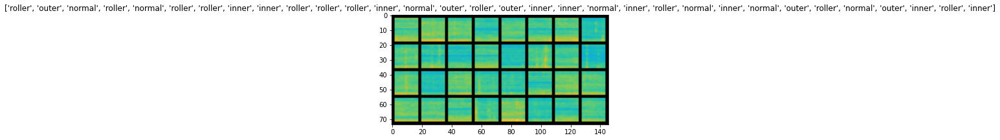

1.6575454473495483
0.880358099937439
0.6027597188949585
0.4503787159919739
0.2604040205478668
0.2801280617713928
0.3508007228374481
0.24545809626579285
0.24076436460018158
0.19741177558898926
0.14637042582035065
0.3235304057598114
0.10186731070280075
0.11010725796222687
0.1906372755765915
0.08824197947978973
0.2158060371875763
0.07158928364515305
0.16176389157772064
0.11765006184577942
0.06121816858649254
0.07816430926322937
0.08204592764377594
0.043120112270116806
0.11124484986066818
0.06792034208774567
0.1612994521856308
0.06677618622779846
0.08641473948955536
0.07640039920806885
0.07885460555553436
0.05161845311522484
0.0391174778342247
0.07355947047472
0.06705799698829651
0.14255692064762115
0.06537716090679169
0.08080124855041504
0.12688541412353516
0.06799229979515076
0.032050516456365585
0.07756836712360382
0.03620561584830284
0.06918089836835861
0.08250899612903595
0.049477718770504
0.03819175809621811
0.03904912620782852
0.028682000935077667
0.028103794902563095
Finish trainin

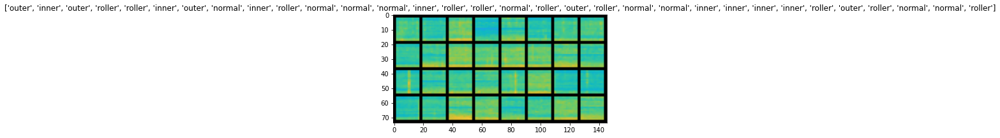

1.752449870109558
0.4954982399940491
0.3792569041252136
0.3920360505580902
0.3948684632778168
0.37188538908958435
0.31492748856544495
0.33489295840263367
0.2685789465904236
0.3068547248840332
0.15126797556877136
0.23146969079971313
0.13364510238170624
0.17289678752422333
0.14280736446380615
0.10985921323299408
0.11325214803218842
0.08898647129535675
0.17393027245998383
0.08055726438760757
0.08271355926990509
0.1102343425154686
0.2091275453567505
0.06699761748313904
0.06259489059448242
0.03582698106765747
0.1013002023100853
0.27225416898727417
0.08564507216215134
0.07084013521671295
0.044679805636405945
0.05364517867565155
0.16461236774921417
0.06807348877191544
0.05367110297083855
0.4509885311126709
0.043894004076719284
0.05344593524932861
0.05025738477706909
0.08504742383956909
0.24658221006393433
0.044611673802137375
0.06233799457550049
0.06329174339771271
0.045740045607089996
0.13827890157699585
0.05804884061217308
0.037063390016555786
0.028072349727153778
0.04855236038565636
Finish

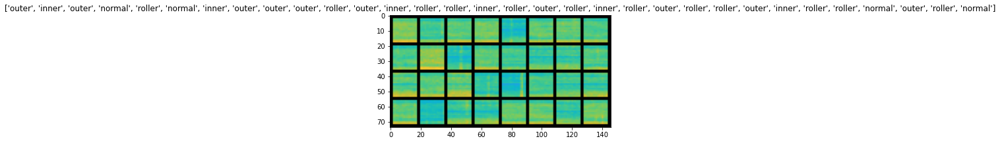

1.6985359191894531
0.41741546988487244
0.7440938353538513
0.34549832344055176
0.21725371479988098
0.1941564977169037
0.141013041138649
0.13084468245506287
0.2917087972164154
0.1508326530456543
0.17987701296806335
0.2718070447444916
0.15561968088150024
0.24104884266853333
0.1397368162870407
0.16362053155899048
0.10725798457860947
0.10263489186763763
0.15631866455078125
0.13810138404369354
0.08970608562231064
0.1254548728466034
0.10059894621372223
0.199000284075737
0.21421436965465546
0.051577843725681305
0.44309529662132263
0.08119121938943863
0.06576675176620483
0.10570134222507477
0.22960957884788513
0.1132020503282547
0.07996070384979248
0.04420517012476921
0.12800604104995728
0.19867539405822754
0.12738052010536194
0.11791892349720001
0.0863908976316452
0.15948082506656647
0.09252627938985825
0.07937946915626526
0.29333335161209106
0.14785504341125488
0.12032066285610199
0.05935300141572952
0.05551668256521225
0.0772823765873909
0.06056102737784386
0.05475784093141556
Finish trainin

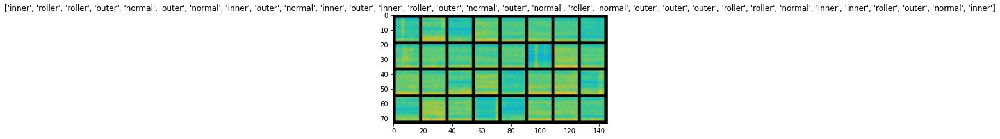

1.050215482711792
0.4722498655319214
0.5833500623703003
0.4564252495765686
0.29797476530075073
0.16480325162410736
0.2815662622451782
0.25154203176498413
0.23998436331748962
0.14408254623413086
0.10042329877614975
0.2240181863307953
0.14991703629493713
0.18983803689479828
0.09439180791378021
0.07583403587341309
0.08197508752346039
0.12264963239431381
0.16143068671226501
0.121830515563488
0.059997424483299255
0.10844384133815765
0.15563780069351196
0.08854006975889206
0.045740704983472824
0.03144829720258713
0.1106656938791275
0.06166341155767441
0.03488597273826599
0.08972673863172531
0.1427690088748932
0.4630936086177826
0.15035498142242432
0.15956178307533264
0.11563628911972046
0.02721552923321724
0.037685249000787735
0.06230322644114494
0.059714607894420624
0.040038153529167175
0.17723479866981506
0.07802145183086395
0.12366290390491486
0.15002302825450897
0.04757315665483475
0.04361405968666077
0.03159181401133537
0.021145228296518326
0.06439656019210815
0.10813339054584503
Finish

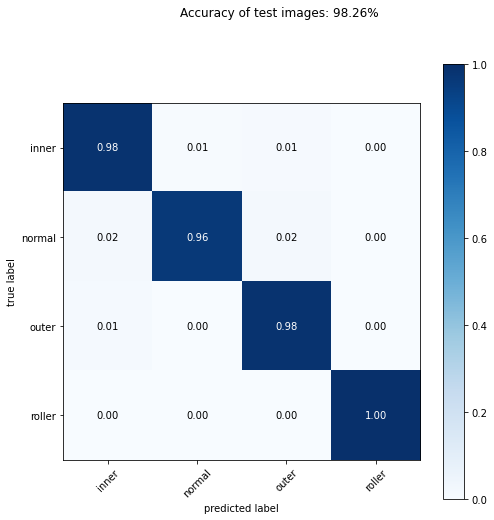

middle-32_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.003 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 6.030% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 5.427% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.001 GMac, 18.537% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 6.423% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.958% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(

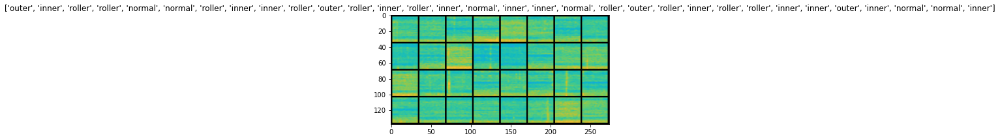

0.6525217294692993
0.3139660358428955
0.8843977451324463
0.19973008334636688
0.05781666189432144
0.42367637157440186
0.028297163546085358
0.25792646408081055
0.027582399547100067
0.023913651704788208
0.06179496645927429
0.008812157437205315
0.03470902517437935
0.22811955213546753
0.07018525898456573
0.0032492438331246376
0.026072591543197632
0.00531831756234169
0.10491105169057846
0.011813289485871792
0.0036184496711939573
0.04009286314249039
0.03927754983305931
0.007572352420538664
0.0076588224619627
0.006860283203423023
0.007523325737565756
0.1844957172870636
0.0030894845258444548
0.010851170867681503
0.014683103188872337
0.011993045918643475
0.014057492837309837
0.013672079890966415
0.29501646757125854
0.014946973882615566
0.0037647837307304144
0.008926679380238056
0.005934164859354496
0.005956685170531273
0.0058439034037292
0.017445281147956848
0.11097712814807892
0.006012815050780773
0.05760760232806206
0.007310881279408932
0.009386822581291199
0.016440199688076973
0.0155723057687

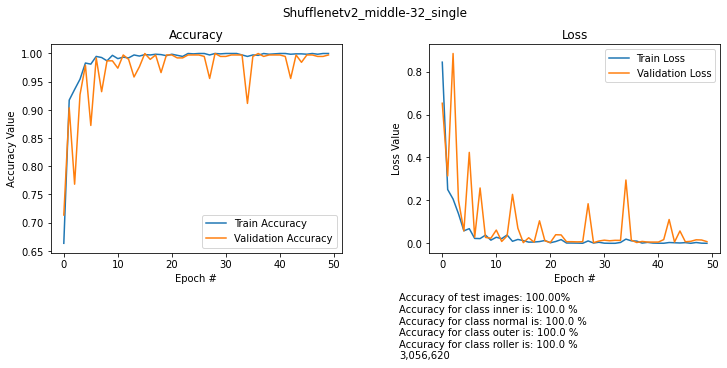

images/middle-32_single/train


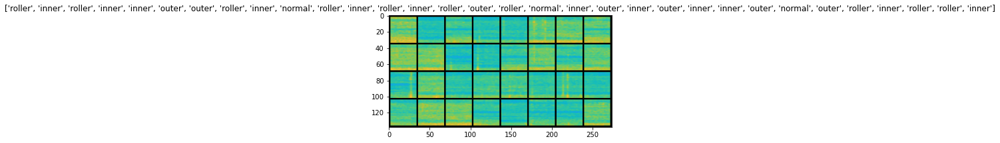

0.5513488054275513
0.1373542994260788
0.23294703662395477
0.1260586977005005
0.19650661945343018
0.13889265060424805
0.22145256400108337
0.13145916163921356
0.20372024178504944
0.04056517407298088
0.01512737013399601
0.06767348945140839
0.020342092961072922
0.03248827904462814
0.05316741392016411
0.1460999846458435
0.1663009524345398
0.02663799747824669
0.029526755213737488
0.013803105801343918
0.010823162272572517
0.061335787177085876
0.04832128807902336
0.12280204892158508
0.039217352867126465
0.036573439836502075
0.046320002526044846
0.08704563230276108
0.011308794841170311
0.012050796300172806
0.037442322820425034
0.030536465346813202
0.01921628974378109
0.009761706925928593
0.025442510843276978
0.05813875421881676
0.02797510102391243
0.004840071313083172
0.005730952136218548
0.020768247544765472
0.013179070316255093
0.008788907900452614
0.006669812835752964
0.013388032093644142
0.009863382205367088
0.05608263611793518
0.021616509184241295
0.004453061614185572
0.004838693421334028


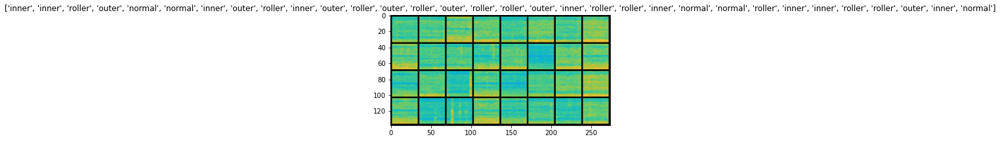

0.4572621285915375
0.14650703966617584
0.05582752451300621
0.1201106607913971
0.030648192390799522
0.03879976272583008
0.22878502309322357
0.00948801264166832
0.14213475584983826
0.055393438786268234
0.022245898842811584
0.032632626593112946
0.0072918664664030075
0.002719614654779434
0.0032876485493034124
0.0017591931391507387
0.013692083768546581
0.016326243057847023
0.001221453188918531
0.003453124314546585
0.003843187354505062
0.009096604771912098
0.005762960761785507
0.0013778896536678076
0.0011655199341475964
0.0008134927484206855
0.006009848788380623
0.0013961296062916517
0.0008811128791421652
0.0005962650757282972
0.0005399117944762111
0.0005878337542526424
0.00042157305870205164
0.00033954548416659236
0.001095468644052744
0.0014366389950737357
0.0017313942080363631
0.0005507583264261484
0.012468015775084496
0.00022610870655626059
0.046120043843984604
0.022408384829759598
0.002819986082613468
0.0029185526072978973
0.004825121257454157
0.009126584976911545
0.0031028776429593563
0

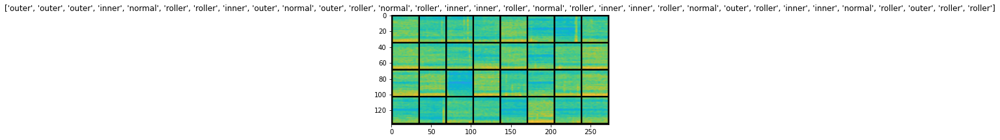

0.8514489531517029
0.5646181106567383
0.20032191276550293
0.11772297322750092
0.07204161584377289
0.18301402032375336
0.07716071605682373
0.1060393750667572
0.019181519746780396
0.037952959537506104
0.018447399139404297
0.039779942482709885
0.025917453691363335
0.038298655301332474
0.024173490703105927
0.059441208839416504
0.08476536720991135
0.016430631279945374
0.065265953540802
0.016059227287769318
0.0033702149521559477
0.10043131560087204
0.0023367535322904587
0.005204617977142334
0.014062556438148022
0.08984962105751038
0.011068006977438927
0.011578178964555264
0.0028925430960953236
0.029427364468574524
0.006642322521656752
0.4780828654766083
0.009337171912193298
0.016400428488850594
0.012907234951853752
0.012717473320662975
0.014633185230195522
0.016620712354779243
0.014811966568231583
0.09176614880561829
0.01716339960694313
0.004505817778408527
0.0015615189913660288
0.003549616551026702
0.0046450188383460045
0.001315535744652152
0.0006614750018343329
0.0006323282141238451
0.0005

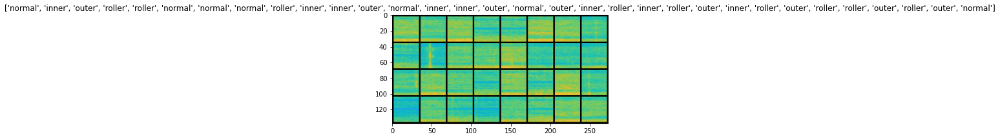

0.9783711433410645
0.25365376472473145
0.13491857051849365
0.1746138334274292
0.05644768476486206
0.03715686500072479
0.020286550745368004
0.11550652235746384
0.009102487936615944
0.039725661277770996
0.006830850150436163
0.08299356698989868
0.06840591132640839
0.05313902720808983
0.02418622188270092
0.020657621324062347
0.011029468849301338
0.008198977448046207
0.00463654100894928
0.005041838623583317
0.008683167397975922
0.008208557963371277
0.0057313889265060425
0.00944455061107874
0.32915839552879333
0.05198698863387108
0.004357206169515848
0.010546145960688591
0.07459218800067902
0.018116451799869537
0.028117068111896515
0.022549448534846306
0.008369749411940575
0.017888013273477554
0.03325936198234558
0.005926857702434063
0.01882956549525261
0.00787549838423729
0.043509166687726974
0.026673225685954094
0.0186374019831419
0.05708993598818779
0.02170472964644432
0.05239724740386009
0.0303436741232872
0.020480725914239883
0.006658757105469704
0.03253724053502083
0.010910609737038612

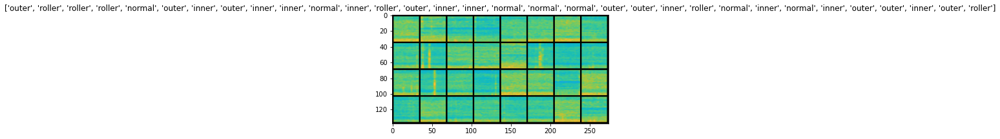

1.3401530981063843
0.7788378596305847
0.5794980525970459
0.332334041595459
0.15044087171554565
0.07733535766601562
0.04145848751068115
0.08085821568965912
0.06271263211965561
0.02674095332622528
0.0740107074379921
0.1245080828666687
0.013853942975401878
0.05707615241408348
0.03806624561548233
0.05668546259403229
0.16625598073005676
0.058966077864170074
0.021186215803027153
0.017344465479254723
0.02368643693625927
0.00906095840036869
0.008578457869589329
0.004972328431904316
0.004982626996934414
0.005815367680042982
0.002384057966992259
0.0024833919014781713
0.0025835782289505005
0.0025159593205899
0.0029754340648651123
0.005352477543056011
0.003371946979314089
0.0041101849637925625
0.0014999652048572898
0.03089684620499611
0.025014366954565048
0.017960842698812485
0.011854792945086956
0.007915040478110313
0.008946308866143227
0.008977706544101238
0.0047888676635921
0.0030693011358380318
0.0035297218710184097
0.020502295345067978
0.007905891165137291
0.004640135448426008
0.0068378346040

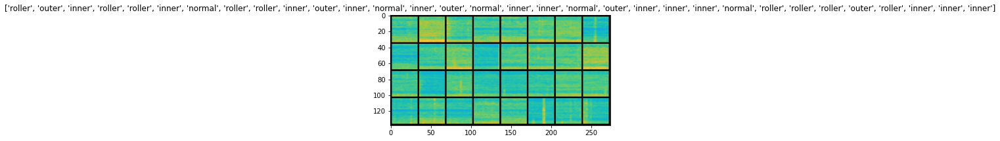

1.3290929794311523
0.8152968287467957
0.10117602348327637
0.14213353395462036
0.17453157901763916
0.23005668818950653
0.08632102608680725
0.03908098116517067
0.0496155247092247
0.057776957750320435
0.11948268860578537
0.07617980986833572
0.058923132717609406
0.045403264462947845
0.042001716792583466
0.019697370007634163
0.027386803179979324
0.027657877653837204
0.03575523942708969
0.027643844485282898
0.017250433564186096
0.047724779695272446
0.024307478219270706
0.09333356469869614
0.04501226171851158
0.039051253348588943
0.059637948870658875
0.09426257014274597
0.06355419754981995
0.04638214409351349
0.08094801008701324
0.04922930523753166
0.03251037746667862
0.0351126566529274
0.03099903091788292
0.030859632417559624
0.12745577096939087
0.053017765283584595
0.05140307545661926
0.043472059071063995
0.05148058757185936
0.03689396381378174
0.02414359524846077
0.024376295506954193
0.04651458188891411
0.023222316056489944
0.029556822031736374
0.025656789541244507
0.024781910702586174
0.0

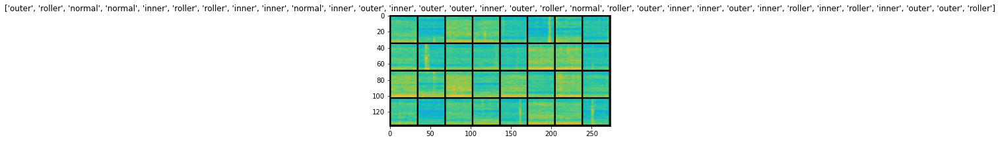

1.1479066610336304
0.42626962065696716
0.10523514449596405
0.17538946866989136
0.1622362732887268
0.11499803513288498
0.1434219926595688
0.10106845945119858
0.08165307343006134
0.07141062617301941
0.033295921981334686
0.04255107790231705
0.03610953688621521
0.041519299149513245
0.03405481576919556
0.01226453110575676
0.010910216718912125
0.11087223887443542
0.07074333727359772
0.02070365473628044
0.02677997015416622
0.04206746816635132
0.018091822043061256
0.010503558441996574
0.00881917029619217
0.011119717732071877
0.0144862812012434
0.005722799338400364
0.009446105919778347
0.010086351074278355
0.013352185487747192
0.03256306052207947
0.012253228574991226
0.01134860422462225
0.013111360371112823
0.01077520102262497
0.009879088960587978
0.009717416949570179
0.011297419667243958
0.009433946572244167
0.010298479348421097
0.010206181555986404
0.009794618934392929
0.009866739623248577
0.010124929249286652
0.019404085353016853
0.008797932416200638
0.003612966276705265
0.011951091699302197

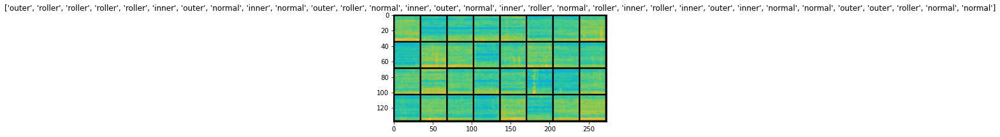

0.5338713526725769
0.5197266936302185
0.03843490779399872
0.06872177869081497
0.027704529464244843
0.1984935849905014
0.06352594494819641
0.15624606609344482
0.020705558359622955
0.018093956634402275
0.0064933085814118385
0.019105661660432816
0.026598138734698296
0.02414616197347641
0.023388870060443878
0.016078129410743713
0.025079553946852684
0.017832845449447632
0.010815590620040894
0.005124406889081001
0.006816111505031586
0.017502062022686005
0.007671757601201534
0.005214027129113674
0.03900619596242905
0.008979912847280502
0.0071294838562607765
0.0015931935049593449
0.0038542281836271286
0.005257246550172567
0.004915338940918446
0.0022152152378112078
0.006896862760186195
0.006842949893325567
0.011786006391048431
0.005158740095794201
0.0016539241187274456
0.015416565351188183
0.003725829068571329
0.0017841989174485207
0.0046327244490385056
0.003270310116931796
0.050381436944007874
0.010688835754990578
0.0027054641395807266
0.007605943363159895
0.0019028827082365751
0.0059134131297

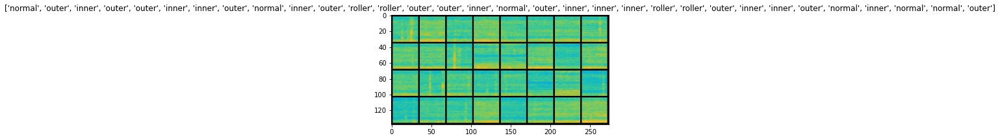

0.4909455478191376
0.5674858689308167
0.2258385419845581
0.03797031193971634
0.06303881108760834
0.051604874432086945
0.06399213522672653
0.023594750091433525
0.03746258467435837
0.01227625459432602
0.02548910491168499
0.012760922312736511
0.01401110552251339
0.009340395219624043
0.3111679255962372
0.009362880140542984
0.040223076939582825
0.01760883256793022
0.06670698523521423
0.020798705518245697
0.013207411393523216
0.004958387464284897
0.014915112406015396
0.010664308443665504
0.012346352450549603
0.12263450026512146
0.009717104956507683
0.01938370242714882
0.0038083780091255903
0.01923959329724312
0.0064140623435378075
0.005317146889865398
0.00781360361725092
0.0036161206662654877
0.005617734044790268
0.0031427897047251463
0.0032650609500706196
0.001378287561237812
0.001428839168511331
0.0020115775987505913
0.0011210392694920301
0.0015809251926839352
0.18117964267730713
0.02462584339082241
0.012446361593902111
0.006659229286015034
0.003724033711478114
0.003125359769910574
0.00931

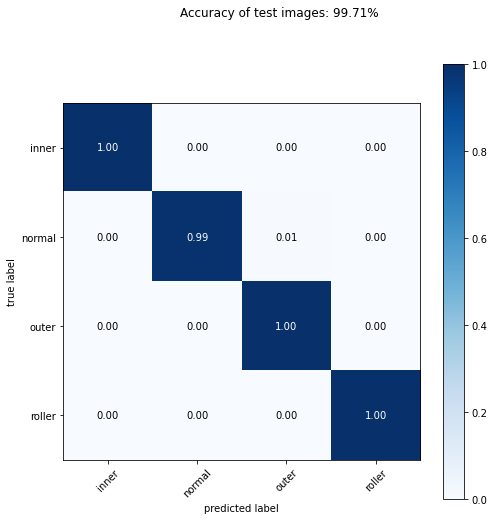

middle-64_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.012 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.001 GMac, 6.036% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.001 GMac, 5.433% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.002 GMac, 18.555% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.001 GMac, 6.429% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.959% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), pad

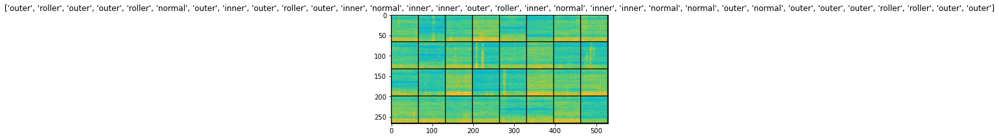

0.3504166603088379
0.027704108506441116
0.012937324121594429
0.0761926919221878
0.04991425201296806
0.0019606982823461294
0.025807645171880722
0.003048976883292198
0.015479372814297676
0.002324453555047512
0.0007611464243382215
0.0023114923387765884
0.0007299095741473138
0.00035143340937793255
0.00025945488596335053
0.05239865183830261
0.014256719499826431
0.0007597610238008201
0.00013858183228876442
0.00037752819480374455
0.0008067956077866256
0.0004604593268595636
0.00038038703496567905
0.0005753381992690265
0.00021071694209240377
0.0003331354819238186
0.00011794553574873134
0.0001803661580197513
0.004144445061683655
0.0003315035719424486
0.00030818962841294706
0.00011335865565342829
0.000304464774671942
8.523021824657917e-05
0.0001126348361140117
8.196078124456108e-05
5.0262089644093066e-05
9.226013207808137e-05
6.408653280232102e-05
6.473695975728333e-05
9.286763088312e-05
6.870325887575746e-05
0.001215837663039565
0.0007075080648064613
0.00019787636119872332
0.00022755649115424603

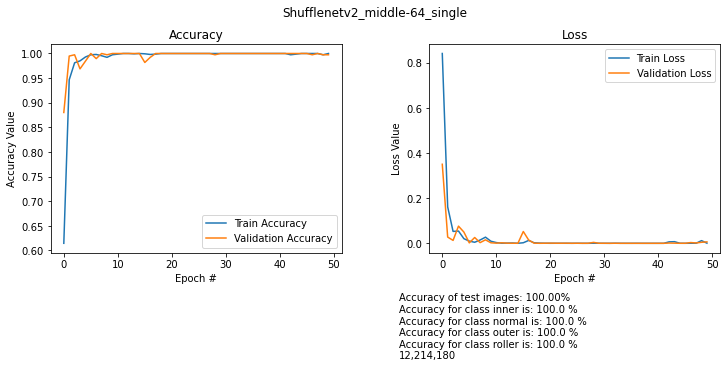

images/middle-64_single/train


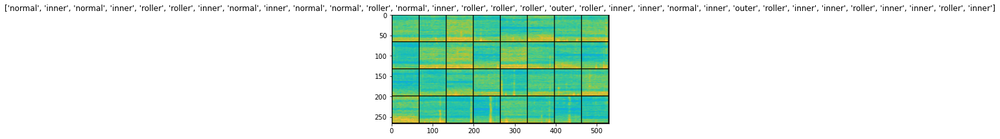

0.390356183052063
0.09293736517429352
0.04470282047986984
0.004279740620404482
0.008438372984528542
0.06832091510295868
0.08487831801176071
0.00047132265171967447
0.0007391428807750344
0.0005889103631488979
0.0004784117336384952
0.0003061879542656243
0.00039305369136855006
0.00044695052201859653
0.00014828961866442114
0.00027478730771690607
0.008626655675470829
0.001114505692385137
0.00021386085427366197
0.00020832082373090088
0.00019338079437147826
0.0003278416988905519
0.00019498686015140265
0.0001619356480659917
8.21523426566273e-05
8.891028119251132e-05
0.00010478087642695755
0.000100127057521604
6.330476026050746e-05
5.634286208078265e-05
6.349344039335847e-05
7.346910570049658e-05
4.3500109313754365e-05
3.640773502411321e-05
4.767119389725849e-05
3.3582742616999894e-05
2.934479562100023e-05
3.251328962505795e-05
2.9127259040251374e-05
2.304682129761204e-05
2.687959022296127e-05
8.65013716975227e-05
0.0017553268698975444
0.00047139250091277063
0.0002631086390465498
0.0111704794690

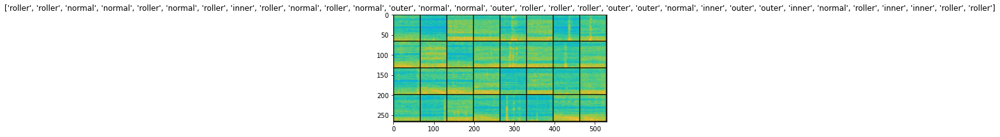

0.24308833479881287
0.03261963278055191
0.2896255850791931
0.10784222185611725
0.01943693310022354
0.0052753328345716
0.10836395621299744
0.03661710023880005
0.01651199534535408
0.05200287327170372
0.0210312157869339
0.04969942197203636
0.001018758281134069
0.0001929672434926033
0.00018737820209935308
0.00020825761021114886
0.00010691792704164982
0.004304472357034683
0.0001660309499129653
0.00012436957331374288
7.080945215420797e-05
0.0009277841309085488
0.0001329661754425615
0.00029594701481983066
7.854083378333598e-05
5.097002940601669e-05
0.04342985153198242
0.00011102164717158303
0.00022047763923183084
9.6868745458778e-05
0.0004411062109284103
5.724552829633467e-05
0.00015593590796925128
0.00012892711674794555
0.00038162825512699783
6.369652692228556e-05
4.108072607778013e-05
2.964828127005603e-05
3.0465085728792474e-05
4.007218740298413e-05
0.00023917968792375177
6.923046748852357e-05
6.404391024261713e-05
4.89454650960397e-05
5.274466093396768e-05
7.63052812544629e-05
4.651199560

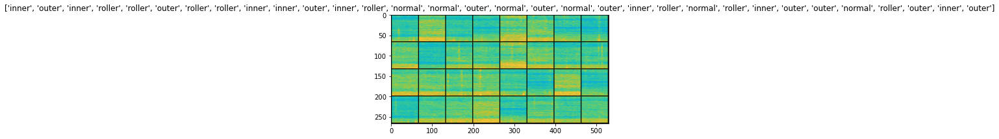

0.6774274110794067
0.24638646841049194
0.06160584092140198
0.00819447636604309
0.011430986225605011
0.049762144684791565
0.01579630933701992
0.052322134375572205
0.015094025991857052
0.014513926580548286
0.001304140780121088
0.29917776584625244
0.004649837967008352
0.0035579714458435774
0.0011640870943665504
0.001780584454536438
0.001889156410470605
0.0030269064009189606
0.0022453598212450743
0.0014754635049030185
0.0013238646788522601
0.00047604896826669574
0.00035269392537884414
0.0002899493556469679
0.0002679294266272336
0.010048151016235352
0.01013606134802103
0.009031066671013832
0.010044009424746037
0.00048591085942462087
0.0003859844000544399
0.00024731780285947025
0.00029166220338083804
0.010632311925292015
0.009078113362193108
0.0063635981641709805
0.0035123962443321943
0.00036375594208948314
0.06001829728484154
0.01746539957821369
0.016372762620449066
0.0034444069024175406
0.003970930818468332
0.005319381132721901
0.006403397303074598
0.0045591979287564754
0.00722547341138124

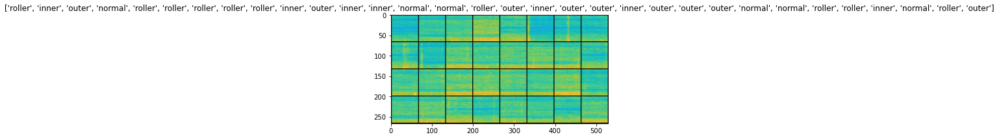

0.19618181884288788
0.18123579025268555
0.3233524560928345
0.0706385001540184
0.01147259958088398
0.0036373126786202192
0.005585663951933384
0.0022222569677978754
0.001135423663072288
0.005386744625866413
0.0005520888953469694
0.002510670805349946
0.0011411445448175073
0.009501988999545574
0.016864556819200516
0.005196475889533758
0.0045323860831558704
0.002301955595612526
0.01935524120926857
0.0012647084658965468
0.0015573145356029272
0.0006713543552905321
0.0018048108322545886
0.0005473601631820202
0.0003358276735525578
0.059414397925138474
0.014836004003882408
0.0013678687391802669
0.0013306917389854789
0.0007369349477812648
0.0006061564199626446
0.00043150619603693485
0.0004114339535590261
0.00023255503037944436
0.0003016059927176684
0.001141826156526804
0.00022684082796331495
0.0010018969187512994
0.0006941294996067882
0.00040335545781999826
0.00019836534920614213
0.0001351669052382931
0.00011670067760860547
0.00018060297588817775
9.357364615425467e-05
0.00013136309280525893
8.538

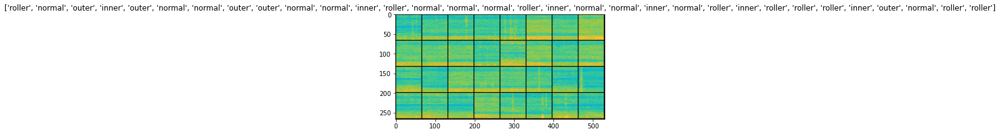

0.5226855278015137
0.049983419477939606
0.03631473705172539
0.013882022351026535
0.08217048645019531
0.009302190504968166
0.1291632205247879
0.019956860691308975
0.001645176555030048
0.0008087383466772735
0.000998770585283637
0.004663828294724226
0.002461876953020692
0.00110377196688205
0.01400494109839201
0.00029693703982047737
0.0035313027910888195
0.0026502148248255253
0.0007530839648097754
0.00015019590500742197
0.0001204529544338584
0.0001494427415309474
4.124879342271015e-05
0.0003061582683585584
0.00013001117622479796
0.0001483084779465571
0.009053071029484272
0.0017615999095141888
6.316514918580651e-05
5.199595034355298e-05
0.00016028148820623755
4.930511204292998e-05
0.00010396681318525225
4.4307329517323524e-05
4.262000584276393e-05
4.677959077525884e-05
3.635395842138678e-05
3.522899351082742e-05
4.070234717801213e-05
4.024540612590499e-05
3.3627235097810626e-05
4.976211494067684e-05
7.948229176690802e-05
7.333715620916337e-05
3.924411066691391e-05
0.0001006359452730976
7.16

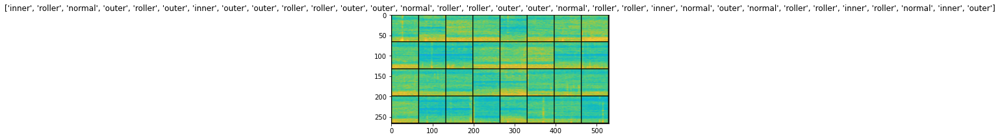

0.5732983350753784
0.13754215836524963
0.038547150790691376
0.05712093412876129
0.02243390679359436
0.025979330763220787
0.02198551967740059
0.05281875655055046
0.03469887375831604
0.013882244937121868
0.001741431187838316
0.006321958731859922
0.027643892914056778
0.002817766508087516
0.01810242049396038
0.05418609827756882
0.058357469737529755
0.007506366819143295
0.004549872595816851
0.009269877336919308
0.008317675441503525
0.004996761213988066
0.04740497097373009
0.022669240832328796
0.0019291690550744534
0.0013950200518593192
0.004888062831014395
0.004351082723587751
0.004428851418197155
0.00431465171277523
0.007872037589550018
0.0035759685561060905
0.0022551415022462606
0.002190100494772196
0.0009035618277266622
0.0027583399787545204
0.0018758159130811691
0.0016912290593609214
0.0014352531870827079
0.001730151940137148
0.001927295932546258
0.0012279709335416555
0.0016734841046854854
0.0008009031880646944
0.004858313128352165
0.007885311730206013
0.006093550007790327
0.00243048858

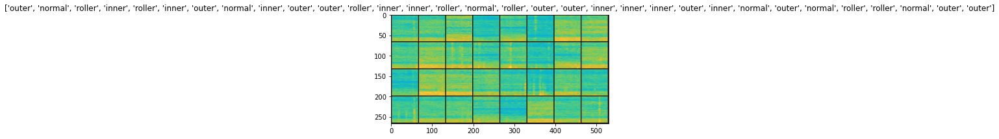

1.163057804107666
0.10831739753484726
0.02498454414308071
0.040494874119758606
0.07445038110017776
0.00746017973870039
0.0019514381419867277
0.0005357293412089348
0.0007397450972348452
0.0003854517708532512
0.00028689700411632657
0.00024492316879332066
0.000359670928446576
0.004182684235274792
0.0002537983236834407
0.0007090448634698987
0.00012166005035396665
0.000132445537019521
0.0001456059399060905
0.01604209467768669
0.0010899859480559826
0.0009128525271080434
0.0005638324073515832
0.000696691800840199
0.0035866310354322195
0.0013338264543563128
0.000610071700066328
0.0002048864698735997
0.00020909284648951143
0.00015242784866131842
0.00013018512981943786
0.00022108496341388673
0.0001233568473253399
0.00013299359125085175
0.00010552551248110831
9.908956417348236e-05
0.00019369632354937494
9.196401515509933e-05
8.219351002480835e-05
7.078057387843728e-05
9.533687261864543e-05
8.141748548951e-05
7.24149722373113e-05
6.67657150188461e-05
7.821395411156118e-05
0.00013431973638944328
0.

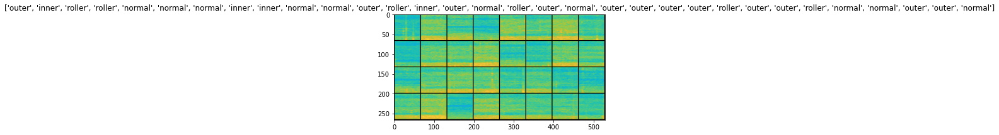

0.5049441456794739
0.04360955208539963
0.4051609933376312
0.08616354316473007
0.004056842066347599
0.00039415451465174556
0.0006722097168676555
0.004542275331914425
0.00020674719417002052
0.0001509964931756258
0.00011377187183825299
0.00010487243707757443
0.0001093998143915087
0.00010848759848158807
0.00016027671517804265
0.00010012945858761668
0.2073715329170227
0.0005567240295931697
0.0001665159361436963
0.0019288178300485015
0.0013661746634170413
0.0003183617955073714
0.0018190357368439436
0.00016037080786190927
0.00017894909251481295
0.001811408787034452
0.00029128690948709846
0.006200527772307396
0.00032193053630180657
0.0011416120687499642
0.00021726198610849679
0.0009144644718617201
0.0023855408653616905
0.0002460836840327829
0.00024027706240303814
0.00016393637633882463
0.00011133404041174799
7.509129500249401e-05
0.00011160093708895147
8.313147554872558e-05
5.3023653890704736e-05
4.656279634218663e-05
4.189299215795472e-05
4.9149326514452696e-05
6.119149475125596e-05
6.3736697

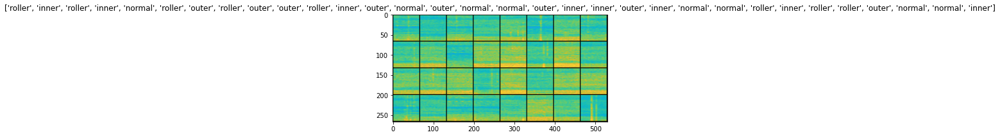

1.2489701509475708
0.08366399258375168
0.17925851047039032
0.029570192098617554
0.01402206253260374
0.03561361879110336
0.008956887759268284
0.0028479518368840218
0.0013769681099802256
0.0035048932768404484
0.0013401558389887214
0.001462852582335472
0.0009651994332671165
0.00041582545964047313
0.00024327616847585887
0.0002797223278321326
0.00019524051458574831
0.007712293416261673
0.0007323153549805284
0.0052927592769265175
0.0003928969381377101
0.012188578024506569
0.00486023211851716
0.028283167630434036
0.00013670840417034924
0.0002091087371809408
0.00013558352657128125
8.782085933489725e-05
7.295518298633397e-05
0.00014545612793881446
0.0011421804083511233
0.00016294763190671802
0.00010256543464493006
0.002085227519273758
0.0002370996808167547
0.00015585901564918458
0.00013435515575110912
9.326598956249654e-05
7.450611155945808e-05
9.243116073776037e-05
5.8438781707081944e-05
5.710696859750897e-05
3.764141001738608e-05
5.606362537946552e-05
4.4113774492871016e-05
4.591607648762874e

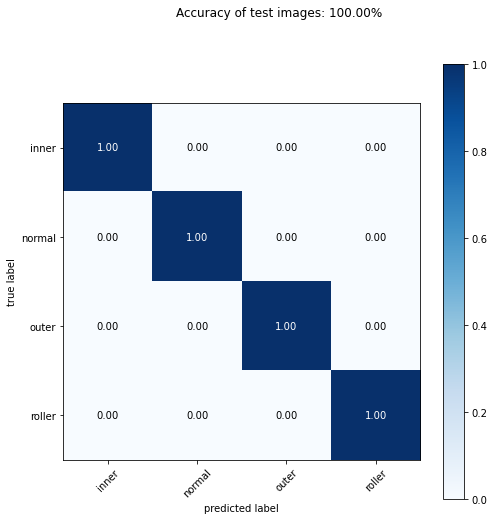

none-112_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.041 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.002 GMac, 5.524% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.002 GMac, 4.972% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.368% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.184% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.184% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.007 GMac, 16.981% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.002 GMac, 5.884% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.878% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.104% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padd

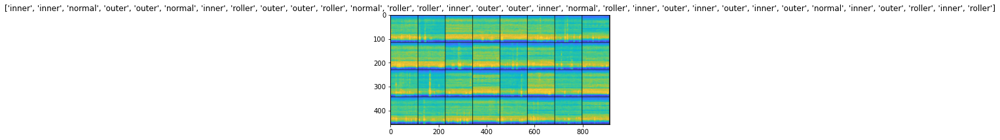

0.7943236827850342
0.09193579852581024
0.05501779168844223
0.000669596716761589
0.00044204058940522373
0.0317775160074234
0.0015507800271734595
0.0010956489713862538
0.0002691163099370897
0.00013419541937764734
4.7568377340212464e-05
0.00032681538141332567
3.420228313189e-05
3.388493132661097e-05
0.0012671563308686018
0.00027800537645816803
0.0002684404607862234
0.00011766266834456474
0.00013431320257950574
0.0001055384855135344
0.0007041950011625886
0.00021286266564857215
0.00014586187899112701
0.00011980634735664353
0.0001172295305877924
9.434742241865024e-05
8.898626401787624e-05
7.075021858327091e-05
8.063894347287714e-05
6.291177123785019e-05
0.00010844753705896437
0.00012868072371929884
4.43157296103891e-05
4.245430318405852e-05
4.682140570366755e-05
0.00010162067337660119
0.000910095521248877
0.00015741726383566856
4.400020043249242e-05
2.9580891350633465e-05
1.0494753951206803e-05
1.4337509128381498e-05
6.762286830053199e-06
9.706489436211996e-06
4.599432577379048e-05
1.6042096

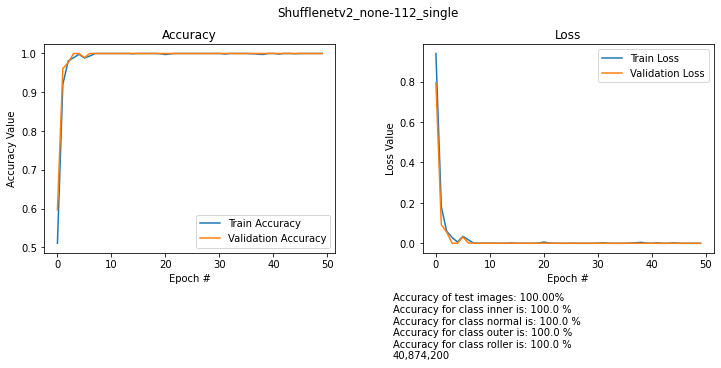

images/none-112_single/train


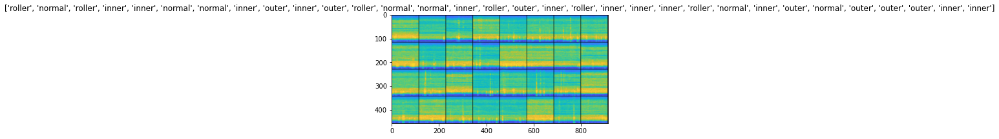

1.6536428928375244
0.029018109664320946
0.0011979261180385947
0.00580922607332468
0.024899739772081375
0.001571506611071527
0.00038195852539502084
0.00036208037636242807
0.0004581730754580349
0.00012475394760258496
0.06360526382923126
0.03139209747314453
8.971740317065269e-05
0.00013192431651987135
0.0001268285559490323
0.0002445621066726744
0.00016610858438070863
0.00020752139971591532
6.348871102090925e-05
0.00035135363577865064
0.001947640790604055
2.6998590328730643e-05
3.16111181746237e-05
4.337394784670323e-05
0.000429087522206828
9.704342664917931e-05
4.960268415743485e-05
3.63633589586243e-05
5.6181641411967576e-05
2.0366245735203847e-05
1.0072676559502725e-05
1.2695294572040439e-05
3.389114499441348e-05
1.7713327906676568e-05
1.6535028407815844e-05
8.872008038451895e-06
7.373174412350636e-06
8.22068705019774e-06
6.46814396532136e-06
5.194645382289309e-06
5.4963202273938805e-06
1.3500567547453102e-05
0.0005538204568438232
0.004467213526368141
6.30998401902616e-05
4.595456266542

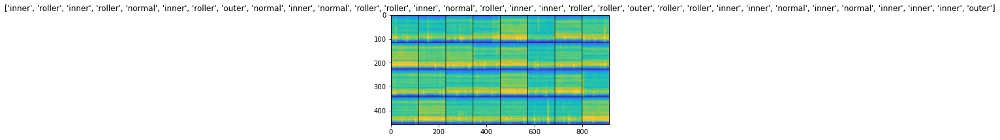

2.913511037826538
0.038221608847379684
0.034537095576524734
0.004798860754817724
0.0033744140528142452
0.0008553366642445326
0.00021114146511536092
0.00014581522555090487
0.00012936873827129602
0.00010857675806619227
0.0003380466368980706
0.00025806858320720494
0.0001313027460128069
0.028455369174480438
0.0008697336888872087
0.02317821979522705
0.008342290297150612
0.004129013046622276
0.002656675409525633
0.0007048614788800478
0.0007379378075711429
0.00017483692499808967
0.00014856492634862661
0.00018690006982069463
0.00016497369506396353
0.00020994417718611658
0.0004299379070289433
0.0002762906951829791
0.0002798509958665818
0.0001088732824428007
0.0002637453726492822
6.923000910319388e-05
6.277160719037056e-05
5.272642010822892e-05
5.102006980450824e-05
5.897385563002899e-05
6.593146827071905e-05
2.664297426235862e-05
4.164082565694116e-05
4.1735715058166534e-05
3.842056685243733e-05
2.693039641599171e-05
5.1877555961254984e-05
1.9592975149862468e-05
5.201670137466863e-05
2.33777373

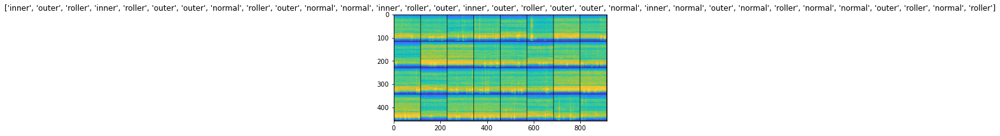

1.4529075622558594
0.11325161904096603
0.002703893929719925
0.023493697866797447
0.0001950053556356579
6.0620412114076316e-05
0.019915537908673286
5.4723066568840295e-05
0.0004424495855346322
9.98564573819749e-05
0.00024393746571149677
0.0008004256524145603
5.941800191067159e-05
3.274643313488923e-05
3.249242581659928e-05
0.00039326268597505987
7.465008820872754e-05
3.506768189254217e-05
1.7609620044822805e-05
1.4878205547574908e-05
1.2382146451273002e-05
1.535542105557397e-05
1.4301966984930914e-05
1.1202158930245787e-05
7.78664616518654e-06
8.357503247680143e-06
9.103161573875695e-06
1.1773906408052426e-05
9.909872460411862e-06
6.171770564833423e-06
6.923613455001032e-06
6.109957666922128e-06
4.8086749302456155e-06
7.792959877406247e-06
5.327993676473852e-06
5.926773155806586e-06
7.369336344709154e-06
4.535809239314403e-06
4.605342837749049e-06
4.356377758085728e-06
4.437366442289203e-06
4.031340267829364e-06
4.836578227696009e-06
4.369689122540876e-06
6.848025350336684e-06
3.4548706

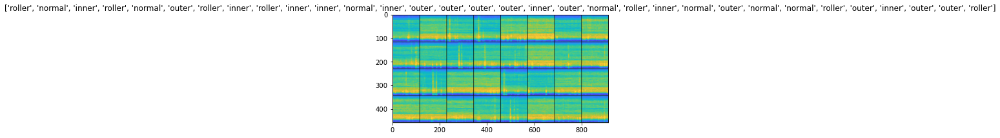

1.9909782409667969
0.0740898847579956
0.00961737148463726
0.0023215520195662975
0.005651249550282955
0.0020609628409147263
0.029589137062430382
0.0015608989633619785
0.004776443354785442
0.0015876207035034895
0.06456399708986282
0.0011998140253126621
0.0007853691349737346
0.006996053736656904
0.0003870694199576974
0.00017890898743644357
8.913341298466548e-05
8.67645358084701e-05
5.150037395651452e-05
7.754290709272027e-05
0.0008864852134138346
7.503097731387243e-05
6.397660763468593e-05
6.248042336665094e-05
0.00049358862452209
0.0001187929738080129
7.54809589125216e-05
7.958980859257281e-05
8.010531746549532e-05
0.00012968730879947543
5.818994759465568e-05
3.2186137104872614e-05
0.00010632911289576441
2.27394157263916e-05
5.0325088523095474e-05
1.931329461513087e-05
1.4651828678324819e-05
1.254072594747413e-05
1.189405065815663e-05
1.1101103154942393e-05
8.065813744906336e-06
9.278342986362986e-06
7.982372153492179e-06
7.256283424794674e-06
9.887622582027689e-06
6.326875336526427e-06


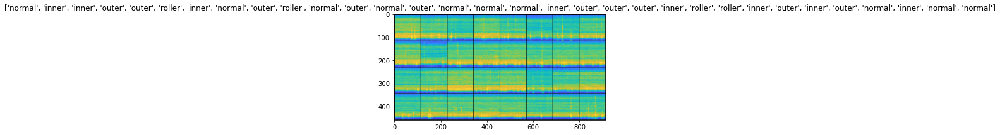

2.423285484313965
0.3498683571815491
0.005395022686570883
0.0022503193467855453
0.005162272602319717
0.007295103743672371
0.01346573792397976
0.0006758979870937765
0.00031796254916116595
0.0004923082306049764
0.0004148127627559006
0.00042016850784420967
0.00033114137477241457
0.00023429820430465043
0.00018817790260072798
5.1806429837597534e-05
0.0005494418437592685
0.0015984097262844443
0.013294230215251446
0.03378426283597946
0.003020515199750662
0.002386521315202117
0.00018841451674234122
0.00010808836668729782
5.558514385484159e-05
4.499503847910091e-05
4.7354198613902554e-05
4.054768942296505e-05
3.481991006992757e-05
3.2483087125001475e-05
2.891737676691264e-05
2.3801067072781734e-05
2.022332773776725e-05
1.7125399608630687e-05
1.749283546814695e-05
1.7551987184560858e-05
1.5743304174975492e-05
1.4121569620328955e-05
1.0586842108750716e-05
1.449506453354843e-05
1.1098614777438343e-05
1.5379684555227868e-05
8.541876923118252e-06
9.165243682218716e-06
9.057781426236033e-06
7.5944471

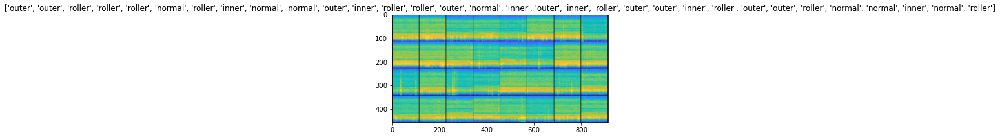

1.2846567630767822
0.1305834949016571
0.021469784900546074
0.06999868899583817
0.02283051609992981
0.14074623584747314
0.04399069771170616
0.0008184906328096986
0.004925730638206005
0.002362617291510105
0.0003869516949634999
0.0008198340656235814
0.0016980350483208895
0.0006086449138820171
0.002060292288661003
0.0006649987772107124
0.0006867998163215816
0.0021152091212570667
0.0006023681489750743
0.0001868982653832063
0.00030193888233043253
0.0013838582672178745
0.00015857898688409477
0.0016674529761075974
0.0001428009127266705
0.00013691012281924486
0.00013754713290836662
0.000213022023672238
0.000601396372076124
0.00029822177020832896
0.00016570871230214834
0.00011360740609234199
0.0001319351140409708
7.382826879620552e-05
0.0002468571765348315
4.140665987506509e-05
6.291807221714407e-05
0.00013012468116357923
5.871927714906633e-05
0.00012443448940757662
0.00015563225315418094
4.269115743227303e-05
0.020448459312319756
0.012433398514986038
0.014209724962711334
0.019122259691357613
0.

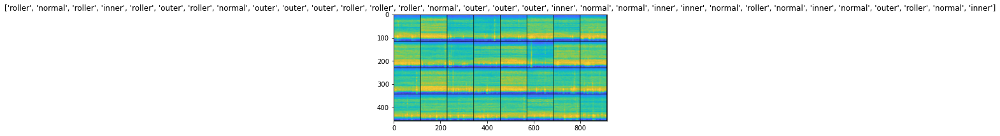

4.524108409881592
0.4209124743938446
0.012941903434693813
0.022978026419878006
0.015300544910132885
0.002301326021552086
0.003126487834379077
0.007680568844079971
0.00331864133477211
0.0010686542373150587
0.000677703064866364
0.0003601521602831781
0.0003716919745784253
0.0002530831843614578
0.0002362896193517372
0.00019510106358211488
0.0003868374624289572
0.0002636315766721964
0.0004247825709171593
0.00028471549740061164
0.00011205055488971993
9.71819827100262e-05
0.0001821578771341592
0.00021773285698145628
9.420896822120994e-05
0.0002380115183768794
0.00019171304302290082
3.981765257776715e-05
3.269998705945909e-05
2.8493885110947303e-05
3.4306114685023203e-05
2.9580987757071853e-05
3.0325527404784225e-05
2.68065050477162e-05
3.00407027680194e-05
3.2912848837440833e-05
2.710835360630881e-05
3.0294424504972994e-05
3.208746784366667e-05
3.4098025935236365e-05
2.8109896447858773e-05
3.25690270983614e-05
2.6416579203214496e-05
4.6262925025075674e-05
3.1534567824564874e-05
3.224221291020

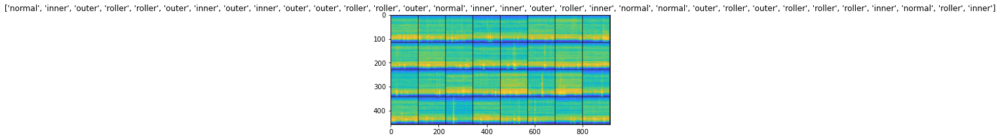

0.44567662477493286
3.157048225402832
0.39712604880332947
0.05510738492012024
0.0044249119237065315
0.0003768440510611981
9.211335418513045e-05
7.450309203704819e-05
0.00018868930055759847
0.020980343222618103
0.0005399746005423367
0.01661120355129242
0.000288729730527848
6.184194353409111e-05
4.131266541662626e-05
0.001718886662274599
0.0013147813733667135
0.000517270527780056
9.58826276473701e-05
6.466171180363744e-05
7.013048161752522e-05
0.0010845622746273875
3.316667425679043e-05
2.473273161740508e-05
2.4527280402253382e-05
1.7646649212110788e-05
1.8363438357482664e-05
1.4610721336794086e-05
1.606317891855724e-05
1.1170786820002832e-05
1.473326119594276e-05
1.4554028894053772e-05
1.1977956091868691e-05
1.2366769624350127e-05
9.897345080389641e-06
9.999595931731164e-06
6.291274075920228e-06
8.293473001685925e-06
1.0098811799252871e-05
8.970405360742006e-06
8.973876902018674e-06
6.633928933297284e-06
7.871723937569186e-06
6.8788876887992956e-06
6.287563792284345e-06
6.25589927949477

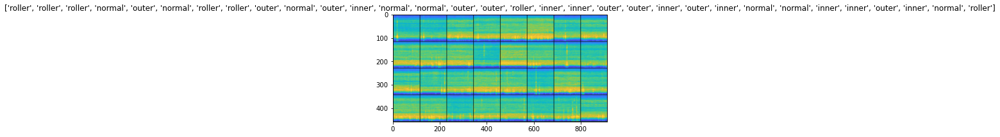

0.9058575630187988
0.04520749673247337
0.07734091579914093
0.0006864039460197091
0.002163003431633115
0.007738967891782522
0.00026071048341691494
0.00028856919379904866
0.0015449190977960825
0.001393524231389165
0.0020738206803798676
0.00010044345253845677
9.277499339077622e-05
0.23088400065898895
0.006449297070503235
0.0001516446063760668
0.0014636206906288862
0.0011738999746739864
0.00023026089183986187
0.0013996552443131804
2.076275814033579e-05
1.1558537153177895e-05
1.2223131307109725e-05
0.0003720315871760249
3.401861613383517e-05
2.2789374270359986e-05
1.3551289157476276e-05
1.2537521797639783e-05
1.161749787570443e-05
9.923658581101336e-06
5.715657152904896e-06
1.3485436284099706e-05
1.042805797624169e-05
2.456071160850115e-05
0.00033506035106256604
8.134669769788161e-06
1.0913745427387767e-05
7.155546882131603e-06
8.423930921708234e-06
6.3198694988386706e-06
5.084175427327864e-06
5.480398613144644e-06
8.155864634318277e-06
7.342861408687895e-06
5.753400728281122e-06
5.05255411

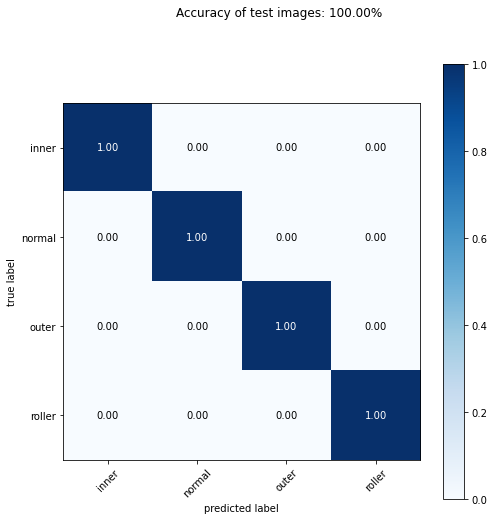

none-16_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.001 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 3.151% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 2.836% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.210% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.0 GMac, 9.685% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 3.356% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.500% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.059% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1)

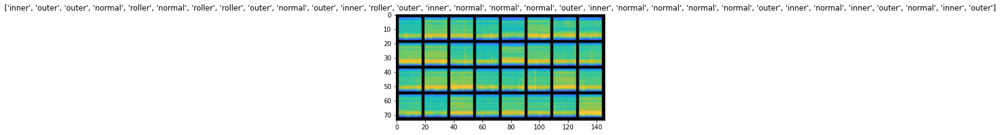

0.9643354415893555
0.4994487166404724
0.23496997356414795
0.19996985793113708
0.1767827719449997
0.11881080269813538
0.12448778748512268
0.13734936714172363
0.07759805023670197
0.06352835148572922
0.05813154578208923
0.04206587374210358
0.059574395418167114
0.03445509821176529
0.05497310683131218
0.0970631092786789
0.030794424936175346
0.159592404961586
0.026759225875139236
0.04841550812125206
0.0544852614402771
0.09252666682004929
0.05535053834319115
0.020986488088965416
0.023317648097872734
0.02045992761850357
0.01143471710383892
0.020660920068621635
0.030734874308109283
0.05525612458586693
0.005526083987206221
0.03427077829837799
0.03477223962545395
0.024972032755613327
0.016666043549776077
0.00857112742960453
0.014878934249281883
0.005929931066930294
0.039301615208387375
0.019432153552770615
0.01355553325265646
0.004526229575276375
0.003394434927031398
0.0025762636214494705
0.011217799037694931
0.0007065301761031151
0.004886379465460777
0.014759795740246773
0.001349521684460342
0.0

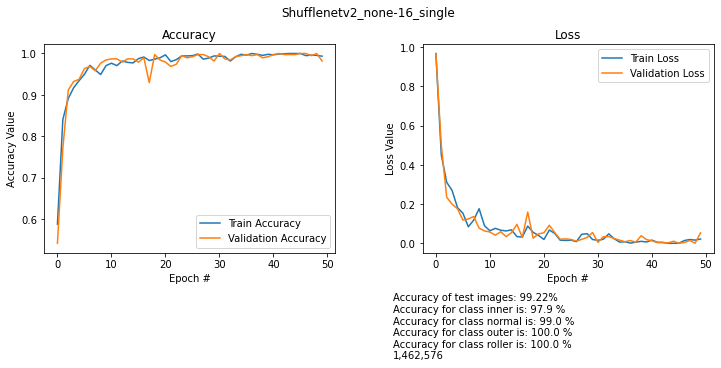

images/none-16_single/train


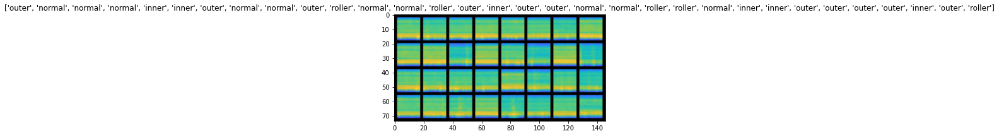

1.0740711688995361
0.8182606101036072
0.21829497814178467
1.159493088722229
0.12104465067386627
0.1357038915157318
0.12686985731124878
0.058260053396224976
0.06628578901290894
0.05762398988008499
0.033850304782390594
0.02201169729232788
0.047015443444252014
0.08785142004489899
0.04369217902421951
0.03858604654669762
0.013431627303361893
0.004549622070044279
0.010338850319385529
0.00815550982952118
0.02375127375125885
0.0057653747498989105
0.07305092364549637
0.18395140767097473
0.03926974534988403
0.015957370400428772
0.02506178244948387
0.023806538432836533
0.02201830968260765
0.015409274026751518
0.016527630388736725
0.03868988901376724
0.009926856495440006
0.04367927834391594
0.0075860051438212395
0.01117519661784172
0.0149735352024436
0.039209332317113876
0.024416260421276093
0.039808861911296844
0.036039017140865326
0.009244379587471485
0.029772233217954636
0.004674672614783049
0.0026859694626182318
0.02653578668832779
0.010470541194081306
0.0037816879339516163
0.00693348143249750

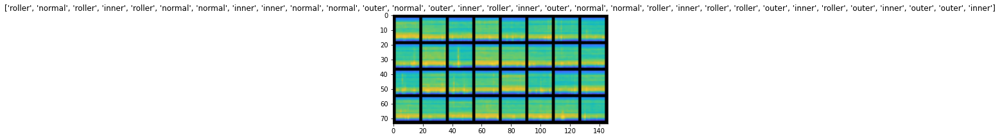

1.2042392492294312
0.9195425510406494
0.40988966822624207
0.15135151147842407
0.1157289370894432
0.060884010046720505
0.034953199326992035
0.09481136500835419
0.03718070685863495
0.024927321821451187
0.017409060150384903
0.029166407883167267
0.019254619255661964
0.04186313971877098
0.11569132655858994
0.033322207629680634
0.008579129353165627
0.0751768946647644
0.025165384635329247
0.05504989251494408
0.01949154958128929
0.012239934876561165
0.021498097106814384
0.011981483548879623
0.12287387251853943
0.021534858271479607
0.022464588284492493
0.03327256813645363
0.002716472838073969
0.011113297194242477
0.020621906965970993
0.00600806949660182
0.017657652497291565
0.10036393254995346
0.004795295186340809
0.028277426958084106
0.0497770756483078
0.004303287714719772
0.00441739521920681
0.02805524319410324
0.003607788123190403
0.01782056875526905
0.0048094578087329865
0.01869121938943863
0.004665362183004618
0.09498252719640732
0.01503818854689598
0.004507390782237053
0.08642753958702087

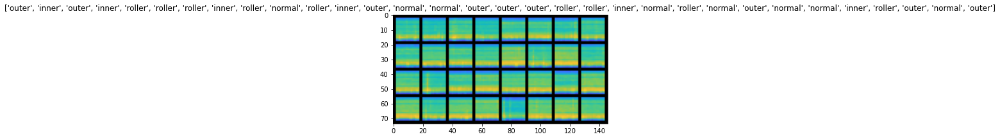

1.157352328300476
2.496445655822754
0.5145556926727295
2.6374430656433105
0.1752673089504242
0.1822081208229065
0.21903717517852783
0.06832901388406754
0.1620011329650879
0.16240271925926208
0.33148232102394104
0.09788642823696136
0.0775294229388237
0.0483248233795166
0.04881103336811066
0.19150875508785248
0.05334421619772911
0.047252338379621506
0.05177772045135498
0.040124617516994476
0.04838794469833374
0.05643568933010101
0.03758719563484192
0.05874648690223694
0.010386103764176369
0.3545779883861542
0.04607594013214111
0.1056138128042221
0.0323985256254673
0.020989488810300827
0.06397002935409546
0.012468739412724972
0.019692253321409225
0.012264514341950417
0.015573397278785706
0.022506706416606903
0.04484644532203674
0.013800608925521374
0.017180394381284714
0.015771765261888504
0.016130391508340836
0.015614132396876812
0.013696303591132164
0.0041468171402812
0.015062767080962658
0.0055094934068620205
0.010585772804915905
0.002955154050141573
0.006335462909191847
0.021446978673

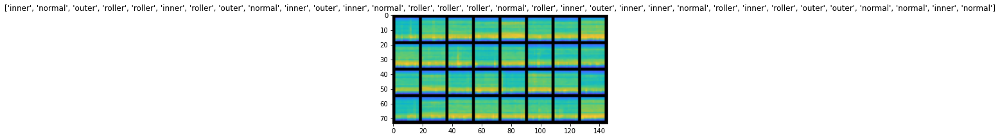

1.1285518407821655
0.9875020980834961
0.9774624109268188
0.8387449979782104
0.22554951906204224
0.23056857287883759
0.2083105891942978
0.08375309407711029
0.08437362313270569
0.057806722819805145
0.07156457751989365
0.1328323930501938
0.04853111505508423
0.06312602013349533
0.055741019546985626
0.04896543174982071
0.07602103054523468
0.0821479931473732
0.09071329236030579
0.2202255129814148
0.060274600982666016
0.0729931890964508
0.028991995379328728
0.04583963379263878
0.3372745215892792
0.041411835700273514
0.056123699992895126
0.06442584097385406
0.04481115564703941
0.06027611345052719
0.07662933319807053
0.07388868927955627
0.07654571533203125
0.23312078416347504
0.11679117381572723
0.5286506414413452
0.04480746015906334
0.038283489644527435
0.05470634251832962
0.0984313040971756
0.03742184862494469
0.07955808937549591
0.03893868252635002
0.2295723557472229
0.027474073693156242
0.10245051234960556
0.032393138855695724
0.08204247802495956
0.04642844945192337
0.0710752084851265
Finis

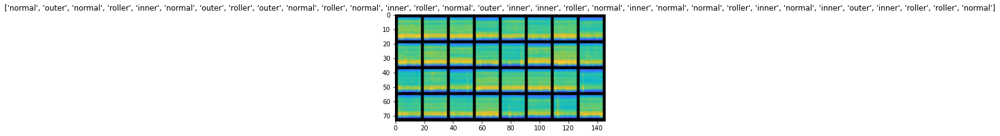

1.3494012355804443
1.2180585861206055
1.3890185356140137
0.14003483951091766
0.4555509090423584
0.1904813051223755
0.20949415862560272
0.12493474781513214
0.16044633090496063
0.13106505572795868
0.11393296718597412
0.07945168018341064
0.12030889838933945
0.0744609534740448
0.04574669897556305
0.03839286416769028
0.09579214453697205
0.13698412477970123
0.017983300611376762
0.03583455830812454
0.05411350354552269
0.07400070130825043
0.09509709477424622
0.030271027237176895
0.01393415778875351
0.06402766704559326
0.026238173246383667
0.031761959195137024
0.027825456112623215
0.042337533086538315
0.024026934057474136
0.04509241506457329
0.02126184105873108
0.04328121244907379
0.0455627366900444
0.10752034187316895
0.02321125939488411
0.027039622887969017
0.052033089101314545
0.03657359629869461
0.09603037685155869
0.06041165813803673
0.04700155183672905
0.055206626653671265
0.03767959773540497
0.048089511692523956
0.05917008966207504
0.08829250931739807
0.04426874965429306
0.09004905819892

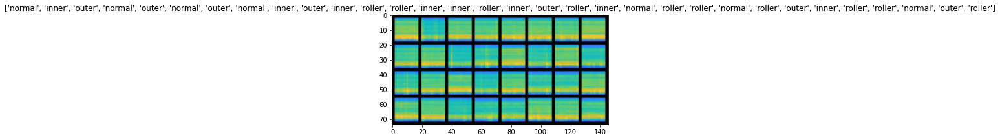

3.0213944911956787
0.5974229574203491
0.719704806804657
0.18817153573036194
0.08149778842926025
0.03090173378586769
0.02794516831636429
0.07215645909309387
0.1289522349834442
0.014567075297236443
0.04036670923233032
0.07866030931472778
0.0631890594959259
0.04926251992583275
0.009438922628760338
0.010350041091442108
0.011886822059750557
0.05095762014389038
0.0076352315954864025
0.018373046070337296
0.017488308250904083
0.026590457186102867
0.016601547598838806
0.00559591269120574
0.27089208364486694
0.17665491998195648
0.07957778126001358
0.005471942480653524
0.0047765327617526054
0.008687181398272514
0.007951300591230392
0.006832679267972708
0.002885057358071208
0.003188569098711014
0.03227809816598892
0.011129803955554962
0.010670406743884087
0.00377474632114172
0.007786226458847523
0.021331530064344406
0.0039952099323272705
0.00230353488586843
0.017337292432785034
0.0052384017035365105
0.0022195111960172653
0.07519364356994629
0.039665184915065765
0.03578779101371765
0.07831172645092

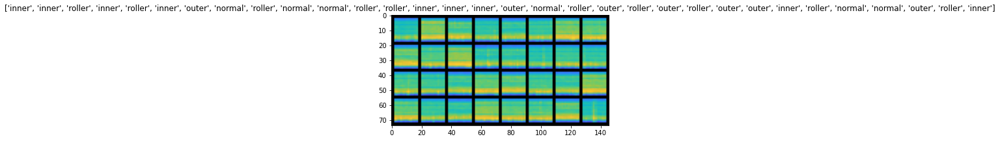

1.1777780055999756
0.4308074116706848
0.35802751779556274
0.4593004882335663
0.16597017645835876
0.18597166240215302
0.16008435189723969
0.04695012420415878
0.06784382462501526
0.3335922956466675
0.01859598234295845
0.13202092051506042
0.08859953284263611
0.0692431777715683
0.021344926208257675
0.07688352465629578
0.020547380670905113
0.057077594101428986
0.04499565064907074
0.03848050907254219
0.03544186055660248
0.07207103073596954
0.06578101962804794
0.018113883212208748
0.017252998426556587
0.05158943682909012
0.01875750534236431
0.04620778188109398
0.03049662336707115
0.010504720732569695
0.012561894953250885
0.013877700082957745
0.026386206969618797
0.007946467027068138
0.01876840740442276
0.018356144428253174
0.018883762881159782
0.004580568056553602
0.003951366990804672
0.04618202894926071
0.021161368116736412
0.008933419361710548
0.010073162615299225
0.04216787964105606
0.006443985737860203
0.014161622151732445
0.002392423339188099
0.0024771124590188265
0.05263739824295044
0.0

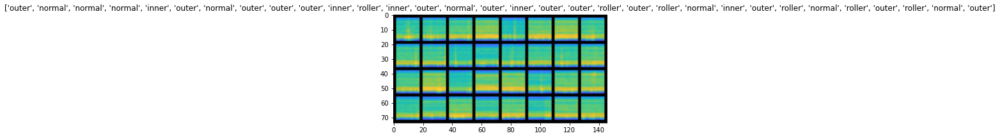

1.0110697746276855
0.43138188123703003
0.2870100140571594
0.17142270505428314
0.3002205193042755
0.13490203022956848
0.08111430704593658
0.05215611308813095
0.1282331645488739
0.06054747849702835
0.043567996472120285
0.07378308475017548
0.054692745208740234
0.0819566398859024
0.04146837070584297
0.033265985548496246
0.025243377313017845
0.05617313086986542
0.1365746706724167
0.063314288854599
0.0804029032588005
0.09856066107749939
0.15429486334323883
0.3123801648616791
0.024213634431362152
0.02346048317849636
0.04290483891963959
0.012277454137802124
0.0483330637216568
0.015140281990170479
0.016689226031303406
0.030863864347338676
0.0633278489112854
0.028008058667182922
0.010125194676220417
0.021180547773838043
0.04406094178557396
0.013344351202249527
0.07553545385599136
0.013186010532081127
0.004429027438163757
0.003074543084949255
0.012842696160078049
0.004429697524756193
0.1618519425392151
0.038776516914367676
0.03886207193136215
0.029980627819895744
0.0030754702165722847
0.032645758

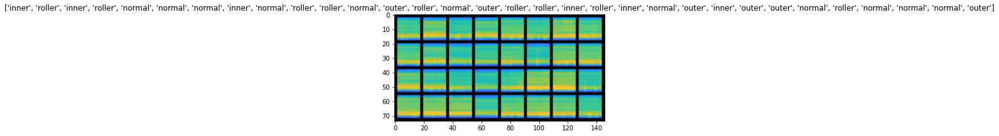

1.033360481262207
0.37354549765586853
0.35128697752952576
0.1936197131872177
0.26353681087493896
0.14120617508888245
0.11342810839414597
0.06713822484016418
0.027148455381393433
0.220954030752182
0.12646299600601196
0.028742488473653793
0.34979820251464844
0.03903507813811302
0.16069602966308594
0.04025014489889145
0.1609431505203247
0.06015884876251221
0.03845440596342087
0.052347131073474884
0.024981318041682243
0.02179662697017193
0.01285872608423233
0.036898404359817505
0.007921015843749046
0.08423508703708649
0.025649838149547577
0.02114192768931389
0.035489439964294434
0.018789347261190414
0.027541978284716606
0.008727988228201866
0.005075628869235516
0.022632252424955368
0.010693054646253586
0.01300086360424757
0.05843592435121536
0.007033563684672117
0.03512946143746376
0.02822616696357727
0.029415883123874664
0.015663178637623787
0.011242654174566269
0.03311664238572121
0.016684679314494133
0.013679574243724346
0.007452532183378935
0.05823136121034622
0.026143718510866165
0.01

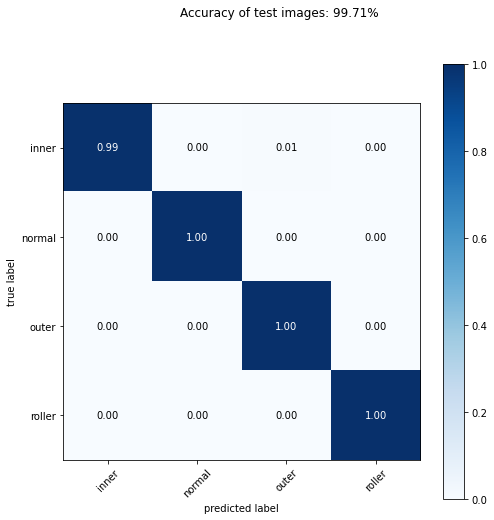

none-32_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.003 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 6.030% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 5.427% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.001 GMac, 18.537% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 6.423% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.958% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1,

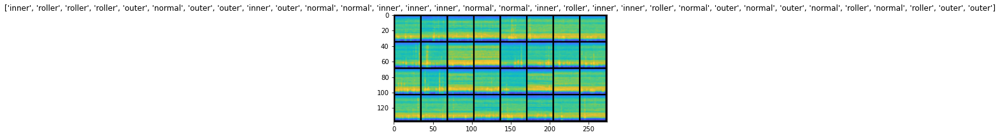

0.5297326445579529
0.3323575556278229
0.591315507888794
0.21270625293254852
0.02334289811551571
0.07255084812641144
0.005622865632176399
0.015830621123313904
0.00859530083835125
0.024383991956710815
0.13710150122642517
0.11924031376838684
0.028689902275800705
0.0075672343373298645
0.004888214636594057
0.01863492652773857
0.008576352149248123
0.004632656462490559
0.005092610605061054
0.02772337943315506
0.031180717051029205
0.01115213893353939
0.0015617415774613619
0.005044618621468544
0.01863222010433674
0.03395942971110344
0.11465271562337875
0.010088926181197166
0.00831244233995676
0.0042198291048407555
0.002812804188579321
0.0027794972993433475
0.0018726533744484186
0.0049591222777962685
0.015900950878858566
0.0015972460387274623
0.011813684366643429
0.0138105358928442
0.009230069816112518
0.04340658709406853
0.0025005973875522614
0.0019457056187093258
0.00163508509285748
0.002044363645836711
0.00282090506516397
0.021395228803157806
0.0013593396870419383
0.001784000312909484
0.00192

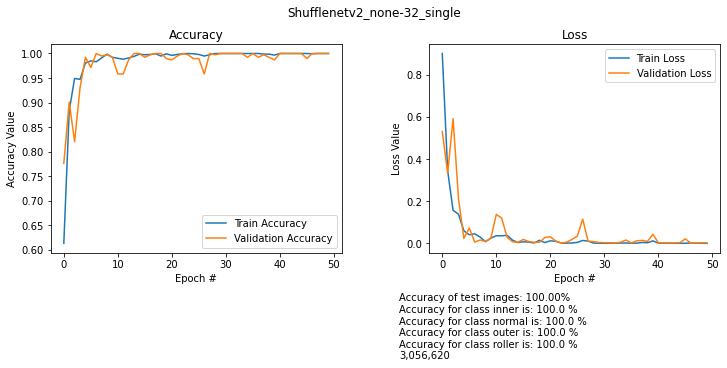

images/none-32_single/train


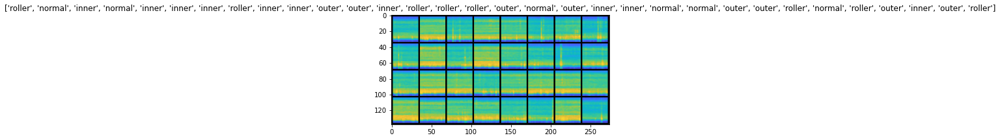

1.497281789779663
0.08181846141815186
1.6089532375335693
0.05304368957877159
0.464400053024292
0.4660170078277588
0.013379573822021484
0.005890437867492437
0.009681290946900845
0.01749642938375473
0.003329941537231207
0.2536723017692566
0.004320352803915739
0.02545081079006195
0.0006468679057434201
0.0017828994896262884
0.006318534724414349
0.001141232205554843
0.03819610923528671
0.005705559626221657
0.0010317519772797823
0.0006621327484026551
0.009160579182207584
0.0032135494984686375
0.05289744958281517
0.0021485313773155212
0.001845872844569385
0.0011728733079507947
0.009878984652459621
0.009682100266218185
0.004707125946879387
0.009113938547670841
0.007368096616119146
0.0446816049516201
0.04315350204706192
0.06908963620662689
0.007680284790694714
0.0029643112793564796
0.004813583567738533
0.002479212824255228
0.00203214050270617
0.0021103727631270885
0.0031587358098477125
0.002970307134091854
0.0032313093543052673
0.003026526188477874
0.0030263755470514297
0.0026840833015739918
0.

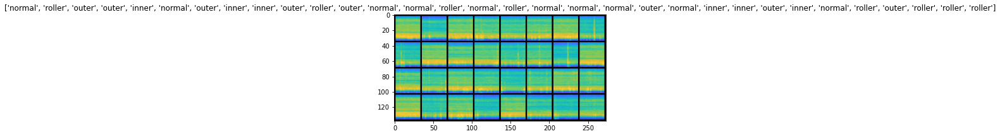

0.7033156156539917
0.31270673871040344
0.19202148914337158
0.0075780851766467094
0.00805281475186348
0.017795754596590996
0.00518760783597827
0.006794142536818981
0.06101226061582565
0.011296352371573448
0.01908566616475582
0.0065290494821965694
0.010053729638457298
0.01583842560648918
0.0009301800164394081
0.003907801583409309
0.0008455835049971938
0.0009381689596921206
0.0007116090273484588
0.0006166143575683236
0.0007255903328768909
0.0011461222311481833
0.000757745117880404
0.0036120021250098944
0.0005910975160077214
0.0005793319432996213
0.0017111103516072035
0.0006850531208328903
0.0008875755593180656
0.0005173621466383338
0.0004164367855992168
0.023201052099466324
0.02078539878129959
0.0020074809435755014
0.0016275604721158743
0.023622281849384308
0.004361453931778669
0.0004932294832542539
0.0008539433474652469
0.0013887644745409489
0.0014802929945290089
0.0002621375897433609
0.0008318118052557111
0.0005299407057464123
0.0008221986936405301
0.06990953534841537
0.0046355742961168

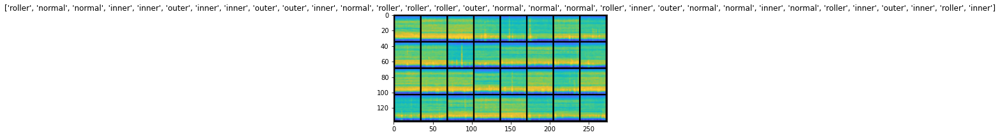

0.5601101517677307
0.9381265640258789
0.06051921099424362
0.08532783389091492
0.02088228426873684
0.018308483064174652
0.008285731077194214
0.024371130391955376
0.06401535868644714
0.05473585054278374
0.009306905791163445
0.00537780299782753
0.0099968696013093
0.08341945707798004
0.4691987633705139
0.004040387459099293
0.02185959182679653
0.019422758370637894
0.11248966306447983
0.006569258868694305
0.017537640407681465
0.0030190942343324423
0.004299622029066086
0.02552182972431183
0.009236062876880169
0.0006628116825595498
0.0007547475397586823
0.00037734227953478694
0.02321084402501583
0.008853031322360039
0.003931929357349873
0.00028874463168904185
0.001604962395504117
0.0010887621901929379
0.00045429746387526393
0.004731195047497749
0.0009673211025074124
0.0005306982784532011
0.0003499326412566006
0.0026260479353368282
0.00028394607943482697
0.00026067637372761965
0.0004051888536196202
0.00014829635620117188
0.00026655540568754077
9.583502833265811e-05
0.00023248590878210962
0.0001

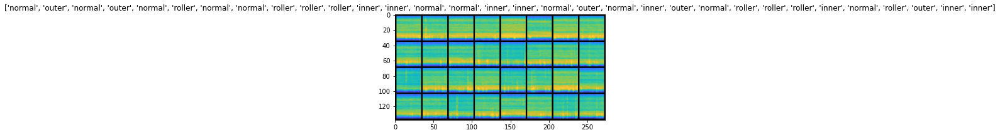

0.7366160750389099
0.17496149241924286
0.07769408077001572
0.04359441250562668
0.007944080047309399
0.02181033417582512
0.02344638668000698
0.027449239045381546
0.01228644885122776
0.008395543321967125
0.0030513578094542027
0.0009144432842731476
0.001003420795314014
0.009703821502625942
0.02015554904937744
0.07210712134838104
0.003383249044418335
0.0031243846751749516
0.024790626019239426
0.0220499224960804
0.00317802163772285
0.0007500884821638465
0.0005687281372956932
0.000552550598513335
0.00047560138045810163
0.0005022628465667367
0.0005034528439864516
0.0011093586217612028
0.0005487162852659822
0.0008200189913623035
0.0005392564926296473
0.0005973022198304534
0.007534362375736237
0.006944674998521805
0.003234846517443657
0.04975561425089836
0.01041336078196764
0.016348885372281075
0.003219723468646407
0.0005209274822846055
0.004757709335535765
0.12283321470022202
0.0070340922102332115
0.04207763075828552
0.010101491585373878
0.013040716759860516
0.013820606283843517
0.005189790390

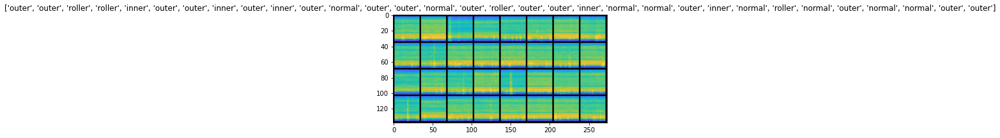

0.6811013221740723
0.16816049814224243
0.1764971911907196
0.15956799685955048
0.013746196404099464
0.06462002545595169
0.005073821172118187
0.056726377457380295
0.0023244149051606655
0.05893373116850853
0.0711488351225853
0.013678665272891521
0.018049977719783783
0.01038691122084856
0.007481930311769247
0.019395049661397934
0.016561375930905342
0.015887241810560226
0.00674591725692153
0.0065513718873262405
0.01478605531156063
0.0020162241999059916
0.0007186327129602432
0.0008369939168915153
0.014554668217897415
0.0008704829961061478
0.0027710699941962957
0.021068722009658813
0.0021044041495770216
0.007489525713026524
0.0021559963934123516
0.0013257928658276796
0.00210758950561285
0.005255647003650665
0.004194701090455055
0.004891320131719112
0.005141410045325756
0.0031899118330329657
0.000830742996186018
0.003847431158646941
0.07564297318458557
0.0015876642428338528
0.0011296523734927177
0.0032666062470525503
0.002227901481091976
0.017892850562930107
0.0053822132758796215
0.00204440439

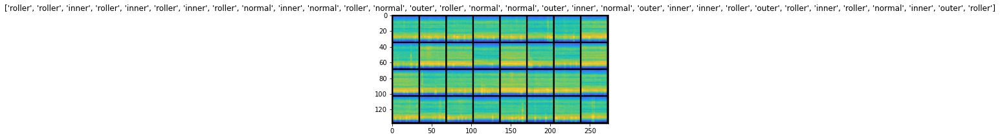

2.895522117614746
0.27975907921791077
0.6005839705467224
0.0037427162751555443
0.006162870209664106
0.023601818829774857
0.06012916564941406
0.0026558246463537216
0.05992335081100464
0.010179081931710243
0.0048622991889715195
0.009420543909072876
0.07064801454544067
0.055951304733753204
0.007493063807487488
0.0023142118006944656
0.004797285422682762
0.0008855946362018585
0.0006660595536231995
0.0005031605833210051
0.0034088946413248777
0.000815108185634017
0.0004294331301935017
0.00025398374418728054
0.00029949136660434306
0.00039868190651759505
0.0002632603864185512
0.0002702298224903643
0.00023062310356181115
0.0001587820879649371
0.00020890419546049088
0.0001944680989254266
0.00012051586236339062
0.0289028100669384
0.0006550885736942291
0.0004995123599655926
0.00038243710878305137
0.001107392949052155
0.0007807273650541902
0.000110484535980504
0.00012330086610745639
0.00027738354401662946
0.00022537079348694533
0.00027693924494087696
0.017154235392808914
0.0003045619814656675
0.0002

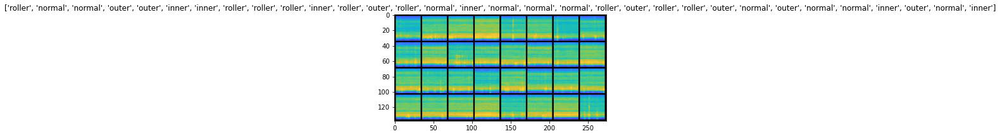

1.574460506439209
0.5908803939819336
0.5275416374206543
0.025536391884088516
0.18976718187332153
0.01821812614798546
0.12339705228805542
0.07695672661066055
0.04247318208217621
0.013561266474425793
0.011475492268800735
0.009596005082130432
0.042036306113004684
0.02763160690665245
0.0028837737627327442
0.002632392104715109
0.010427786037325859
0.004270516335964203
0.00227519404143095
0.023258868604898453
0.002955330302938819
0.0036056176759302616
0.004540335386991501
0.0032903854735195637
0.003943039570003748
0.010473518632352352
0.000703044468536973
0.0005792495794594288
0.0005646721110679209
0.0005447266157716513
0.01583963818848133
0.0005656146677210927
0.010747908614575863
0.0023477172944694757
0.0022876537404954433
0.0015123547054827213
0.001590845175087452
0.0018113929545506835
0.0017325248336419463
0.0019228493329137564
0.047471582889556885
0.046928130090236664
0.0035460423678159714
0.01807083562016487
0.007143670693039894
0.0024283546954393387
0.0009685823461040854
0.00107587256

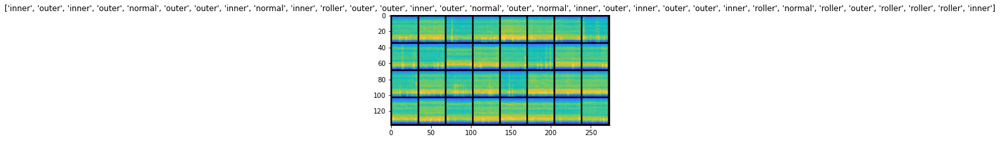

1.1581376791000366
0.528667688369751
0.5458142757415771
0.2825688123703003
0.03505922853946686
0.018176482990384102
0.017526742070913315
0.005096993874758482
0.05077756568789482
0.03216172009706497
0.023691657930612564
0.2164253294467926
0.020192092284560204
0.15818879008293152
0.004392310976982117
0.0631697028875351
0.04802481830120087
0.23376652598381042
0.028782835230231285
0.021905377507209778
0.014683379791676998
0.007506714668124914
0.003786381334066391
0.001942085800692439
0.0017327553359791636
0.007357797585427761
0.0068033430725336075
0.0015877329278737307
0.01194712519645691
0.003015708178281784
0.004597894381731749
0.006040416192263365
0.00420239195227623
0.005641542375087738
0.021925514563918114
0.0028051408007740974
0.002093337941914797
0.0046355510130524635
0.0014165154425427318
0.0019411880057305098
0.0027547157369554043
0.0035279334988445044
0.004468602128326893
0.01237536408007145
0.007213442586362362
0.003286762861534953
0.007904967293143272
0.0011209883959963918
0.00

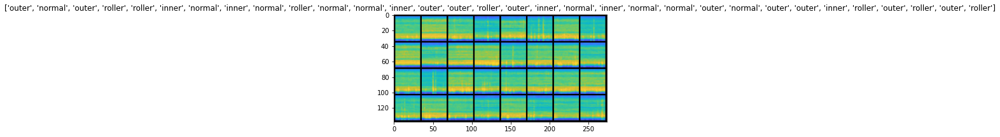

1.669791579246521
0.35588547587394714
0.135276660323143
0.0749649927020073
0.036924149841070175
0.11251260340213776
0.1709139347076416
0.07743830978870392
0.03612910956144333
0.04721818491816521
0.11551481485366821
0.025390245020389557
0.015971247106790543
0.01541979145258665
0.010735556483268738
0.009298047982156277
0.1279565691947937
0.10635802149772644
0.014891747385263443
0.015639450401067734
0.0039035705849528313
0.0018032754305750132
0.08465653657913208
0.0034123945515602827
0.00529436906799674
0.05589228868484497
0.02343037538230419
0.00555871706455946
0.03248181939125061
0.0011465671705082059
0.0004278076230548322
0.0006603723159059882
0.0008662900654599071
0.0005611211527138948
0.0005571588408201933
0.00403560372069478
0.003132403828203678
0.0023840656504034996
0.0013719451380893588
0.0024452751968055964
0.0012592502171173692
0.0014589149504899979
0.0014726700028404593
0.000986623577773571
0.001231126836501062
0.000902002677321434
0.0015399428084492683
0.0009084994671866298
0.

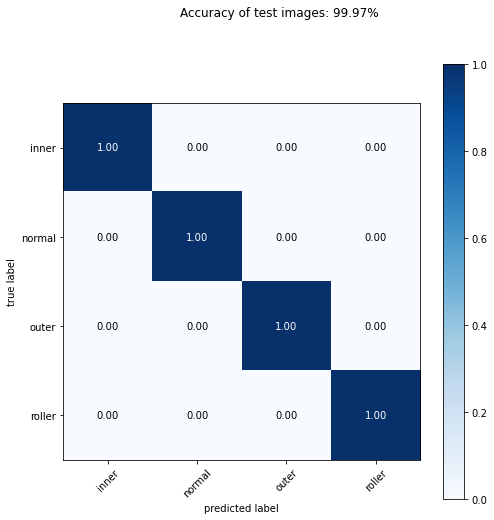

none-64_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.012 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.001 GMac, 6.036% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.001 GMac, 5.433% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.002 GMac, 18.555% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.001 GMac, 6.429% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.959% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), paddi

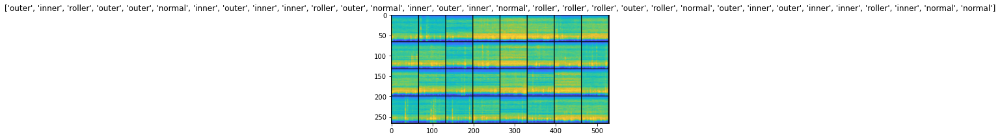

0.28933483362197876
0.02748599462211132
0.009167008101940155
0.01815548539161682
0.02926352620124817
0.030550867319107056
0.001401090412400663
0.0004534111067187041
0.0002662302867975086
6.858263805042952e-05
0.00017852148448582739
0.0001245889434358105
9.38169687287882e-05
0.0001248946791747585
0.00017794655286706984
0.0001198993923026137
0.00018202057981397957
0.00010229919280391186
7.021279452601448e-05
7.370900857495144e-05
0.00011411677405703813
0.006585836410522461
0.00011615742550930008
7.23993725841865e-05
7.101873052306473e-05
0.00010045991803053766
0.00015672267181798816
6.96742717991583e-05
3.8086349377408624e-05
8.800793148111552e-05
0.0001294993853662163
4.926843030261807e-05
3.289023879915476e-05
3.253724571550265e-05
4.16239163314458e-05
3.258509605075233e-05
3.2713291147956625e-05
3.464228211669251e-05
4.091478695045225e-05
3.691823803819716e-05
2.2827687644166872e-05
2.00399081222713e-05
3.8934671465540305e-05
2.74943213298684e-05
5.3093866881681606e-05
1.9023827917408

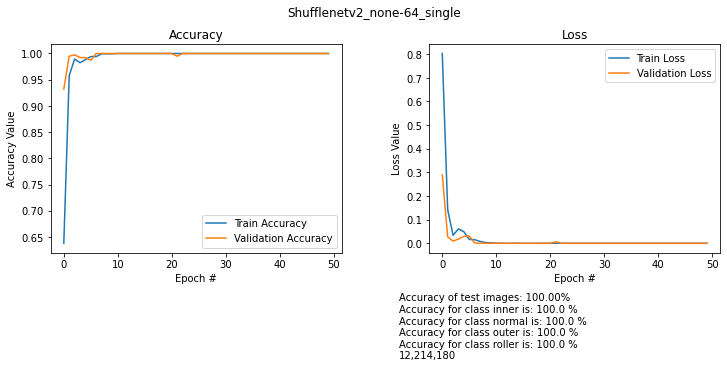

images/none-64_single/train


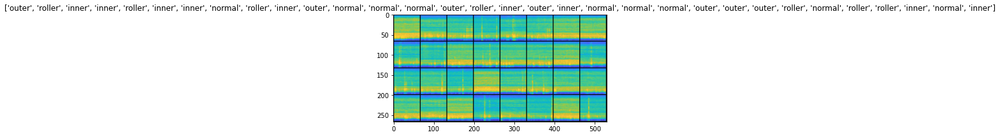

0.6598096489906311
1.1141623258590698
0.021211935207247734
0.05096350237727165
0.03682310879230499
0.09599357098340988
0.01957128196954727
0.0004116190830245614
0.005039646290242672
0.018179606646299362
0.008224371820688248
0.012566149234771729
0.018331244587898254
0.01303982362151146
0.012522440403699875
0.010142102837562561
0.004468431696295738
0.0028979654889553785
0.008753344416618347
0.010023662820458412
0.012278321199119091
0.015569556504487991
0.00014753690629731864
0.00027450680499896407
0.003588243154808879
0.00044309429358690977
0.00022261646518018097
0.0011443939292803407
0.0003081659087911248
0.0006507808575406671
0.0005349805578589439
0.00023314994177781045
0.0030129195656627417
0.0023748017847537994
0.0013692000648006797
0.0029138370882719755
0.0007046621758490801
0.001260221702978015
0.0011098358081653714
0.0016664003487676382
0.024014227092266083
0.07846450060606003
0.0009724273113533854
0.008385099470615387
0.0009686722769401968
0.0003557379241101444
0.0004603745765052

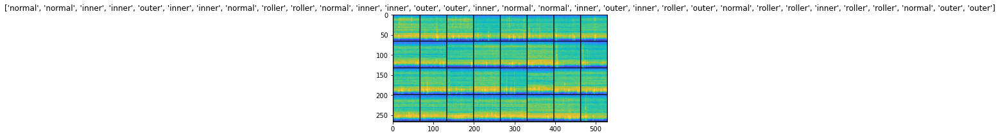

1.245208978652954
0.03528911992907524
0.02307926118373871
0.05622256547212601
0.15238960087299347
0.021299466490745544
0.003590099513530731
0.0007962129893712699
0.0010683507425710559
0.005867736414074898
0.0051598576828837395
0.0003527532680891454
0.000347211433108896
0.0003479980514384806
0.00024730036966502666
0.00024379263049922884
0.00012272562889847904
0.013778033666312695
0.021796105429530144
0.022120989859104156
0.005042506381869316
0.0022017103619873524
0.002015686361119151
0.001534532755613327
0.0018159204628318548
0.002316073514521122
0.004758007824420929
0.0021292464807629585
0.0028456158470362425
0.0049098399467766285
0.0013148728758096695
0.0007251236820593476
0.0008206069469451904
0.0010710684582591057
0.0003999277832917869
0.0017893308540806174
0.00617597158998251
0.009894872084259987
0.00021886720787733793
0.00014266357175074518
0.00016556639457121491
0.00010096257756231353
0.00012239787611179054
0.0006180062191560864
0.0002671956899575889
0.0001639888942008838
0.00019

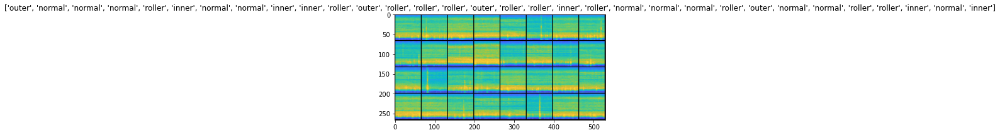

0.2262600064277649
0.09172715246677399
0.010212774388492107
0.008074149489402771
0.13519904017448425
0.0033459514379501343
0.006221120245754719
0.002317842561751604
0.014865378849208355
0.00540355546399951
0.003534797579050064
0.00028161946102045476
0.0002752342843450606
0.36965441703796387
0.002108269836753607
0.0012373070931062102
0.001326020690612495
0.000260742730461061
0.009415416046977043
0.0003556443261913955
0.0011351726716384292
0.0007944900426082313
0.0006794270593672991
0.008578164502978325
0.002072745468467474
0.00044435690506361425
0.0005968579789623618
0.0003663580573629588
0.0002035606885328889
0.0010438240133225918
0.00042111260700039566
0.00022391256061382592
0.00013497644977178425
0.00018008500046562403
0.0001290952059207484
9.642197983339429e-05
0.00011278248712187633
7.475290476577356e-05
7.946010737214237e-05
8.888306183507666e-05
8.238889131462201e-05
0.00025835196720436215
0.00010062928049592301
8.609948417870328e-05
6.0029411542927846e-05
5.744511145167053e-05
5

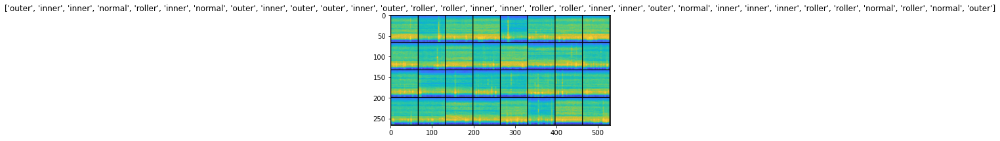

1.6390681266784668
0.2174655795097351
0.07121926546096802
0.36747026443481445
0.024056389927864075
0.04306448996067047
0.0022739882115274668
0.04983551800251007
0.01671120710670948
0.02638094685971737
0.0071339416317641735
0.05822309851646423
0.006296749226748943
0.0008927177987061441
0.0006818583933636546
0.002381951315328479
0.002133274683728814
0.00288272718898952
0.011969950050115585
0.006548719014972448
0.03815549612045288
0.23943105340003967
0.0034276682417839766
0.004478209186345339
0.002064230153337121
0.29018843173980713
0.004481662064790726
0.004664096515625715
0.01325319241732359
0.03671092912554741
0.0003180492203682661
0.003383990377187729
0.008360020816326141
0.07175879180431366
0.004892752505838871
0.003993799444288015
0.0011308997636660933
0.0008103132713586092
0.0021412812639027834
0.0028761420398950577
0.017756856977939606
0.002525473013520241
0.0007664799923077226
0.002772192470729351
0.004209568724036217
0.0018476832192391157
0.0025452328845858574
0.0021036707330495

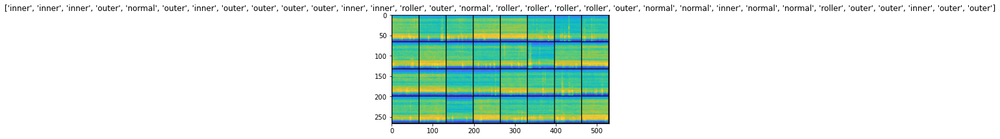

0.329423725605011
1.4908010959625244
0.06309105455875397
0.018723413348197937
0.021446429193019867
0.01416265219449997
0.009338258765637875
0.0009015778778120875
0.03952788561582565
0.07785134017467499
0.008905168622732162
0.020249322056770325
0.014343547634780407
0.01404173206537962
0.017074689269065857
0.009299651719629765
0.007326066493988037
0.0008245595963671803
0.015658192336559296
0.010517377406358719
0.009574908763170242
0.011195333674550056
0.008640988729894161
0.008030775934457779
0.01209992915391922
0.005695336498320103
0.006376506295055151
0.012092611752450466
0.008743396028876305
0.00846058689057827
0.013573801144957542
0.012402730993926525
0.01205826923251152
0.007641696836799383
0.00781701784580946
0.010956255719065666
0.00998635869473219
0.01088644377887249
0.009876444935798645
0.009306984022259712
0.007929006591439247
0.012708861380815506
0.012394819408655167
0.008106973953545094
0.012655328959226608
0.009039748460054398
0.011392171494662762
0.008835055865347385
0.0053

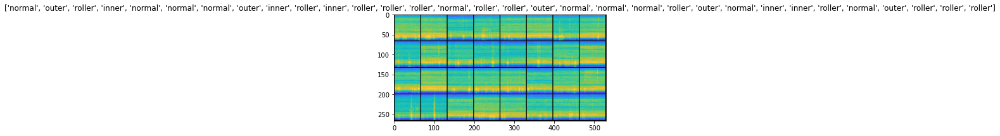

1.7458453178405762
0.9925684332847595
0.043430428951978683
0.010355962440371513
0.008040498942136765
0.02610141783952713
0.011563519015908241
0.0012229994172230363
0.00019391177920624614
0.006627751514315605
0.00885141734033823
0.0038476698100566864
0.00027895919629372656
0.00011737817840185016
0.006353282835334539
0.014391489326953888
0.0010617917869240046
0.0006934957928024232
0.0005764257512055337
0.0060379947535693645
0.0017920145764946938
0.0007405993528664112
0.00013958787894807756
0.00028198095969855785
0.0007498987833969295
0.00021140638273209333
0.0002125377068296075
9.538363519823179e-05
0.00010799412848427892
0.00010867108358070254
0.00011114566586911678
0.00011561696737771854
7.430561527144164e-05
9.448855416849256e-05
6.943830521777272e-05
0.00021122623002156615
0.00023820309434086084
0.00017306997324340045
0.00013551139272749424
0.00015428602637257427
6.566460069734603e-05
5.1225659262854606e-05
0.00010089266288559884
8.358740888070315e-05
6.877363193780184e-05
7.60848342

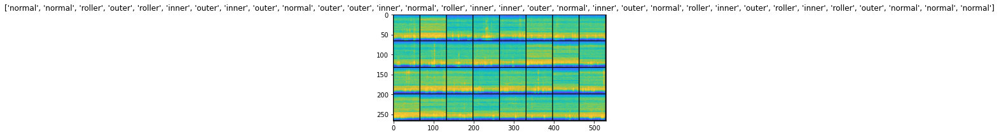

1.1779814958572388
0.3657568395137787
0.02602684311568737
0.013028843328356743
0.010470256209373474
0.03407323360443115
0.0072336094453930855
0.10046445578336716
0.01681927591562271
0.00043230096343904734
0.0006723521510139108
0.00025381831801496446
0.007000420242547989
0.028436139225959778
0.023283710703253746
0.0020936394575983286
0.0005095030646771193
0.0013318656710907817
0.006383050233125687
0.0004007067473139614
0.0043382481671869755
0.007380758412182331
0.0020193045493215322
0.021048448979854584
0.00023557015811093152
0.021593976765871048
0.014989638701081276
0.014381270855665207
0.0122674023732543
0.013461469672620296
0.013745780102908611
0.029278770089149475
0.005364158656448126
0.007424547802656889
0.007281121797859669
0.0003152565041091293
0.0013020894257351756
0.0008244949276559055
0.001861534547060728
0.0014899945817887783
0.0012203461956232786
0.03526230901479721
0.0006331615732051432
0.020977113395929337
0.0011161223519593477
0.003439958905801177
0.0014767423272132874
0.

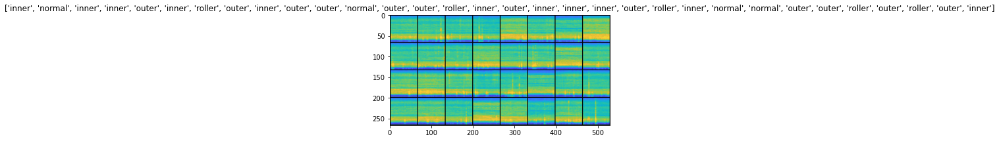

0.22853538393974304
0.029450170695781708
0.04784141108393669
0.1480470895767212
0.16993427276611328
0.0029867105185985565
0.005831064190715551
0.014614757150411606
0.008235273882746696
0.3189848065376282
0.020178038626909256
0.21905478835105896
0.009125074371695518
0.0006440603174269199
0.00047697717673145235
0.0003329920582473278
0.0001988464209716767
0.00028572496376000345
0.00030871143098920584
0.00022637660731561482
0.001744370791129768
0.0010915502207353711
0.00041647872421890497
0.00026002174126915634
0.0002509210607968271
0.00014000700321048498
0.006455352064222097
0.0007560373051092029
0.004159340634942055
0.0014972275821492076
0.0009174758451990783
0.0004838830791413784
0.010553130879998207
0.0003718844091054052
0.0004035279562231153
0.0003384708834346384
0.00021308290888555348
0.00028348970226943493
0.0002762915682978928
0.00016754251555539668
0.00015473965322598815
0.00011450708552729338
0.00018409341282676905
9.657905320636928e-05
0.00010190120519837365
0.000120592521852813

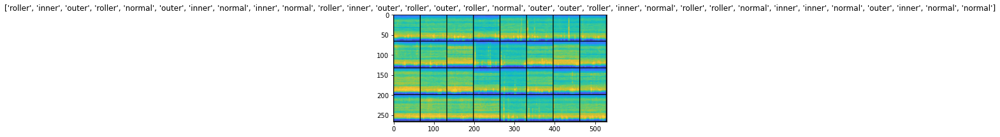

1.4325965642929077
0.24196964502334595
0.014851173385977745
0.3091800808906555
0.010784341022372246
0.06926468759775162
0.0014740744372829795
0.008160268887877464
0.009459685534238815
0.021521760150790215
0.00313197891227901
0.0007757397834211588
0.0038128902669996023
0.0002240614703623578
0.00021755811758339405
0.0002139866992365569
0.0006351514020934701
0.0009999512694776058
0.0011911517940461636
0.00014934227510821074
9.466469055041671e-05
6.01286519668065e-05
4.9352711357641965e-05
7.145703420974314e-05
5.395511107053608e-05
0.00016932512517087162
7.53428103053011e-05
4.355326382210478e-05
0.00011926874867640436
8.355197496712208e-05
7.952327723614872e-05
3.571404886315577e-05
6.772462802473456e-05
3.340079274494201e-05
6.894554826430976e-05
7.620982796652243e-05
5.10034806211479e-05
6.753056368324906e-05
0.00011199080472579226
4.0662001993041486e-05
5.0820905016735196e-05
3.0482548027066514e-05
2.551834586483892e-05
3.204945824109018e-05
2.5456840376136824e-05
2.3227996280184016e-

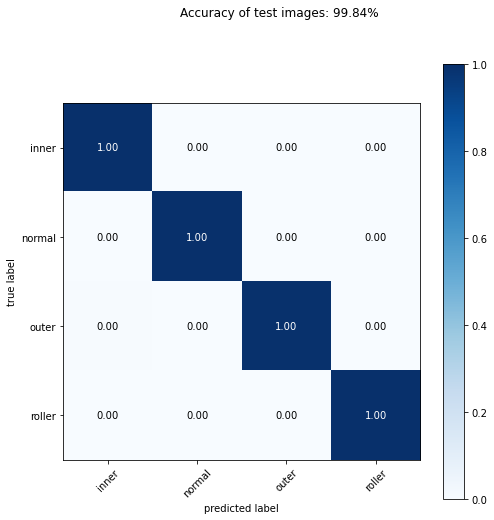

top_left-16_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.001 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 3.151% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 2.836% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.210% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.0 GMac, 9.685% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 3.356% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.500% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.059% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1

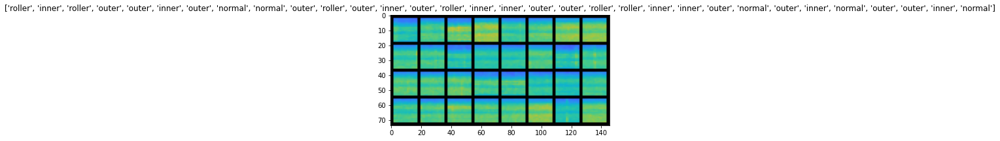

1.123521327972412
0.9278386831283569
0.3238900303840637
0.35104748606681824
0.33979547023773193
0.24982038140296936
0.16033439338207245
0.15550798177719116
0.06910518556833267
0.05268233269453049
0.07837025821208954
0.8115648031234741
0.07294289767742157
0.23740732669830322
0.1603064239025116
0.027203304693102837
0.045078590512275696
0.14930927753448486
0.13918006420135498
0.030511412769556046
0.05772201716899872
0.051265280693769455
0.058648210018873215
0.029231037944555283
0.1506502330303192
0.1112012267112732
0.03194844350218773
0.031356509774923325
0.04784132540225983
0.029060106724500656
0.058055371046066284
0.0503484383225441
0.033493753522634506
0.024847401306033134
0.04308447986841202
0.039123378694057465
0.02996549755334854
0.02963116392493248
0.02687305212020874
0.2110706865787506
0.06295673549175262
0.11859934031963348
0.016495322808623314
0.00800495594739914
0.014290755614638329
0.02073599211871624
0.012118401005864143
0.14810070395469666
0.020423034206032753
0.097080044448

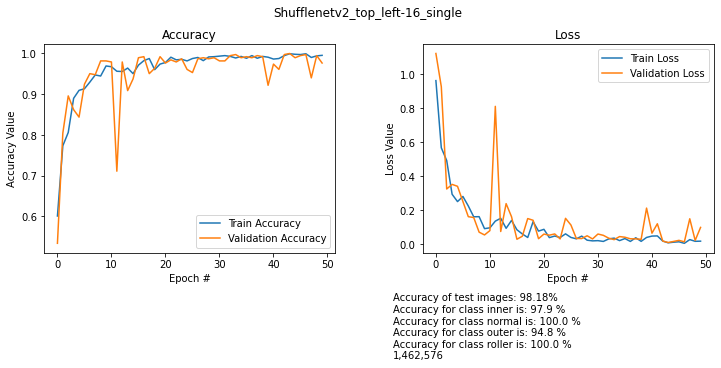

images/top_left-16_single/train


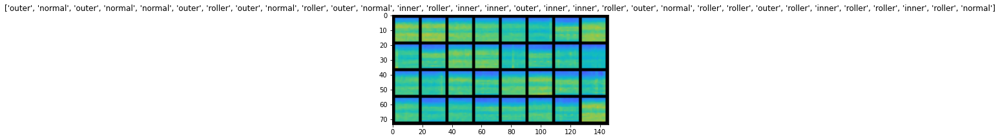

1.2088618278503418
0.5972118377685547
0.6565330624580383
0.24761199951171875
0.6158837080001831
0.1668696105480194
0.19497212767601013
0.15539513528347015
0.22923509776592255
0.10204687714576721
0.3001582622528076
0.08135250210762024
0.20127514004707336
0.08900518715381622
0.13114488124847412
0.18441393971443176
0.054701678454875946
0.16817784309387207
0.11779480427503586
0.3266465663909912
0.037366367876529694
0.2785361707210541
0.28809070587158203
0.07919199764728546
0.07129649072885513
0.13266131281852722
0.05576290935277939
0.11874248832464218
0.04143543541431427
0.017429370433092117
0.026730237528681755
0.03211180120706558
0.05280721187591553
0.021205168217420578
0.04671774059534073
0.014547048136591911
0.03640760853886604
0.05443719029426575
0.033626846969127655
0.0460953414440155
0.044087003916502
0.08914680778980255
0.07092680037021637
0.04429652541875839
0.016380716115236282
0.04013589397072792
0.02760789357125759
0.038367968052625656
0.06050712987780571
0.015047864988446236
F

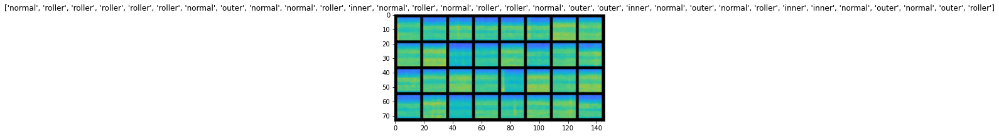

0.7767292857170105
0.4802515208721161
0.19645822048187256
0.2639501094818115
0.19909921288490295
0.16486260294914246
0.2880813479423523
0.22648309171199799
0.13066324591636658
0.103352390229702
0.1976972073316574
0.1010093092918396
0.17047159373760223
0.12627220153808594
0.11141091585159302
0.0950574278831482
0.07081715762615204
0.0797898918390274
0.10798418521881104
0.09487660974264145
0.18532997369766235
0.056177183985710144
0.059959527105093
0.06878654658794403
0.04842574894428253
0.12747043371200562
0.09659731388092041
0.054128363728523254
0.05836156755685806
0.06118638440966606
0.1534847915172577
0.08482619374990463
0.14121533930301666
0.1354002058506012
0.06993038952350616
0.07000812143087387
0.18668583035469055
0.04539842531085014
0.045855335891246796
0.10805681347846985
0.06909985840320587
0.09244777262210846
0.09127619862556458
0.1845065802335739
0.038875844329595566
0.03425836190581322
0.05089111253619194
0.0539449080824852
0.04460372030735016
0.11249815672636032
Finish train

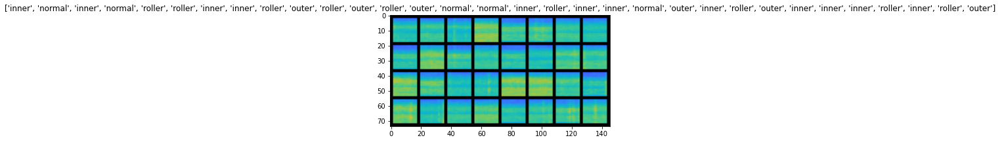

0.9673363566398621
0.37593531608581543
0.426469624042511
0.6520555019378662
0.4052584171295166
0.21399454772472382
0.14578506350517273
0.08189254254102707
0.13694283366203308
0.15518496930599213
0.08388328552246094
0.06654343008995056
0.09311472624540329
0.06152903288602829
0.11856900155544281
0.1168285608291626
0.07191421091556549
0.0838216245174408
0.6946351528167725
0.14915163815021515
0.030750637874007225
0.06386932730674744
0.1252329796552658
0.10135456174612045
0.08045274764299393
0.06998076289892197
0.1255176067352295
0.05036158487200737
0.02486404776573181
0.13114206492900848
0.04118289798498154
0.2860293686389923
0.08482548594474792
0.017403174191713333
0.015244848094880581
0.03130678832530975
0.0352284200489521
0.01597467251121998
0.013702734373509884
0.015699097886681557
0.021750852465629578
0.05617230385541916
0.030269738286733627
0.016828805208206177
0.027743391692638397
0.24039611220359802
0.04644743725657463
0.02475622110068798
0.020233992487192154
0.0090316291898489
Fin

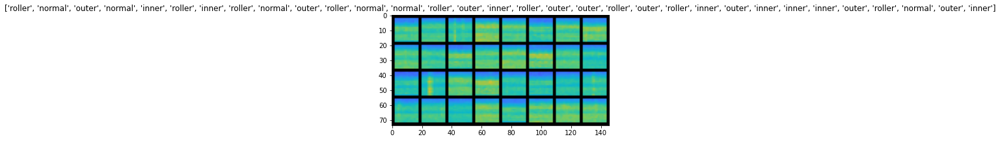

0.894160270690918
0.5749061107635498
0.28927165269851685
0.25583362579345703
0.2100035399198532
0.30398762226104736
0.18509916961193085
0.1293516457080841
0.14852304756641388
0.1336718499660492
0.10778173804283142
0.08285079896450043
0.1467934548854828
0.06795590370893478
0.16867786645889282
0.05247493088245392
0.04592287540435791
0.1405552625656128
0.03857448324561119
0.1291911005973816
0.10411937534809113
0.09072424471378326
0.09433029592037201
0.06830396503210068
0.14067497849464417
0.06707225739955902
0.09685270488262177
0.06652305275201797
0.05683116242289543
0.11668440699577332
0.2122654765844345
0.058059778064489365
0.08954106271266937
0.07259692996740341
0.07676482945680618
0.08409395068883896
0.09473687410354614
0.07936622202396393
0.03636971116065979
0.07143482565879822
0.08596079051494598
0.031092315912246704
0.07037679105997086
0.1128799170255661
0.07894918322563171
0.07560931146144867
0.040896616876125336
0.09355898201465607
0.07418712973594666
0.05947130173444748
Finish t

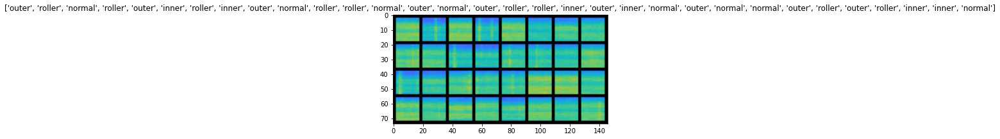

0.9771999716758728
0.37612587213516235
0.2795185446739197
0.2733543813228607
0.1994592845439911
0.12985287606716156
0.35403546690940857
0.11656322330236435
0.0991070494055748
0.2497837245464325
0.2434169501066208
0.1411232054233551
0.09528058767318726
0.14997369050979614
0.10958926379680634
0.24016991257667542
0.053669147193431854
0.16764406859874725
0.1363130807876587
0.11959871649742126
0.10062932223081589
0.05994478985667229
0.08793026208877563
0.07852062582969666
0.05811765044927597
0.09489893913269043
0.2107025384902954
0.08682073652744293
0.1255168616771698
0.14332053065299988
0.06123474985361099
0.152912899851799
0.08615764230489731
0.13334089517593384
0.10920321941375732
0.05509087070822716
0.07763824611902237
0.0449969582259655
0.07017555832862854
0.11460104584693909
0.03460300713777542
0.11029052734375
0.4335358738899231
0.07748335599899292
0.04511156305670738
0.10070856660604477
0.13338525593280792
0.08446095883846283
0.030423251911997795
0.058369532227516174
Finish training

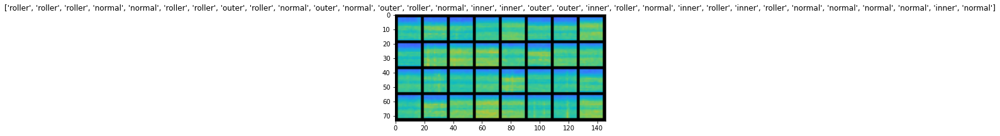

1.4592037200927734
0.7559405565261841
0.3796731233596802
0.22677801549434662
0.25265777111053467
0.2144692838191986
0.18664106726646423
0.13120520114898682
0.26830774545669556
0.4715625047683716
0.11557750403881073
0.29233938455581665
0.20703008770942688
0.18819424510002136
0.11434024572372437
0.11625393480062485
0.11466528475284576
0.10559986531734467
0.21544580161571503
0.19651159644126892
0.08133571594953537
0.14528265595436096
0.09797628968954086
0.1434318870306015
0.3002317249774933
0.08960407227277756
0.16462548077106476
0.0566437654197216
0.10087528079748154
0.05805686116218567
0.17717289924621582
0.16536611318588257
0.06185591220855713
0.07811037451028824
0.1009027287364006
0.06131112575531006
0.08516450971364975
0.05210151895880699
0.08682363480329514
0.23624244332313538
0.0781647115945816
0.06601381301879883
0.030783092603087425
0.04333586245775223
0.1555999219417572
0.1409599334001541
0.04861963540315628
0.049076925963163376
0.04028337448835373
0.07690958678722382
Finish tra

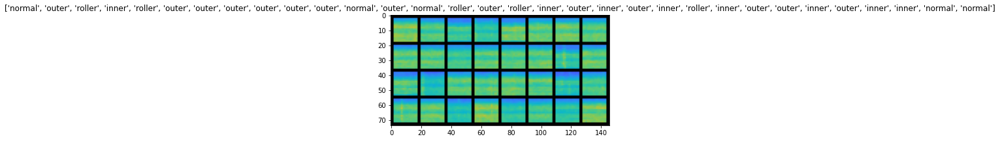

1.275261402130127
0.476569265127182
0.7496706247329712
0.3691868782043457
0.4123397469520569
0.543941080570221
0.3870377540588379
0.3155222237110138
0.1780763566493988
0.17124222218990326
0.40461277961730957
0.07479000091552734
0.12643307447433472
0.2745344340801239
0.14915084838867188
0.08029094338417053
0.1384885311126709
0.08070031553506851
0.130723237991333
0.06496613472700119
0.09603806585073471
0.13552704453468323
0.21613673865795135
0.2063380479812622
0.09011595696210861
0.151228129863739
0.21635769307613373
0.09634695947170258
0.09096187353134155
0.175751194357872
0.07532833516597748
0.05617205426096916
0.08045323193073273
0.15692868828773499
0.1086769700050354
0.09405182301998138
0.05852678418159485
0.05084499344229698
0.08302100002765656
0.1052035242319107
0.09413062781095505
0.13221406936645508
0.040526170283555984
0.13920417428016663
0.08657874912023544
0.15798881649971008
0.018280889838933945
0.10355957597494125
0.03686331585049629
0.4204028844833374
Finish training!
Accur

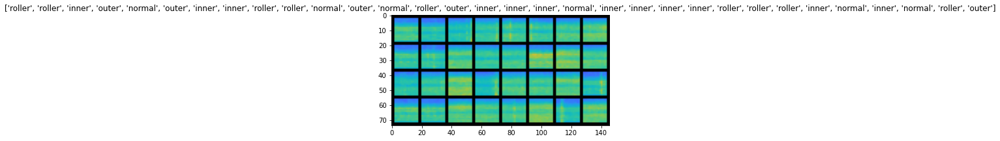

1.3250516653060913
0.43724650144577026
0.3106493651866913
0.4015495777130127
0.3419952094554901
0.17836497724056244
0.18493019044399261
0.1399194747209549
0.133031964302063
0.12073932588100433
0.20724330842494965
0.2123783826828003
0.11144208908081055
0.18859069049358368
0.3220241367816925
0.08064261078834534
0.1188233494758606
0.08085644990205765
0.05953654274344444
0.09493781626224518
0.11652272939682007
0.07295513153076172
0.05543902516365051
0.08621911704540253
0.08958107233047485
0.10948261618614197
0.06523396819829941
0.05193508788943291
0.22179566323757172
0.08457724750041962
0.031819961965084076
0.06141868978738785
0.10116614401340485
0.13508561253547668
0.054242875427007675
0.06299622356891632
0.054497718811035156
0.04264815151691437
0.06472565233707428
0.1076878011226654
0.0311882384121418
0.11218658089637756
0.04437703639268875
0.17082004249095917
0.12438686937093735
0.04079054296016693
0.06742395460605621
0.08405525982379913
0.07145987451076508
0.05149305611848831
Finish tr

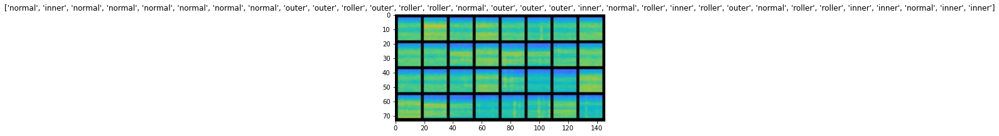

0.7971309423446655
0.6629809737205505
0.42440736293792725
0.31582850217819214
0.4014587998390198
0.5522421002388
0.14166831970214844
0.17769122123718262
0.17383313179016113
0.167398139834404
0.21436330676078796
0.24234384298324585
0.14242802560329437
0.1101970374584198
0.11851206421852112
0.05502062663435936
0.2195824682712555
0.10035437345504761
0.059318624436855316
0.05852677673101425
0.04644836485385895
0.14188958704471588
0.18092748522758484
0.07330344617366791
0.09245230257511139
0.10964145511388779
0.14673283696174622
0.21650147438049316
0.17152653634548187
0.06188570708036423
0.01713724248111248
0.07466481626033783
0.04601408541202545
0.047368258237838745
0.0630490705370903
0.025092314928770065
0.062469445168972015
0.03336971625685692
0.022089822217822075
0.182428240776062
0.07268606126308441
0.06435801088809967
0.04206370934844017
0.1891678422689438
0.03592459857463837
0.037243977189064026
0.01681174337863922
0.0223180390894413
0.0180368535220623
0.019674358889460564
Finish tra

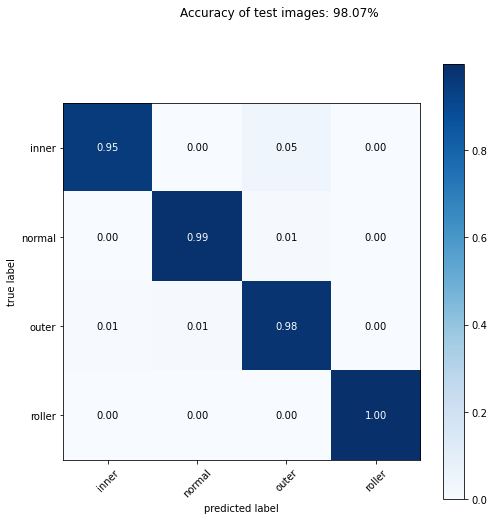

top_left-32_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.003 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 6.030% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 5.427% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.001 GMac, 18.537% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 6.423% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.958% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding

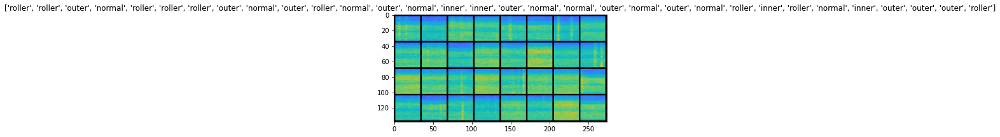

0.8999390006065369
0.35990381240844727
0.14167360961437225
0.13403210043907166
0.16164234280586243
0.16693845391273499
0.13344837725162506
0.16680215299129486
0.19158780574798584
0.07441213726997375
0.08969061821699142
0.019758213311433792
0.029360754415392876
0.02680453285574913
0.08791031688451767
0.029988950118422508
0.02309976890683174
0.009924078360199928
0.05075455829501152
0.02331700548529625
0.009944143705070019
0.011905767023563385
0.06874268501996994
0.12367016077041626
0.28336000442504883
0.04368126392364502
0.2759842276573181
0.22869551181793213
0.029116367921233177
0.06897024810314178
0.00888539757579565
0.08677988499403
0.044275932013988495
0.011120397597551346
0.0523621067404747
0.021147428080439568
0.0051624285988509655
0.04650126397609711
0.004213915206491947
0.026493340730667114
0.03171849623322487
0.005812480580061674
0.16305337846279144
0.09107103943824768
0.16463187336921692
0.015597055666148663
0.039788007736206055
0.030106868594884872
0.013157881796360016
0.01238

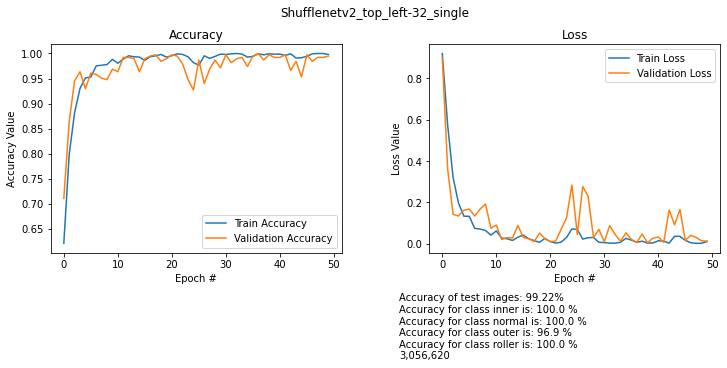

images/top_left-32_single/train


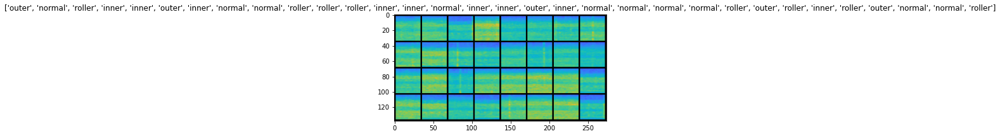

1.5679748058319092
0.7254371047019958
0.24684372544288635
0.22523009777069092
0.15712331235408783
0.4057193994522095
0.1392306387424469
0.05537903308868408
0.28887224197387695
0.060587652027606964
0.09694670140743256
0.08152532577514648
0.07887881994247437
0.053222090005874634
0.15642797946929932
0.04426020383834839
0.05491319298744202
0.03000268153846264
0.022045079618692398
0.024702705442905426
0.11616219580173492
0.028664274141192436
0.010250195860862732
0.029919540509581566
0.06811565160751343
0.044984959065914154
0.014361999928951263
0.026820119470357895
0.03681717813014984
0.02048323303461075
0.024792145937681198
0.04081333428621292
0.03188512474298477
0.0693768858909607
0.025438513606786728
0.02899027243256569
0.00863073579967022
0.01562579534947872
0.018782839179039
0.006463253404945135
0.004634305369108915
0.008999591693282127
0.008183732628822327
0.05251893401145935
0.0053325919434428215
0.10331173241138458
0.04206857085227966
0.014192349277436733
0.01655958965420723
0.021916

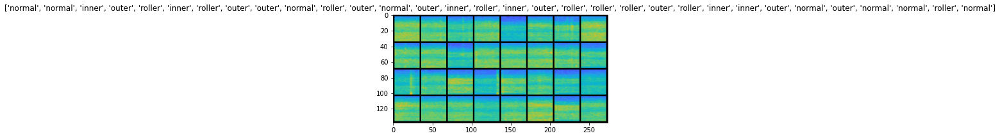

0.9948751926422119
0.2925172448158264
0.21144907176494598
0.14222446084022522
0.13075055181980133
0.06137153133749962
0.10957947373390198
0.1159832626581192
0.023760169744491577
0.10038141906261444
0.026808207854628563
0.1357850432395935
0.043115437030792236
0.04040597751736641
0.12286638468503952
0.03196314722299576
0.02705404721200466
0.26296746730804443
0.03776351362466812
0.016611160710453987
0.04644133150577545
0.023876622319221497
0.009775386191904545
0.04380171000957489
0.03919191285967827
0.012594237923622131
0.08505253493785858
0.03559286892414093
0.028447387740015984
0.012303696945309639
0.03919845074415207
0.05623503774404526
0.04516228288412094
0.030241666361689568
0.02574123814702034
0.01795126125216484
0.06191360950469971
0.12097227573394775
0.01987997628748417
0.015623463317751884
0.011859538964927197
0.01766444370150566
0.022599931806325912
0.012080084532499313
0.022702520713210106
0.02958553098142147
0.022854706272482872
0.020271459594368935
0.015101414173841476
0.0211

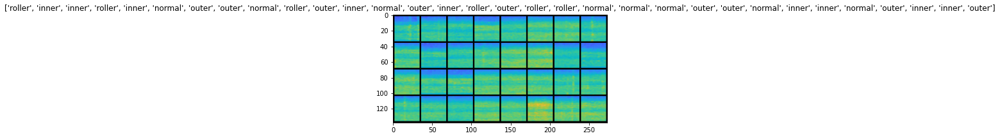

0.5708147883415222
0.18784759938716888
0.13038617372512817
0.21137982606887817
0.12644535303115845
0.23166106641292572
0.052455123513936996
0.009274175390601158
0.18747416138648987
0.052948784083127975
0.06998734176158905
0.020872890949249268
0.033426977694034576
0.05390193313360214
0.38631099462509155
0.07536419481039047
0.017180347815155983
0.019539758563041687
0.004989903420209885
0.010607059113681316
0.013039524666965008
0.017729543149471283
0.01561526209115982
0.012569371610879898
0.1802481859922409
0.055577244609594345
0.054323017597198486
0.026852911338210106
0.0063352202996611595
0.007784484885632992
0.04925668239593506
0.020279092714190483
0.010386642068624496
0.01044781506061554
0.0073479218408465385
0.009361867792904377
0.012159494683146477
0.011193888261914253
0.0011243456974625587
0.0075319199822843075
0.007963784970343113
0.007339076604694128
0.006309229414910078
0.0066712843254208565
0.005782441236078739
0.0038665523752570152
0.01109190285205841
0.010146386921405792
0.05

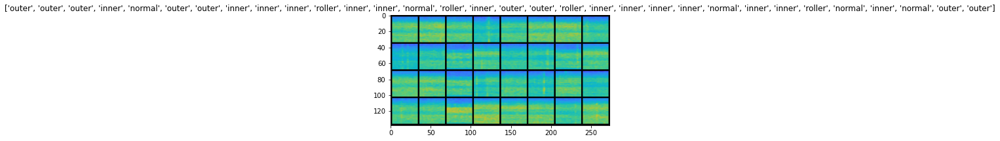

1.2996821403503418
0.26155462861061096
0.49217450618743896
0.2768888473510742
0.09905531257390976
0.1118704229593277
0.045484744012355804
0.2656885087490082
0.14827585220336914
0.030862409621477127
0.07230712473392487
0.02872881107032299
0.021484818309545517
0.05687802657485008
0.023789193481206894
0.050495754927396774
0.011354517191648483
0.019794795662164688
0.01060408540070057
0.016477664932608604
0.06317733228206635
0.026350369676947594
0.04341612011194229
0.030568890273571014
0.0512750968337059
0.023347578942775726
0.021775562316179276
0.009983680211007595
0.0470174178481102
0.014649499207735062
0.012055790051817894
0.0033747367560863495
0.004029642324894667
0.0048112221993505955
0.0750097781419754
0.015911318361759186
0.01840139552950859
0.02179710939526558
0.038496457040309906
0.04986710846424103
0.017901262268424034
0.05554601550102234
0.009729345329105854
0.016631871461868286
0.0061111911199986935
0.024587661027908325
0.01960824988782406
0.01680898666381836
0.01802619174122810

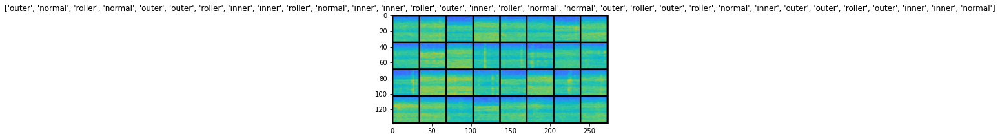

0.5501064658164978
0.3894669711589813
0.2797967195510864
0.9531887769699097
0.11736287921667099
0.13151668012142181
0.04796544834971428
0.0558067187666893
0.08501556515693665
0.07622876763343811
0.02450866624712944
0.031013919040560722
0.06022298336029053
0.03417963534593582
0.02171393483877182
0.29983121156692505
0.06895313411951065
0.10596907138824463
0.028567783534526825
0.04333937168121338
0.02709162048995495
0.10283251851797104
0.007286558859050274
0.023217886686325073
0.012509039603173733
0.014553255401551723
0.010310240089893341
0.001489782938733697
0.01362200640141964
0.005213765427470207
0.004386587999761105
0.004745942540466785
0.004870029166340828
0.11758185923099518
0.0010477344039827585
0.0010208089370280504
0.0038548456504940987
0.06703329086303711
0.028811749070882797
0.015074583701789379
0.009893779642879963
0.020792271941900253
0.01685892790555954
0.002088585402816534
0.010805918835103512
0.010697545483708382
0.013450467959046364
0.03528502583503723
0.01555101200938224

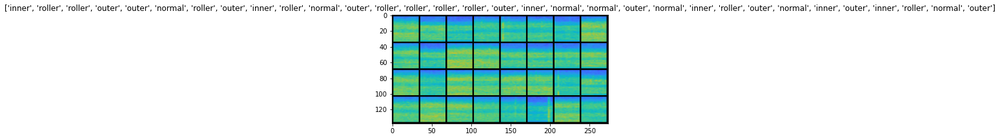

1.9075864553451538
0.30133360624313354
0.5946989059448242
0.14366695284843445
0.16198602318763733
0.15004119277000427
0.1679927557706833
0.02825448475778103
0.09704660624265671
0.08269798755645752
0.5285018086433411
0.03688901290297508
0.031381621956825256
0.046231549233198166
0.04501882195472717
0.07907784730195999
0.04026354104280472
0.26460573077201843
0.04756596311926842
0.38628074526786804
0.033300258219242096
0.04295524209737778
0.033616818487644196
0.04172429069876671
0.030741287395358086
0.0238815750926733
0.028591416776180267
0.015319054946303368
0.0308067724108696
0.06713931262493134
0.06048446521162987
0.05988506227731705
0.0366935208439827
0.013513198122382164
0.026282139122486115
0.034341976046562195
0.02795722708106041
0.045476943254470825
0.1880781054496765
0.01695007085800171
0.03021857514977455
0.03372172638773918
0.07621698081493378
0.07554759085178375
0.05276995897293091
0.051788248121738434
0.026537157595157623
0.0375746414065361
0.010754013434052467
0.1134187430143

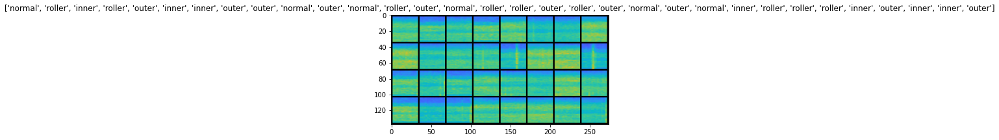

0.8294812440872192
0.24488568305969238
0.2982049584388733
0.5514927506446838
0.6897878050804138
0.01003367267549038
0.1976412832736969
0.021865077316761017
0.11398005485534668
0.027314919978380203
0.013092003762722015
0.012906515970826149
0.030925698578357697
0.6026782393455505
0.023084968328475952
0.02908521145582199
0.12116795033216476
0.006807535886764526
0.012340320274233818
0.017953235656023026
0.052005164325237274
0.18725529313087463
0.3229526877403259
0.185577392578125
0.024820074439048767
0.003237528493627906
0.012909311801195145
0.005679173395037651
0.0018259517382830381
0.001397911342792213
0.005660405382514
0.01975172944366932
0.0009199235355481505
0.0032337582670152187
0.0028784924652427435
0.0011731232516467571
0.0013871979899704456
0.0027193878777325153
0.002377158962190151
0.0007115857442840934
0.0007884695660322905
0.0010555823100730777
0.0007846557418815792
0.0006094216369092464
0.0012155562872067094
0.0005726738600060344
0.0013001211918890476
0.004025648348033428
0.00

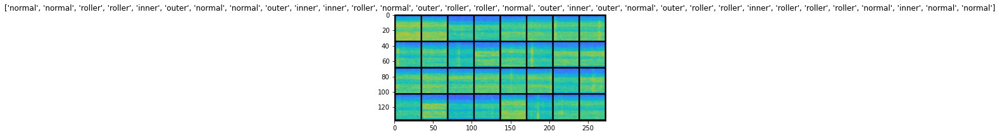

0.6253154873847961
0.2003861665725708
0.1479925811290741
0.1934567093849182
0.0677439421415329
0.174638569355011
0.06843841075897217
0.0661122053861618
0.04233936592936516
0.056823041290044785
0.013883604668080807
0.25938713550567627
0.016689425334334373
0.003524037543684244
0.10834633558988571
0.02153083309531212
0.009898067452013493
0.1044720858335495
0.1478751301765442
0.021507656201720238
0.01656382903456688
0.008744687773287296
0.015658792108297348
0.0015511696692556143
0.004600883461534977
0.008373025804758072
0.0115912314504385
0.010955396108329296
0.008828900754451752
0.003985878080129623
0.0029987352900207043
0.004214086104184389
0.0036033103242516518
0.004216576926410198
0.0033639827743172646
0.0021385636646300554
0.09148665517568588
0.008126689121127129
0.0013714538654312491
0.0698840469121933
0.17973385751247406
0.0007648137398064137
0.0011529680341482162
0.0019840430468320847
0.0011045376304537058
0.001672149170190096
0.00043858360731974244
0.000535359256900847
0.053889557

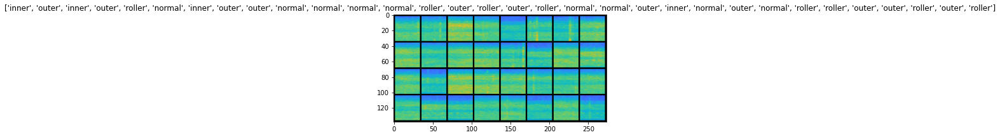

0.9004114866256714
0.1482536643743515
0.7059674263000488
0.23982864618301392
0.4417676329612732
0.158744677901268
0.08355801552534103
0.12119265645742416
0.24816149473190308
0.019727125763893127
0.009481715969741344
0.04016575217247009
0.018517928197979927
0.10812301933765411
0.011881249025464058
0.03279157727956772
0.02284349501132965
0.010773140005767345
0.08017660677433014
0.02061857283115387
0.11356215178966522
0.02094411663711071
0.05759310722351074
0.1837661862373352
0.11732432246208191
0.024456201121211052
0.06248174607753754
0.019163383170962334
0.021207725629210472
0.04306365177035332
0.019289089366793633
0.01986674778163433
0.021376600489020348
0.019830865785479546
0.020259371027350426
0.01959090121090412
0.014452861621975899
0.020993143320083618
0.02777724340558052
0.012849142774939537
0.038255687803030014
0.03961876779794693
0.023051857948303223
0.02477002888917923
0.02920866385102272
0.021945973858237267
0.02435550093650818
0.016904309391975403
0.031906213611364365
0.03676

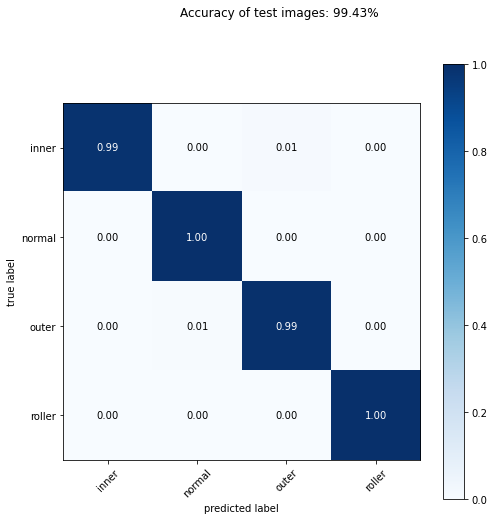

top_left-64_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.012 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.001 GMac, 6.036% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.001 GMac, 5.433% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.002 GMac, 18.555% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.001 GMac, 6.429% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.959% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), p

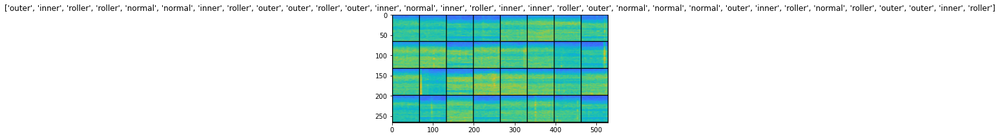

0.549513041973114
0.3289042115211487
0.022794120013713837
0.03730832785367966
0.006148564629256725
0.02779233455657959
0.0493948869407177
0.009527396410703659
0.0029647815972566605
0.010302741080522537
0.0004234715597704053
0.011383440345525742
0.0007812066469341516
0.005374880041927099
0.0004934877506457269
0.0002571083605289459
0.03637796267867088
0.025733133777976036
0.017674792557954788
0.008968684822320938
0.008183971047401428
0.00806085579097271
0.012414228171110153
0.012740368954837322
0.00634654238820076
0.007702391594648361
0.005582884885370731
0.0032603570725768805
0.0021630036644637585
0.03421369567513466
0.011897570453584194
0.001053591724485159
0.0006443151505663991
0.0006617121398448944
0.0004188555176369846
0.0007716750260442495
0.000586438924074173
0.00031215482158586383
0.0007595743518322706
0.0008037152583710849
0.002132881199941039
0.002559670712798834
0.0015636960742995143
0.0016185336280614138
0.0022821943275630474
0.002252158708870411
0.003516298485919833
0.006895

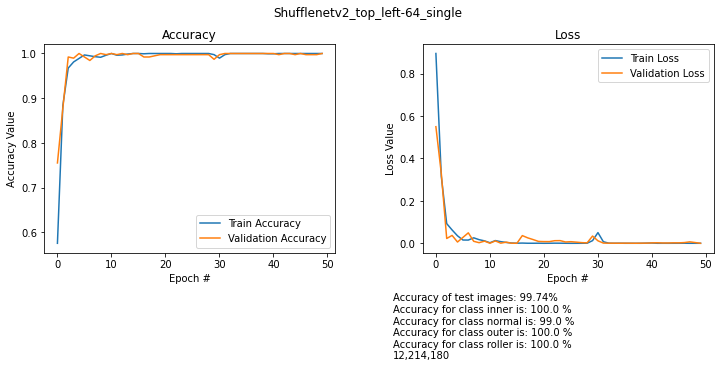

images/top_left-64_single/train


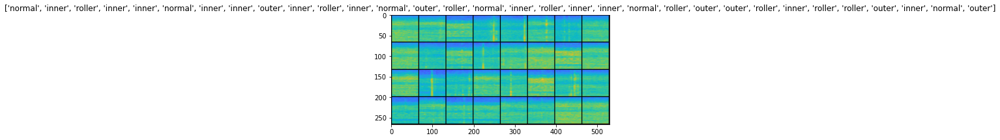

0.3458446264266968
0.2562101483345032
0.04330052435398102
0.03231213241815567
0.09068503230810165
0.010452481918036938
0.0202273391187191
0.005395569838583469
0.028102662414312363
0.003537306096404791
0.020406389608979225
0.004363266751170158
0.19617140293121338
0.00396155146881938
0.02498062700033188
0.04304095357656479
0.0025770380161702633
0.04180052503943443
0.004563871305435896
0.0005575146642513573
0.01473376527428627
0.011808764189481735
0.007948528043925762
0.006902950815856457
0.00737568736076355
0.018796734511852264
0.012067524716258049
0.009262774139642715
0.01803647354245186
0.0003773834905587137
0.0002700293844100088
0.00019889610121026635
0.00020478747319430113
0.00011621743760770187
8.787239494267851e-05
0.012160275131464005
0.04647630453109741
0.013911128044128418
0.005312948487699032
0.0022921967320144176
0.0021595503203570843
0.0040693809278309345
0.00588151765987277
0.0026450282894074917
0.0020615255925804377
0.015187530778348446
0.002706268336623907
0.00265807239338

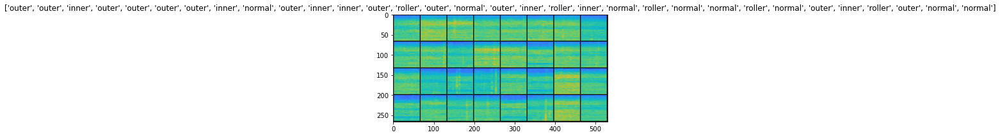

0.35624536871910095
0.2283458411693573
0.135054349899292
0.07564021646976471
0.03976945951581001
0.012832838110625744
0.037348318845033646
0.11266472190618515
0.05534438416361809
0.034449636936187744
0.027690259739756584
0.04642092436552048
0.06612873077392578
0.03446253389120102
0.020552026107907295
0.015164826065301895
0.05748090147972107
0.013895021751523018
0.018411628901958466
0.013208849355578423
0.012760156765580177
0.022379539906978607
0.01946483738720417
0.07454810291528702
0.007770301308482885
0.023475244641304016
0.005270510911941528
0.0038841625209897757
0.015511807054281235
0.009432589635252953
0.004496533423662186
0.001696538063697517
0.0030218912288546562
0.0009863043669611216
0.05698821693658829
0.006655046250671148
0.008123084902763367
0.008637577295303345
0.010951578617095947
0.010339789092540741
0.009016708470880985
0.007806731387972832
0.0048676454462111
0.006110092159360647
0.005066844634711742
0.004173357971012592
0.0035491473972797394
0.006424376275390387
0.00769

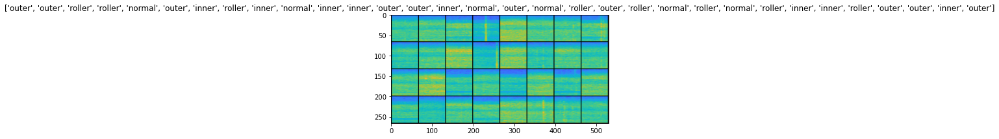

0.6600700616836548
0.4640929400920868
0.2534636855125427
0.08052148669958115
0.01684551313519478
0.006195755675435066
0.011783632449805737
0.001284824451431632
0.026862269267439842
0.0019071869319304824
0.07543602585792542
0.010128233581781387
0.008870087563991547
0.05837218463420868
0.010304286144673824
0.008703548461198807
0.020056454464793205
0.02204056829214096
0.005349248647689819
0.0006258220528252423
0.0004308476054575294
0.0003803792060352862
0.0003594244481064379
0.12399332970380783
0.00021594358258880675
0.00026173164951615036
7.491181895602494e-05
8.858932415023446e-05
0.00014480174286291003
0.0013225860893726349
0.00016204066923819482
0.00016764955944381654
0.0006000922876410186
0.00034793556551449
0.0042239828035235405
0.0009657430346123874
0.000817700638435781
0.0010423315688967705
0.0002420608070679009
8.969131158664823e-05
4.412914495333098e-05
0.0015145775396376848
0.0002800870279315859
0.00024501909501850605
0.013631961308419704
0.001975236926227808
0.0115368925034999

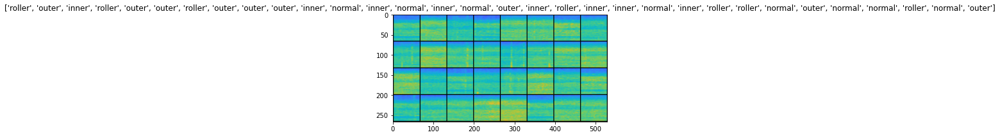

0.9961037039756775
0.3748008906841278
0.0752975195646286
0.183238685131073
0.035415709018707275
0.015944264829158783
0.020548909902572632
0.013068835251033306
0.058447904884815216
0.01825595833361149
0.0325997918844223
0.021011922508478165
0.01206945814192295
0.010431206785142422
0.008563420735299587
0.0007905689999461174
0.0018916665576398373
0.0016934082377701998
0.000723539968021214
0.003395665204152465
0.0005911383777856827
0.002585337031632662
0.002727796323597431
0.0034863492473959923
0.002761119743809104
0.047814615070819855
0.011389213614165783
0.010368997231125832
0.027003850787878036
0.011843709275126457
0.01210776623338461
0.011958777904510498
0.013597636483609676
0.002369076944887638
0.0030483193695545197
0.0030315937474370003
0.001270757638849318
0.0013728460762649775
0.0019053424475714564
0.006307306699454784
0.005544583313167095
0.0075773512944579124
0.004323177505284548
0.008271199651062489
0.021209044381976128
0.007136582396924496
0.013958938419818878
0.015515226870775

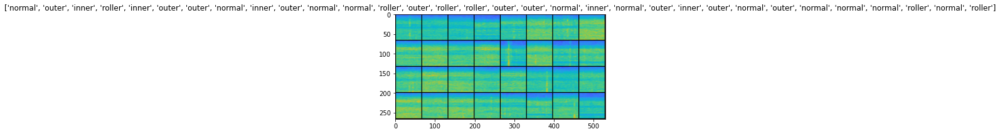

0.6285765171051025
0.1490335762500763
0.10450471937656403
0.008278618566691875
0.04781007766723633
0.026464875787496567
0.004366047214716673
0.0014746272936463356
0.002618737518787384
0.004289695993065834
0.009995007887482643
0.025783542543649673
0.009377563372254372
0.005057092290371656
0.04322322458028793
0.005496682599186897
0.013872652314603329
0.0072862147353589535
0.004976789932698011
0.0002544436138123274
0.00010159317025681958
0.0005792055744677782
0.000324632361298427
8.754368172958493e-05
0.00014192274829838425
0.00013590161688625813
0.00011670710955513641
0.00010457598546054214
0.00018833337526302785
0.004891844466328621
0.007258949335664511
0.0012234654277563095
0.0026116962544620037
0.0006049090879969299
0.00032850768184289336
0.0005633225664496422
0.0008661324973218143
0.009671828709542751
0.007953774183988571
0.0034698934759944677
0.0003102398186456412
0.0024054902605712414
8.798336784821004e-05
0.00019704339501913637
0.00013362194295041263
0.0006495504640042782
0.000908

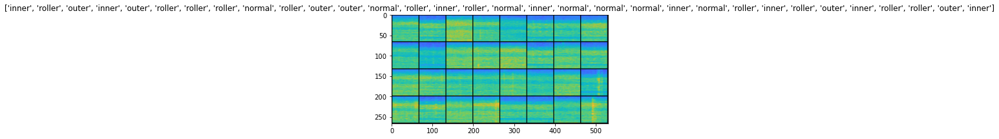

0.3877793252468109
0.21485352516174316
0.017395999282598495
0.09977557510137558
0.10377415269613266
0.01250537857413292
0.009054373949766159
0.0026841654907912016
0.41032883524894714
0.004291994962841272
0.0014680740423500538
0.2192331999540329
0.007064582780003548
0.04297352582216263
0.05383727699518204
0.0010798412840813398
0.0024532130919396877
0.08584403991699219
0.00849238783121109
0.01556168869137764
0.00941470731049776
0.0045829759910702705
0.005370303522795439
0.0032086134888231754
0.008966710418462753
0.014920230023562908
0.004387594759464264
0.004322904162108898
0.0024148854427039623
0.0027952250093221664
0.05370209738612175
0.007855905219912529
0.004850517958402634
0.02157052420079708
0.01655404269695282
0.0012189040426164865
0.0024288082495331764
0.007543947547674179
0.003941369242966175
0.0010997739154845476
0.0012226791586726904
0.002790350466966629
0.0014979937113821507
0.002313431352376938
0.0020750132389366627
0.004072042182087898
0.003299238160252571
0.002541668247431

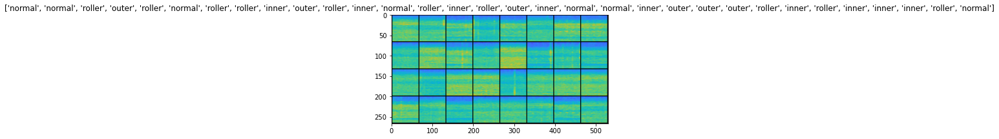

0.6130154132843018
0.11631682515144348
0.06560822576284409
0.01472834125161171
0.01718255504965782
0.06306616216897964
0.028448550030589104
0.019008392468094826
0.039726078510284424
0.032137785106897354
0.039688702672719955
0.011197635903954506
0.007661338895559311
0.0033839140087366104
0.03917164355516434
0.0013753324747085571
0.0007980932714417577
0.0017798620974645019
0.01188337616622448
0.0036979448050260544
0.004691614303737879
0.0057703182101249695
0.026990149170160294
0.003873037174344063
0.0007927107508294284
0.004723063204437494
0.002068306552246213
0.000887433416210115
0.000693305570166558
0.0003424302558414638
0.000886846799403429
0.0003224538522772491
0.0003968611708842218
0.0002560240391176194
0.0003503011248540133
0.0003060804447159171
6.754009518772364e-05
0.015306174755096436
0.002984869061037898
0.0011504520662128925
0.0008611022494733334
0.0014637492131441832
0.0004472544533200562
0.0026537026278674603
0.001119576278142631
0.009057760238647461
0.0002999504213221371
0.

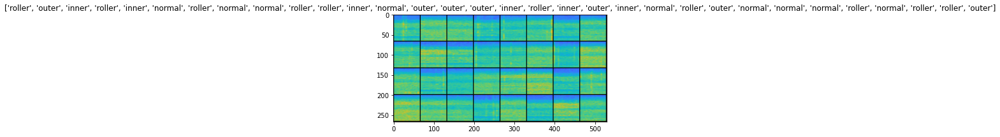

0.9768073558807373
0.13353824615478516
0.1385083794593811
0.017289191484451294
0.15199485421180725
0.23746269941329956
0.02465728670358658
0.004646684974431992
0.005086231976747513
0.009216131642460823
0.0068770418874919415
0.059942252933979034
0.12097596377134323
0.021624399349093437
0.018560335040092468
0.019073063507676125
0.0008127157925628126
0.007368338294327259
0.00602028239518404
0.005137613043189049
0.007343245204538107
0.004724573809653521
0.00123958894982934
0.008329705335199833
0.004140183329582214
0.0037717276718467474
0.0047634560614824295
0.0036711785942316055
0.018167346715927124
0.026831965893507004
0.0056805736385285854
0.012486618012189865
0.008331782184541225
0.0025310246273875237
0.01551197748631239
0.009451149962842464
0.00834213849157095
0.007355484180152416
0.005166707560420036
0.005908950697630644
0.009877244010567665
0.0058399373665452
0.0032117795199155807
0.007215659134089947
0.003561647143214941
0.0034071418922394514
0.0028817150741815567
0.0013328248169273

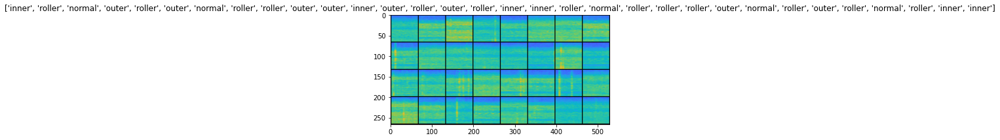

0.8138461112976074
0.25110113620758057
0.12715402245521545
0.148622065782547
0.07645855098962784
0.0725434422492981
0.03754014894366264
0.006205236539244652
0.12359441816806793
0.007634616456925869
0.0008831905433908105
0.07098614424467087
0.008682037703692913
0.08243927359580994
0.002136022550985217
0.013572437688708305
0.009072374552488327
0.0012543166521936655
0.0011061035329475999
0.0005329520790837705
0.0004907029797323048
0.06251922994852066
0.013095749542117119
0.05753452330827713
0.016216792166233063
0.0070851044729352
0.019682379439473152
0.0013707008911296725
0.021662689745426178
0.0039671678096055984
0.0011084869038313627
0.009091918356716633
0.005624862387776375
0.0015793812926858664
0.0021090609952807426
0.0012636083411052823
0.0010902164503932
0.0011750238481909037
0.0014086603187024593
0.0009637020993977785
0.0011224267072975636
0.00252222316339612
0.001103864866308868
0.0007521701045334339
0.0011949101462960243
0.0009822205174714327
0.0015262411907315254
0.0013075814349

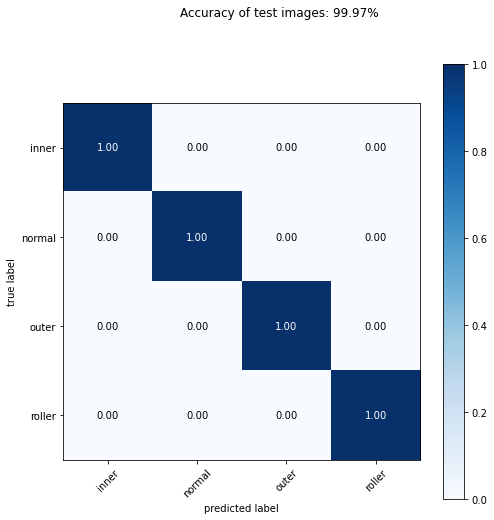

top_right-16_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.001 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 3.151% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 2.836% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.210% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.105% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.0 GMac, 9.685% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 3.356% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.500% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.059% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(

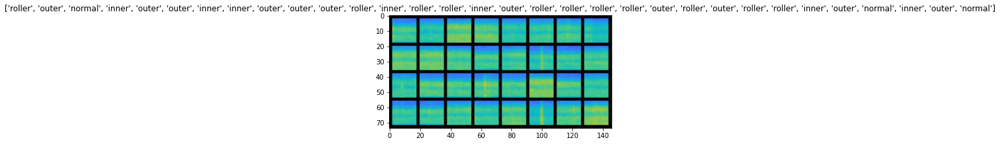

1.3854469060897827
0.8774125576019287
0.6356889009475708
0.3441426753997803
0.20419304072856903
0.1695178747177124
0.3802143335342407
0.12214754521846771
0.10511406511068344
0.1510741412639618
0.12906715273857117
0.10317334532737732
0.1568283885717392
0.2607768774032593
0.07623918354511261
0.07576505094766617
0.09150870889425278
0.08244402706623077
0.06774494796991348
0.08840665221214294
0.10841004550457001
0.045202337205410004
0.25015223026275635
0.0986192375421524
0.05934297665953636
0.039365191012620926
0.07547134160995483
0.051930420100688934
0.1097460389137268
0.07605055719614029
0.025541093200445175
0.06599657982587814
0.029489241540431976
0.0417652428150177
0.09676816314458847
0.042825859040021896
0.036318324506282806
0.02986871264874935
0.055206239223480225
0.029192738234996796
0.06054973602294922
0.033867403864860535
0.06800853461027145
0.05059688538312912
0.15767130255699158
0.11558742821216583
0.05976095423102379
0.04475882276892662
0.06137808784842491
0.07740700989961624
Fi

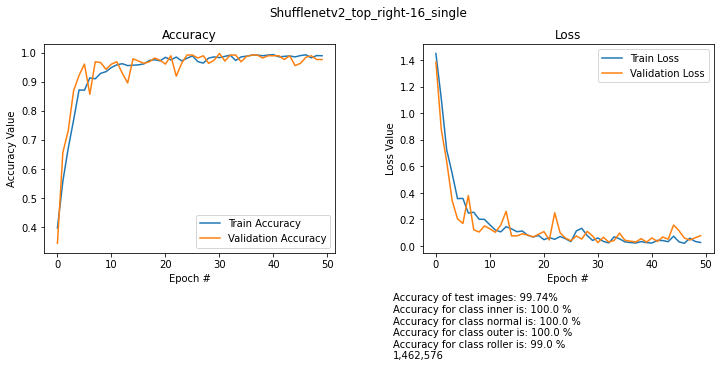

images/top_right-16_single/train


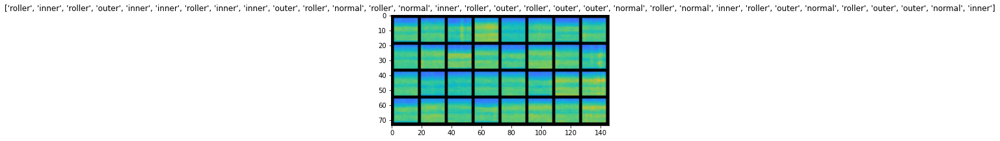

0.7851948738098145
0.367208331823349
0.36409005522727966
0.4371334910392761
0.5692658424377441
0.17104652523994446
0.08407469838857651
0.13321875035762787
0.2168581783771515
0.15207239985466003
0.22646453976631165
0.08214055001735687
0.09695489704608917
0.07468928396701813
0.2650500535964966
0.047974683344364166
0.05823933705687523
0.10793563723564148
0.06274954974651337
0.05816998332738876
0.04745621234178543
0.08636125922203064
0.06723736226558685
0.06520049273967743
0.10946027934551239
0.03954767435789108
0.15636493265628815
0.08054272830486298
0.05625462532043457
0.07069805264472961
0.07103951275348663
0.0549326092004776
0.04324760660529137
0.050907205790281296
0.049714475870132446
0.09500257670879364
0.07784669101238251
0.06170577555894852
0.09316854178905487
0.0844014510512352
0.1079779714345932
0.05953114479780197
0.07009083032608032
0.0753936842083931
0.1291690617799759
0.10111203789710999
0.0880679041147232
0.0607665479183197
0.04159533232450485
0.04959195479750633
Finish trai

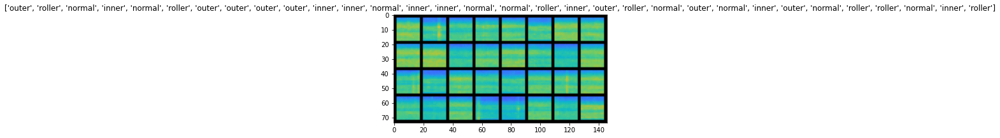

1.0143364667892456
1.120605707168579
0.37857431173324585
0.6964770555496216
0.39992278814315796
0.37055397033691406
0.3023756444454193
0.33531248569488525
0.15925678610801697
0.0844876766204834
0.42497968673706055
0.07742132246494293
0.33107662200927734
0.15959413349628448
0.12253599613904953
0.06393738090991974
0.06558771431446075
0.04735870286822319
0.04661255329847336
0.1632409393787384
0.13525621592998505
0.07931811362504959
0.23470085859298706
0.10231130570173264
0.044543080031871796
0.02528587356209755
0.042147137224674225
0.10052946209907532
0.0439511239528656
0.12721732258796692
0.07972879707813263
0.06700269132852554
0.04421171173453331
0.06838204711675644
0.031064748764038086
0.040775977075099945
0.14444762468338013
0.02799522504210472
0.017765352502465248
0.024384742602705956
0.014930399134755135
0.016405794769525528
0.027374710887670517
0.042880892753601074
0.02811063639819622
0.07442138344049454
0.030584461987018585
0.01628243364393711
0.03526005893945694
0.025786001235246

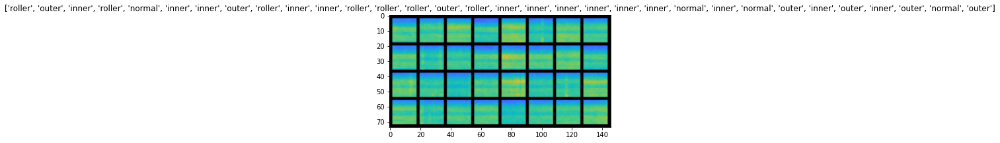

0.9483451247215271
0.42052924633026123
0.6250788569450378
0.5043147802352905
0.208511620759964
0.23284116387367249
0.3162267208099365
0.17032665014266968
0.1567719429731369
0.12583190202713013
0.17272108793258667
0.308419406414032
0.12092241644859314
0.1829274594783783
0.05952564626932144
0.363151490688324
0.35356050729751587
0.08192814141511917
0.38137373328208923
0.09544780850410461
0.377453088760376
0.19191275537014008
0.05563326179981232
0.10974996536970139
0.12414608895778656
0.06530500203371048
0.058238815516233444
0.22501039505004883
0.0986027643084526
0.12815286219120026
0.17042432725429535
0.21535049378871918
0.059909410774707794
0.10209038108587265
0.08366115391254425
0.09614098072052002
0.11221279948949814
0.4468724727630615
0.05248894914984703
0.17242515087127686
0.050508495420217514
0.03890833631157875
0.03688764199614525
0.09073140472173691
0.06592993438243866
0.062498629093170166
0.1812453269958496
0.05709788203239441
0.09345768392086029
0.1070680022239685
Finish trainin

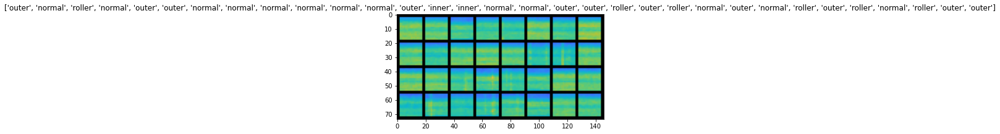

0.9524633884429932
0.5548197031021118
0.413531631231308
0.7013347148895264
0.45860302448272705
0.29228663444519043
0.31523019075393677
0.2663801312446594
0.21895325183868408
0.2443235218524933
0.18372362852096558
0.24699324369430542
0.13767212629318237
0.11160757392644882
0.1275320202112198
0.26904523372650146
0.20542114973068237
0.12281692028045654
0.09714804589748383
0.07559427618980408
0.04856158420443535
0.18848630785942078
0.09004950523376465
0.07123193889856339
0.06343576312065125
0.15653115510940552
0.09185504913330078
0.05099528655409813
0.023017361760139465
0.03709997609257698
0.08067131042480469
0.09969620406627655
0.24172434210777283
0.15934602916240692
0.044052254408597946
0.12724009156227112
0.040224552154541016
0.056218624114990234
0.06449170410633087
0.3937181830406189
0.02180984988808632
0.06014384329319
0.054660893976688385
0.022313689813017845
0.07946133613586426
0.0963258445262909
0.0072943065315485
0.03756522014737129
0.06505392491817474
0.05545298010110855
Finish t

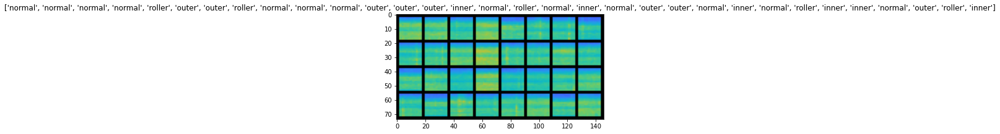

1.4759039878845215
0.4397504925727844
0.4141944646835327
0.6190483570098877
0.415202260017395
0.5511417388916016
0.2555861473083496
0.13243284821510315
0.1583438515663147
0.1378210484981537
0.11728312820196152
0.09387220442295074
0.07553859800100327
0.08913689851760864
0.08949732035398483
0.0761813223361969
0.052269306033849716
0.13948838412761688
0.08321738243103027
0.10312311351299286
0.09783356636762619
1.4642462730407715
0.05711952596902847
0.07236733287572861
0.10991722345352173
0.401710569858551
0.13700415194034576
0.06184425950050354
0.08622774481773376
0.03229925408959389
0.1567004919052124
0.07221119850873947
0.10913603752851486
0.07708702981472015
0.052886962890625
0.05325949192047119
0.026412207633256912
0.05223385617136955
0.018417421728372574
0.0722552090883255
0.09167467057704926
0.03104012832045555
0.039206065237522125
0.026456056162714958
0.036834511905908585
0.09264075756072998
0.0455910824239254
0.06543977558612823
0.05164416879415512
0.15347272157669067
Finish traini

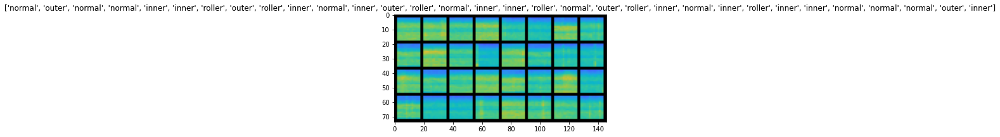

2.146907091140747
0.6123918294906616
0.43295788764953613
0.6106213331222534
0.9551535844802856
0.4604109227657318
0.21082130074501038
0.20910069346427917
0.11842876672744751
0.1735936850309372
0.11640322208404541
0.18294963240623474
0.16966894268989563
0.08261846005916595
0.19039665162563324
0.19454090297222137
0.14338043332099915
0.1061837300658226
0.1428915560245514
0.3803744912147522
0.09940361231565475
0.07915842533111572
0.1557944118976593
0.09841124713420868
0.0855352133512497
0.2993770241737366
0.1096520945429802
0.0639396607875824
0.10591631382703781
0.08674582093954086
0.10749917477369308
0.23570972681045532
0.0982726439833641
0.1056366115808487
0.05845985561609268
0.13617700338363647
0.053515851497650146
0.07162658125162125
0.051566675305366516
0.09998415410518646
0.14021846652030945
0.1313614845275879
0.18051046133041382
0.08654265105724335
0.07390469312667847
0.06307728588581085
0.07165104150772095
0.058739662170410156
0.06272463500499725
0.17903506755828857
Finish training

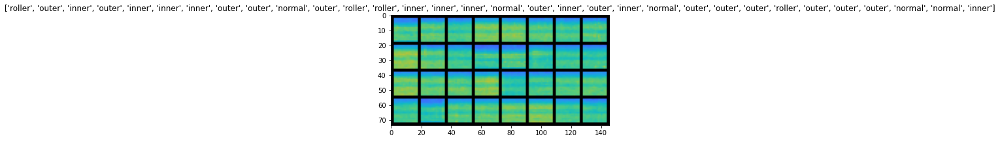

1.3947982788085938
0.804031491279602
0.6378041505813599
0.2784958779811859
0.3459627628326416
0.5148764848709106
0.1515737771987915
0.3043995499610901
0.5236371755599976
0.29280686378479004
0.09272827953100204
0.1339448094367981
0.20322108268737793
0.07218830287456512
0.36563798785209656
0.09342269599437714
0.1180066168308258
0.1503663957118988
0.15211781859397888
0.09708582609891891
0.16651268303394318
0.12003926932811737
0.12675659358501434
0.4186403155326843
0.35546964406967163
0.03181367740035057
0.11330689489841461
0.06889103353023529
0.10280190408229828
0.02134387008845806
0.17056187987327576
0.04485519975423813
0.14377622306346893
0.24362576007843018
0.036098990589380264
0.13218161463737488
0.032310836017131805
0.02601003460586071
0.009086434729397297
0.05039356276392937
0.04229430854320526
0.011281976476311684
0.22859713435173035
0.16721396148204803
0.0431692972779274
0.14893107116222382
0.1723012924194336
0.1461877077817917
0.08149024099111557
0.16559839248657227
Finish traini

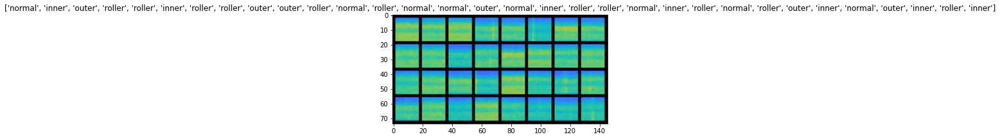

1.1254416704177856
0.4426145553588867
0.4375820755958557
0.4533616304397583
0.20984694361686707
0.2827635407447815
0.21411114931106567
0.29474878311157227
0.14239367842674255
0.09891992807388306
0.10215805470943451
0.1163012832403183
0.07294004410505295
0.2949053645133972
0.10343348979949951
0.1315566450357437
0.10247597098350525
0.06454195827245712
0.1187649816274643
0.06540589034557343
0.24904966354370117
0.09015493839979172
1.3155219554901123
0.18379710614681244
0.09141254425048828
0.12052210420370102
0.07971678674221039
0.043640971183776855
0.040165919810533524
0.06830976903438568
0.04018883407115936
0.05660576373338699
0.019496392458677292
0.08065526187419891
0.03781020641326904
0.045570969581604004
0.040917180478572845
0.02519972249865532
0.026738088577985764
0.03674665465950966
0.023819712921977043
0.11742543429136276
0.015539663843810558
0.012966793030500412
0.030318260192871094
0.033974189311265945
0.03901590779423714
0.07578946650028229
0.033844612538814545
0.0310438573360443

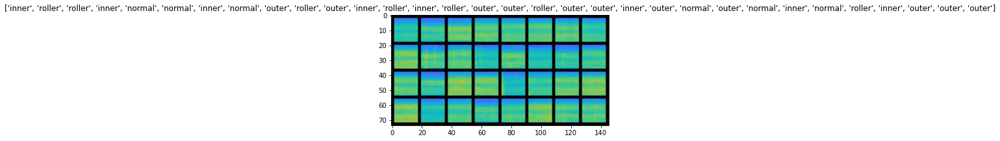

1.344527244567871
0.6175276041030884
0.47434473037719727
0.33864888548851013
0.394065797328949
0.4257696866989136
0.20003823935985565
0.28997477889060974
0.13098059594631195
0.3236144781112671
0.14999820291996002
0.09597460925579071
0.09106238931417465
0.18764641880989075
0.06698006391525269
0.11194517463445663
0.6423673629760742
0.0857364684343338
0.10800541937351227
0.1469114124774933
0.10141830891370773
0.6025710105895996
0.09711124747991562
0.059697091579437256
0.21702688932418823
0.052490126341581345
0.05841933190822601
0.06602431833744049
0.33197444677352905
0.05973326414823532
0.06492588669061661
0.12221848219633102
0.029542183503508568
0.057309865951538086
0.09554825723171234
0.06907733529806137
0.16515955328941345
0.03427917882800102
0.044211216270923615
0.030133908614516258
0.09349417686462402
0.0532764308154583
0.09960409998893738
0.11507364362478256
0.08300533145666122
0.026700934395194054
0.03890220448374748
0.020116521045565605
0.062027424573898315
0.027194242924451828
Fi

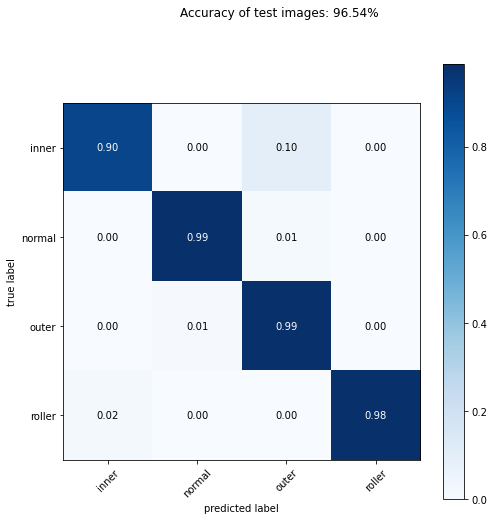

top_right-32_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.003 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.0 GMac, 6.030% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.0 GMac, 5.427% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.001 GMac, 18.537% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.0 GMac, 6.423% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.958% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), paddin

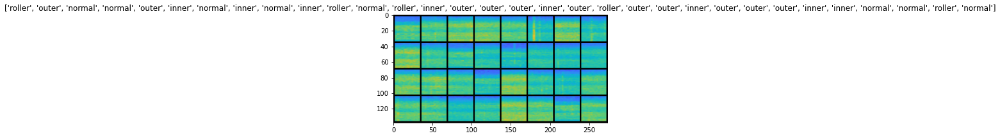

1.0588788986206055
0.16022714972496033
0.12178969383239746
0.22658178210258484
0.10374942421913147
0.14227813482284546
0.4469899535179138
0.0660804733633995
0.09618951380252838
0.45646438002586365
0.0427752286195755
0.06286577135324478
0.0323256179690361
0.21478605270385742
0.10638350248336792
0.12722879648208618
0.0913938507437706
0.0360448844730854
0.04225156828761101
0.030820723623037338
0.0324806347489357
0.03343544155359268
0.029742736369371414
0.026291636750102043
0.026806091889739037
0.029044732451438904
0.030817203223705292
0.028009194880723953
0.028521526604890823
0.02358364872634411
0.2641662657260895
0.06518878787755966
0.024197367951273918
0.036924395710229874
0.057044193148612976
0.019254200160503387
0.022489501163363457
0.02358216792345047
0.025080448016524315
0.027294596657156944
0.025920305401086807
0.024192415177822113
0.027332935482263565
0.035538867115974426
0.021687056869268417
0.028532972559332848
0.025220124050974846
0.026363950222730637
0.035925693809986115
0.025

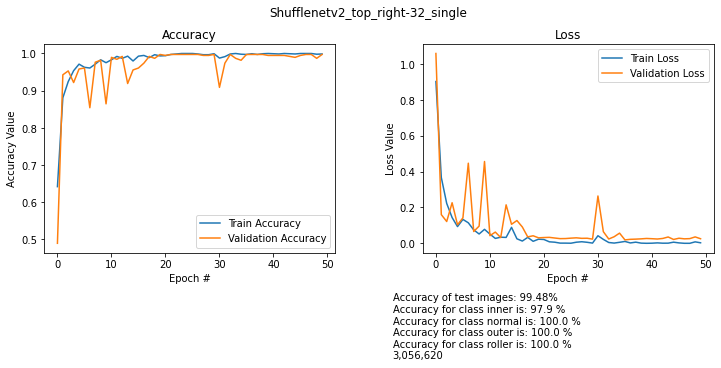

images/top_right-32_single/train


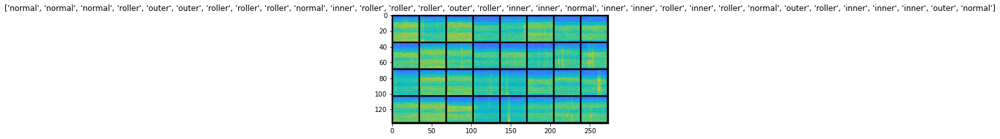

0.9610115885734558
0.18543946743011475
0.17134885489940643
0.178183913230896
0.06969133019447327
0.03642804175615311
0.15303759276866913
0.07312318682670593
0.6500823497772217
0.03302900120615959
0.08836080878973007
0.005772064905613661
0.03496181219816208
0.07839775830507278
0.017343444749712944
0.008271620608866215
0.0063024177215993404
0.03439236432313919
0.041040606796741486
0.10769818723201752
0.02868272364139557
0.007519143633544445
0.006360526196658611
0.007387715857475996
0.0007485774112865329
0.0007491916767321527
0.002369948197156191
0.2046297788619995
0.03510071337223053
0.05358335003256798
0.09440373629331589
0.017576884478330612
0.018460944294929504
0.008241359144449234
0.012146546505391598
0.020229924470186234
0.023634111508727074
0.030255591496825218
0.015150632709264755
0.04343968257308006
0.05480940639972687
0.01878388039767742
0.007404440548270941
0.011583621613681316
0.00789009127765894
0.011305104941129684
0.02143983170390129
0.03505916893482208
0.009064593352377415

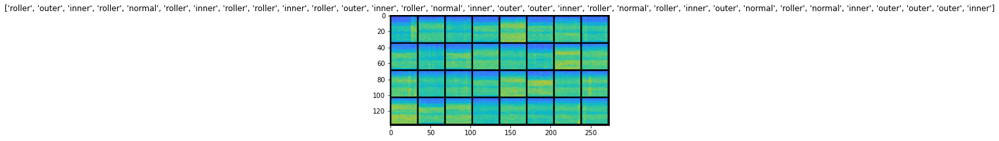

0.584730863571167
0.2367369383573532
0.3846323490142822
0.18511709570884705
0.12260877341032028
0.06498532742261887
0.039525531232357025
0.04415687546133995
0.22677557170391083
0.2634611129760742
0.19534502923488617
0.04872872680425644
0.0784716010093689
0.05749649554491043
0.13197095692157745
0.06913524866104126
0.02220882847905159
0.019608095288276672
0.3367271423339844
0.03652419522404671
0.037813201546669006
0.007931085303425789
0.04289504513144493
0.02994196116924286
0.008950707502663136
0.006100841797888279
0.009657956659793854
0.01826731115579605
0.3506673574447632
0.12134057283401489
0.08445420861244202
0.061523690819740295
0.02138938568532467
0.40804800391197205
0.020402975380420685
0.06010373681783676
0.028486019000411034
0.019861167296767235
0.017602141946554184
0.01614179089665413
0.014513375237584114
0.02201615646481514
0.08370866626501083
0.026066627353429794
0.02024366706609726
0.016693051904439926
0.01459096372127533
0.011226586997509003
0.012824833393096924
0.011763179

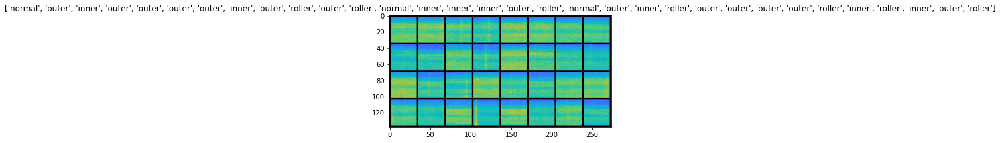

0.8629781007766724
0.4482569098472595
0.21450188755989075
0.17169144749641418
0.16522285342216492
0.1991211622953415
0.1354348361492157
0.0745585560798645
0.18191616237163544
0.09270232170820236
0.0371592678129673
0.1404533088207245
0.02388804778456688
0.050540488213300705
0.019890880212187767
0.08139489591121674
0.026197820901870728
0.05279885232448578
0.06809684634208679
0.027968695387244225
0.03492527827620506
0.030647899955511093
0.057312823832035065
0.01624956727027893
0.02201717346906662
0.032622482627630234
0.014237663708627224
0.013731523416936398
0.013738451525568962
0.012796889059245586
0.014312369748950005
0.019057827070355415
0.04335639625787735
0.04562655836343765
0.022686466574668884
0.024997424334287643
0.03298655152320862
0.03053402714431286
0.05147889256477356
0.5383488535881042
0.03295477479696274
0.0173310749232769
0.01192947756499052
0.011484618298709393
0.010551908984780312
0.014880560338497162
0.011414832435548306
0.010239683091640472
0.011033182963728905
0.016589

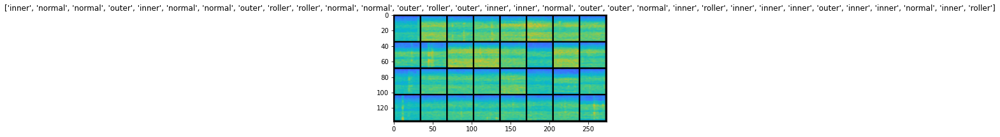

1.3910393714904785
0.4540008306503296
0.08943834155797958
0.16570378839969635
0.047454506158828735
0.07176122814416885
0.11628654599189758
0.07600729912519455
0.18306386470794678
0.04057344049215317
0.018967125564813614
0.046107929199934006
0.027184780687093735
0.02335396036505699
0.14173677563667297
0.14746393263339996
0.01677967607975006
0.024641593918204308
0.014239385724067688
0.049744561314582825
0.048364631831645966
0.016284937039017677
0.045527927577495575
0.016939405351877213
0.05708376690745354
0.026564737781882286
0.03016565553843975
0.025059930980205536
0.0089955385774374
0.009208766743540764
0.021218007430434227
0.012882420793175697
0.019585466012358665
0.019231688231229782
0.020230138674378395
0.1183217391371727
0.03626955673098564
0.019598303362727165
0.034800831228494644
0.018293088302016258
0.019034603610634804
0.08299510926008224
0.027292516082525253
0.0133345453068614
0.013146765530109406
0.012895534746348858
0.017453426495194435
0.05121111869812012
0.0191260296851396

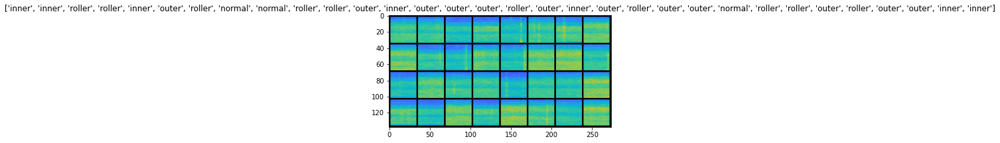

0.9326144456863403
1.0374879837036133
0.26582199335098267
0.12567417323589325
0.1649060696363449
0.07694867253303528
0.10909836739301682
0.07351019233465195
0.03712083399295807
0.08119726926088333
0.12212194502353668
0.08892513811588287
0.021121472120285034
0.18632040917873383
0.09063243865966797
0.06615056097507477
0.01728181168437004
0.026368407532572746
0.01493925042450428
0.05600603669881821
0.018194258213043213
0.02548331767320633
0.01594095304608345
0.020909860730171204
0.01667752116918564
0.017304325476288795
0.019062984734773636
0.01469700038433075
0.16291435062885284
0.020184515044093132
0.0453755222260952
0.017964642494916916
0.027826134115457535
0.023514194414019585
0.0221809521317482
0.03166943043470383
0.036112166941165924
0.023245101794600487
0.07002469152212143
0.02524239383637905
0.02388545125722885
0.013184595853090286
0.01274414174258709
0.010806585662066936
0.016888663172721863
0.01768222078680992
0.022384313866496086
0.012777796946465969
0.01245894841849804
0.012782

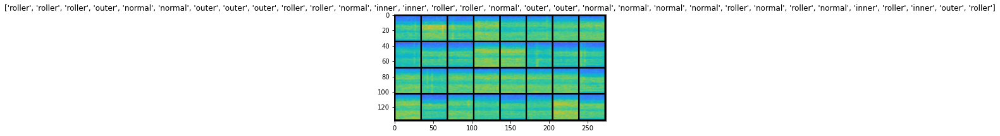

0.44159162044525146
0.29252907633781433
0.6850318312644958
0.0787079706788063
0.08283135294914246
0.8164252042770386
0.05812676250934601
0.04417774826288223
0.06123076379299164
0.027918977662920952
0.12981250882148743
0.028592020273208618
0.04905889555811882
0.03795991092920303
0.03482550382614136
0.43069884181022644
0.025005266070365906
0.01888836920261383
0.0240572951734066
0.016309773549437523
0.20447176694869995
0.022560467943549156
0.0218341201543808
0.010667363181710243
0.010324700735509396
0.010933443903923035
0.011600620113313198
0.029050398617982864
0.02724100463092327
0.018712742254137993
0.025600887835025787
0.013099676929414272
0.014240622520446777
0.008364301174879074
0.10149919241666794
0.02177952602505684
0.02962208166718483
0.02738294005393982
0.023541247472167015
0.026223737746477127
0.02213127166032791
0.02407660149037838
0.024709384888410568
0.009629039093852043
0.006848502438515425
0.02757325768470764
0.008954445831477642
0.013552333228290081
0.011921352706849575
0.

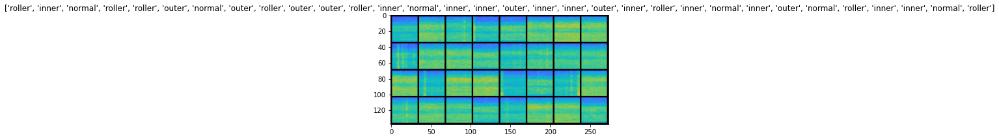

1.5512371063232422
0.3059784770011902
0.1437479555606842
0.09749118983745575
0.12761013209819794
0.09461807459592819
0.13217537105083466
0.08826695382595062
0.05599869787693024
0.0525825172662735
0.027943044900894165
0.059213124215602875
0.018617525696754456
0.06418126821517944
0.027545366436243057
0.03435298427939415
0.054522302001714706
0.01370316557586193
0.004033496603369713
0.09562869369983673
0.00794997625052929
0.015655774623155594
0.01825668476521969
0.04477512091398239
0.014351452700793743
0.02737979218363762
0.1004781723022461
0.072708860039711
0.011873191222548485
0.006118827499449253
0.005535693373531103
0.0012002205476164818
0.01542017050087452
0.02654467336833477
0.003028467297554016
0.00711066834628582
0.00436804722994566
0.0021504503674805164
0.001655945903621614
0.002610796829685569
0.0019891231786459684
0.0020742779597640038
0.002105336170643568
0.0018647247925400734
0.02058507315814495
0.0007627372397109866
0.0014066457515582442
0.0022510269191116095
0.00402592588216

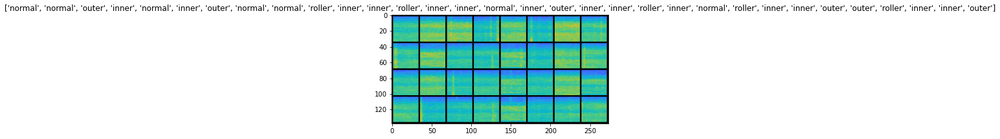

0.8193650245666504
0.28707027435302734
0.26051563024520874
0.36858412623405457
0.16377267241477966
0.033697545528411865
0.06601159274578094
0.03892391175031662
0.05833984538912773
0.035958051681518555
0.12085984647274017
0.11357125639915466
0.0643276795744896
0.02474047616124153
0.02707250975072384
0.028140507638454437
0.033939242362976074
0.013380542397499084
0.010913282632827759
0.00802132673561573
0.007686249446123838
0.04219494014978409
0.006898370571434498
0.017171256244182587
0.019626695662736893
0.01724674180150032
0.015239141881465912
0.01258864812552929
0.004337516147643328
0.003703830763697624
0.0033312139566987753
0.004109754227101803
0.03299028426408768
0.005428568925708532
0.00719749741256237
0.005653361789882183
0.006639046594500542
0.17052796483039856
0.01852661371231079
0.01236528530716896
0.012691354379057884
0.005647077225148678
0.006375779863446951
0.007803894579410553
0.006869434379041195
0.006486990489065647
0.005587149411439896
0.022747455164790154
0.0074486238881

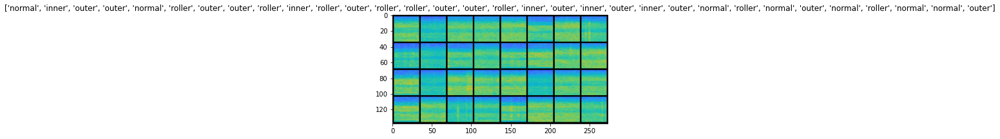

0.626714825630188
0.625887930393219
1.0615849494934082
0.46253126859664917
0.40911078453063965
0.3322395086288452
0.05697125941514969
0.041209254413843155
0.08327773213386536
0.062134336680173874
0.0359327495098114
0.06424298882484436
0.10312750935554504
0.03987862542271614
0.04023800417780876
0.013666610233485699
0.01623542234301567
0.02147012948989868
0.010218820534646511
0.05496594309806824
0.015827789902687073
0.007571675814688206
0.012077110819518566
0.03918173164129257
0.019460611045360565
0.01796507090330124
0.0109171187505126
0.018695306032896042
0.031076442450284958
0.015136349946260452
0.007836350239813328
0.013480626046657562
0.01451200246810913
0.010759132914245129
0.007601138204336166
0.008364615961909294
0.011601202189922333
0.00405456405133009
0.0908844992518425
0.03862873464822769
0.004081317223608494
0.0027103412430733442
0.031798530369997025
0.0058068037033081055
0.004053902346640825
0.0012127927038818598
0.002249812474474311
0.0016018537571653724
0.0024524109903723
0

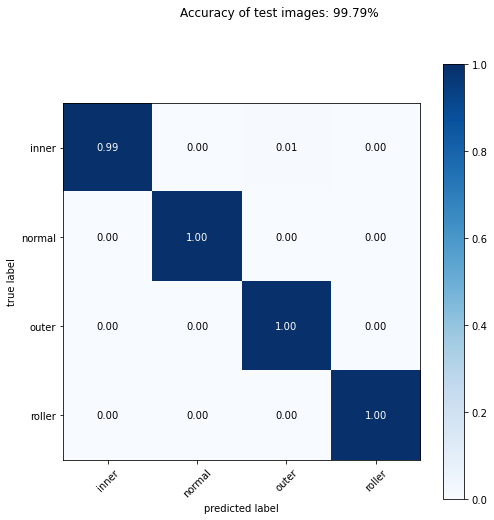

top_right-64_single
ShuffleNetV2(
  1.258 M, 100.000% Params, 0.012 GMac, 100.000% MACs, 
  (conv1): Sequential(
    0.001 M, 0.055% Params, 0.001 GMac, 6.036% MACs, 
    (0): Conv2d(0.001 M, 0.052% Params, 0.001 GMac, 5.433% MACs, 3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(0.0 M, 0.004% Params, 0.0 GMac, 0.402% MACs, 24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, inplace=True)
  )
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.0 GMac, 0.201% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    0.03 M, 2.401% Params, 0.002 GMac, 18.555% MACs, 
    (0): InvertedResidual(
      0.007 M, 0.588% Params, 0.001 GMac, 6.429% MACs, 
      (branch1): Sequential(
        0.002 M, 0.141% Params, 0.0 GMac, 0.959% MACs, 
        (0): Conv2d(0.0 M, 0.017% Params, 0.0 GMac, 0.113% MACs, 24, 24, kernel_size=(3, 3), stride=(2, 2), 

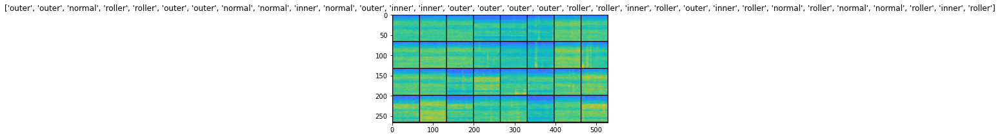

0.5596295595169067
0.09337111562490463
0.16291452944278717
0.012092954479157925
0.015565648674964905
0.019064050167798996
0.006493846885859966
0.003139439970254898
0.0011728196404874325
0.0006120032630860806
0.009328042156994343
0.12958304584026337
0.0025150810834020376
0.0038094702176749706
0.0022079278714954853
0.0007073224987834692
0.013095798902213573
0.010837184265255928
0.018975496292114258
0.0038593425415456295
0.008610712364315987
0.004828309174627066
0.0017250115051865578
0.003152720397338271
0.0022813542746007442
0.002686498686671257
0.002403494669124484
0.0027404739521443844
0.0029286653734743595
0.014871643856167793
0.05297841131687164
0.02025044709444046
0.00713516678661108
0.004358350299298763
0.0052570803090929985
0.0038742951583117247
0.0027782637625932693
0.0032315999269485474
0.00435036513954401
0.014466317370533943
0.0033713551238179207
0.009921068325638771
0.005178917199373245
0.007807588204741478
0.007487070746719837
0.008539728820323944
0.007297005038708448
0.0102

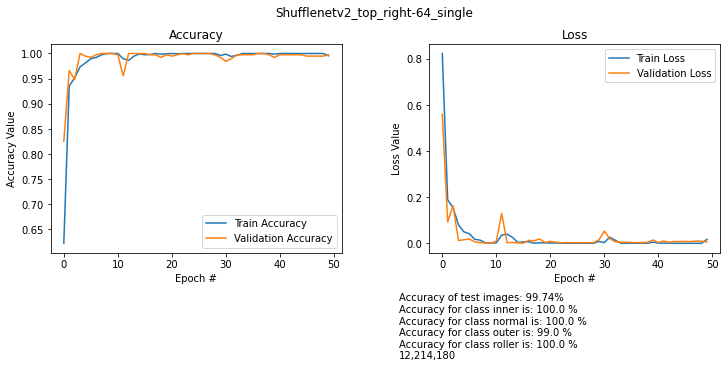

images/top_right-64_single/train


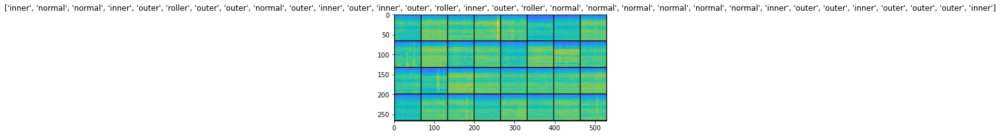

0.4628757834434509
0.12979604303836823
0.2407982349395752
0.07464497536420822
0.1862732172012329
0.07587984949350357
0.028822969645261765
0.04957614839076996
0.03501255065202713
0.042131613940000534
0.01394717674702406
0.008702795021235943
0.011054284870624542
0.030904201790690422
0.012812632136046886
0.000970306049566716
0.0017728509847074747
0.0007354727713391185
0.004994385875761509
0.003971341997385025
0.0017423037206754088
0.11489962041378021
0.019911719486117363
0.05332157015800476
0.0064312247559428215
0.0013598143123090267
0.003403194947168231
0.0013504354283213615
0.028825193643569946
0.001672104001045227
0.0014551169006153941
0.0032554585486650467
0.003454419318586588
0.0026655530091375113
0.0007781502790749073
0.00036646449007093906
0.0004680856945924461
0.0002720499178394675
0.00033589114900678396
0.00020699271408375353
0.00018071022350341082
0.016026487573981285
0.08466285467147827
0.002248914912343025
0.0024465438909828663
0.002015789272263646
0.0016553518362343311
0.0011

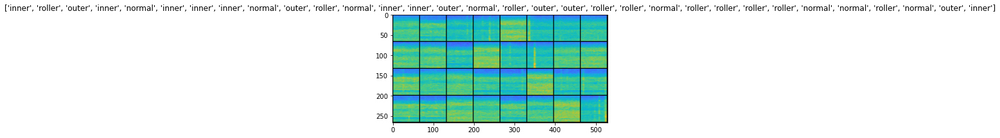

2.902536392211914
0.09443175792694092
0.115749791264534
0.03564140945672989
0.0684199407696724
0.005314757116138935
0.01753218285739422
0.008001821115612984
0.09718384593725204
0.026716716587543488
0.005688113160431385
0.007260975427925587
0.03597854822874069
0.004127452149987221
0.16213011741638184
0.0027726597618311644
0.12166330218315125
0.0009346210863441229
0.022424902766942978
0.0022463342174887657
0.0025070065166801214
0.0016223026905208826
0.0020276354625821114
0.0022576889023184776
0.0030416313093155622
0.0019103270024061203
0.0022267145104706287
0.0007483090739697218
0.0014875022461637855
0.0005331706488505006
0.0013815502170473337
0.0011766951065510511
0.002200070070102811
0.0017984755104407668
0.0020140698179602623
0.0011642002500593662
0.0008054542122408748
0.0011146990582346916
0.01155816949903965
0.004729707259684801
0.001960796769708395
0.0018681333167478442
0.002436783630400896
0.002493681386113167
0.0010268774349242449
0.0009382582502439618
0.0009269150323234499
0.002

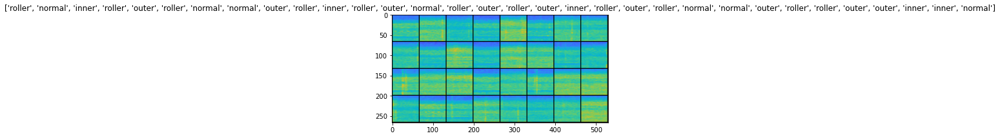

0.5028185844421387
0.1346355825662613
0.046241410076618195
0.034449782222509384
0.3248380720615387
0.027272498235106468
0.037404708564281464
0.012437870725989342
0.013138453476130962
0.06589341908693314
0.013177177868783474
0.015745505690574646
0.01104273647069931
0.005904175341129303
0.004245466087013483
0.005541488062590361
0.010505067184567451
0.01032149139791727
0.06271089613437653
0.010044307447969913
0.007379862945526838
0.010203644633293152
0.017222966998815536
0.00852037500590086
0.04633950814604759
0.028927620500326157
0.014970688149333
0.010932853445410728
0.011282529681921005
0.006004510447382927
0.020181875675916672
0.08708345890045166
0.06955259293317795
0.007725495845079422
0.006735123693943024
0.009114017710089684
0.005664973519742489
0.00796768069267273
0.019170694053173065
0.01628258265554905
0.02095804177224636
0.006431018467992544
0.0017168116755783558
0.005863061174750328
0.0018109151860699058
0.0021980064921081066
0.011304276995360851
0.0008368127746507525
0.001236

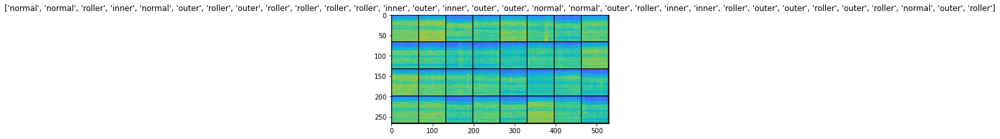

0.47999927401542664
0.07889940589666367
0.23218218982219696
0.003885498270392418
0.018382642418146133
0.004911963362246752
0.17530643939971924
0.004197406582534313
0.0016724405577406287
0.008350054733455181
0.0020316739100962877
0.0013255395460873842
0.009119691327214241
0.0005648762453347445
0.0009464583126828074
0.002016694052144885
0.0005714617436751723
0.00021251823636703193
0.00019951810827478766
0.0001706891634967178
0.004594697616994381
0.0007034501759335399
0.0010734933894127607
0.001131924451328814
0.0006636340403929353
0.0006688304129056633
0.0013703125296160579
0.0008404109976254404
0.0007067615515552461
0.0014247576473280787
0.0007799448794685304
0.0013418131275102496
0.0019136456539854407
0.0006258784560486674
0.0005256887525320053
0.0009362251730635762
0.0011397538473829627
0.000502036651596427
0.0003447300405241549
0.0013117315247654915
0.0010073634330183268
0.0004653100622817874
0.0007452542195096612
0.0010644129943102598
0.0003542628255672753
0.0026632798835635185
0.00

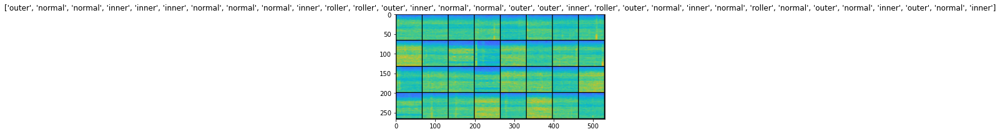

1.3531135320663452
0.05313238501548767
0.08232970535755157
0.0052244532853364944
0.01583949849009514
0.024134907871484756
0.01787583716213703
0.0037406478077173233
0.015401028096675873
0.0022812094539403915
0.00958326831459999
0.03140091523528099
0.025209616869688034
0.06474359333515167
0.0012670913711190224
0.0008044609567150474
0.000821392924990505
0.0008778836345300078
0.0006131874397397041
0.0006644759560003877
0.000753392931073904
0.0005663767224177718
0.0006479529547505081
0.0006492763059213758
0.0003346370067447424
0.0014265719801187515
0.0006974471034482121
0.0012255937326699495
0.0004021972417831421
0.00030587712535634637
0.0003434156533330679
0.00031285075237974524
0.00037524625076912344
0.00024361113901250064
0.0003648961428552866
0.00030018744291737676
0.0005551986396312714
0.000349774316418916
0.00043922950862906873
0.0002753541339188814
0.0004733577079605311
0.00015259083011187613
0.00024221200146712363
0.0001678039407124743
0.0001705312024569139
0.0001758954458637163
0.0

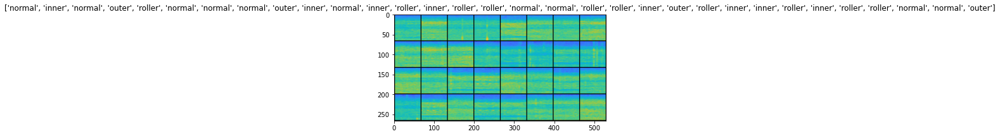

3.268651008605957
0.2514116168022156
0.25214123725891113
0.25793686509132385
0.04926943778991699
0.05538509041070938
0.003478505415841937
0.006667650770395994
0.01233554258942604
0.011432567611336708
0.04971892386674881
0.02105446718633175
0.011389653198421001
0.019649438560009003
0.01259708683937788
0.00809953548014164
0.011580100283026695
0.034547969698905945
0.033415041863918304
0.015573827549815178
0.014364467933773994
0.006989584304392338
0.008848167955875397
0.009636564180254936
0.0089190062135458
0.015111020766198635
0.009539464488625526
0.008711488917469978
0.006609394680708647
0.00936888437718153
0.013379596173763275
0.01697387546300888
0.0069506969302892685
0.019946029409766197
0.010014771483838558
0.012183151207864285
0.011051081120967865
0.012836884707212448
0.010583510622382164
0.01964716985821724
0.010011700913310051
0.010419556871056557
0.009656878188252449
0.011692702770233154
0.008812589570879936
0.010893779806792736
0.010575145483016968
0.00881062913686037
0.009514315

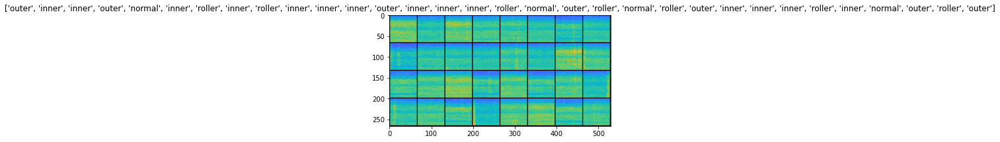

0.39575350284576416
0.07706550508737564
0.0587276816368103
0.036424681544303894
0.0045678699389100075
0.06449458003044128
0.07750649750232697
0.007723803631961346
0.013909238390624523
0.10493195056915283
0.03005136549472809
0.033007826656103134
0.06413295865058899
0.017576122656464577
0.0213772039860487
0.0036367790307849646
0.0108621371909976
0.016653213649988174
0.0036905999295413494
0.013201492838561535
0.00829748809337616
0.003071403596550226
0.0044084833934903145
0.002644144929945469
0.007250300608575344
0.008208787068724632
0.0029663536697626114
0.003443480236455798
0.002560798544436693
0.013576742261648178
0.01304029580205679
0.010481573641300201
0.012313054874539375
0.006572688929736614
0.006576686166226864
0.008515333756804466
0.005672844126820564
0.005382203962653875
0.0036500354763120413
0.008508802391588688
0.006869045551866293
0.009014025330543518
0.008424706757068634
0.009479865431785583
0.006551840808242559
0.006195330526679754
0.00027538754511624575
0.000152814653120003

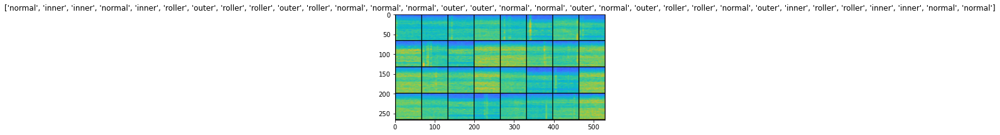

0.7264387011528015
0.19654753804206848
0.16582143306732178
0.05235934257507324
0.2111816704273224
0.0917343720793724
0.016474083065986633
0.382549524307251
0.01777379959821701
0.003935732878744602
0.006551780737936497
0.005615857429802418
0.00452747568488121
0.008885830640792847
0.460755318403244
0.06793059408664703
0.021861471235752106
0.0017285400535911322
0.0007972515886649489
0.005264434032142162
0.01412857323884964
0.035330794751644135
0.0176285058259964
0.0006253200117498636
0.003703565336763859
0.0039300089702010155
0.012520323507487774
0.005776270758360624
0.0013988830614835024
0.001617909292690456
0.0008152785594575107
0.0006800642004236579
0.000763304065912962
0.0005977362161502242
0.0008736228919588029
0.004193642642349005
0.0026821293868124485
0.011351246386766434
0.0020669770892709494
0.0029129681643098593
0.0013408506056293845
0.001147143542766571
0.002279440639540553
0.009137277491390705
0.014171425253152847
0.012788118794560432
0.0036217020824551582
0.000569753523450344

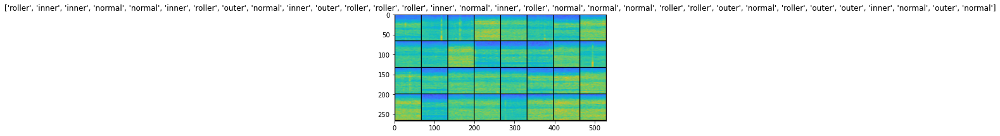

1.2156661748886108
0.2485383152961731
0.2828786373138428
0.036253660917282104
0.04712149128317833
0.04443804919719696
0.002777224173769355
0.011400136165320873
0.08861809968948364
0.008231810294091702
0.013210359029471874
0.006692942231893539
0.0043542878702282906
0.013716015964746475
0.009315107017755508
0.010760973207652569
0.05907798931002617
0.06510622799396515
0.09067191928625107
0.12284307926893234
0.009082790464162827
0.004519857466220856
0.004844376351684332
0.0027488735504448414
0.003726573195308447
0.003930277656763792
0.0017307753441855311
0.006946017500013113
0.0032030921429395676
0.005432811565697193
0.009172366932034492
0.00760757178068161
0.0039177159778773785
0.0038715831469744444
0.004211952909827232
0.015605591237545013
0.012203210964798927
0.012491637840867043
0.009667088277637959
0.004344722256064415
0.02166849933564663
0.004160965792834759


In [ ]:
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
from PIL import Image

LEARN_RATE = 0.1*BATCH_SIZE/255


models_name=['Shufflenetv2']

fold_names=os.listdir('images')

for f in fold_names:
    class_names = os.listdir('images/'+f+"/train")
    CLASSES = len(class_names)
    img = Image.open('images/'+f+'/train/normal/001__250.png')
    #input_shape=(224,224,3)
    input_shape=(img.size[0],img.size[1],3)
    print(f)

    for i in range(len(models_name)):
        total_matrix = torch.zeros(CLASSES, CLASSES)
        sig_img_val={x:np.zeros((img.size[0],img.size[1],3))
                      for x in class_names}

        sig_img_test={x:np.zeros((img.size[0],img.size[1],3))
                      for x in class_names}
        val_num = 0
        test_num = 0
        all_correct = 0
        all_total = 0

        for c in range(1,11):
            if 'Shufflenetv2' in models_name[i]:
                md = models.shufflenet_v2_x1_0(num_classes = CLASSES)

            if c==1:
                with torch.cuda.device(0):
                    macs, params = get_model_complexity_info(md, (3,img.size[0],img.size[1]), as_strings=False,print_per_layer_stat=True, verbose=True)
                print('{:<30}  {:,}'.format('Computational complexity: ', int(macs)))
                params = sum([np.prod(p.size()) for p in md.parameters()])
                print("Number of Parameters: %.5fM"%(params/1e6))
            learn_model(md,models_name[i],f,c)

        multiple_learn(models_name[i],f)
os.system('shutdown -s -f')